In [3]:
import jax.numpy as jnp
import jax.random as jr
import matplotlib.pyplot as plt
import optax as ox
from jax import jit
from jax.config import config
from jaxutils import Dataset
import jaxkern as jk
from jax.scipy.stats import norm
from jax.scipy.optimize import minimize
import gpjax as gpx

In [4]:
# Define the latent function to optimize
def LatentFunction(x, sample_key, kernel, kernel_parameters):
    
    prior = gpx.Prior(kernel=kernel)
    params = {'kernel': kernel_parameters,'mean_function': {}}
    prior_dist = prior(params)(x)
    
    return prior_dist.sample(seed=sample_key, sample_shape=(1,)).T

In [5]:
def ExpectedLoss(mean, std, alt, cost):
    '''
    This function calculates E[(g-V)^+]-c for given values g, c and a normal random variable V~N(mu, sigma^2)
    Input: mean and standard deviation the normal random variable V, alternative g, cost c
    '''
    
    z = (alt - mean) / std
    
    EI = (alt - mean) * jnp.where(std == 0, 0.0, jnp.nan_to_num(norm.cdf(z))) + std * jnp.nan_to_num(norm.pdf(z)) 
    
    exp_loss = EI - cost
    
    return exp_loss

In [6]:
# Define the acquisition function of expected improvement policy
def EI_acquisition(mean, std, best):  
    '''
    Combine the difference between the best observed value and the mean predicted value with the uncertainty (standard deviation) of the predictions
    Favor points where there is a high potential for improvement compared to the current best observed value
    '''
    
    size = jnp.size(mean)
        
    return ExpectedLoss(mean=mean, std=std, alt=best, cost=0)

In [7]:
# Define the acquisition function of Gittins policy
def Gittins_acquisition(mean, std, cost, bound):
    '''
    Gittins index minimizes the difference between the expected improvement and the query cost 
    Favor points where there is a high Gittins index compared to the current best observed value
    '''
    
    size = jnp.size(mean)
    
    l = bound[:,0]*jnp.ones(size)
    h = bound[:,1]*jnp.ones(size)
    m = (h+l)/2
    
    while jnp.nanmax(jnp.abs(ExpectedLoss(mean, std, m, cost))) >= eps:
        sgn_l = jnp.sign(ExpectedLoss(mean, std, l, cost))
        sgn_m = jnp.sign(ExpectedLoss(mean, std, m, cost))
        sgn_h = jnp.sign(ExpectedLoss(mean, std, h, cost))
        l = jnp.where(sgn_m == 0, m, l)
        h = jnp.where(sgn_m == 0, m, h)
        l = jnp.where(sgn_l == sgn_m, m, l)
        h = jnp.where(sgn_h == sgn_m, m, h)
        m = (h+l)/2

    return m

In [210]:
def UCB_acquisition(mean, std):
    
    return mean - 3*std

In [221]:
def BayesianOptimization(seed, policy, num_points, iterations, query_cost, kernel, kernel_parameters):
    # Generate a random key
    key = jr.PRNGKey(seed)

    # Define the grids
    x_plot = jnp.linspace(bounds[:, 0], bounds[:, 1], num_points).reshape(-1, 1)

    # Generate the latent function
    (k1,key) = jr.split(key)
    y_plot = LatentFunction(x=x_plot, sample_key=k1, kernel=kernel, kernel_parameters=kernel_parameters)
    
    global_minimum_value = jnp.min(y_plot)
    global_minimum_point = x_plot[jnp.argmin(y_plot)]
    
    print(f"Global minimum point: {global_minimum_point}")
    print(f"Global minimum value: {global_minimum_value}")
    print()

    # Initialize the best observed value, stopping time, and arrays for storing visited points and objective values
    i = 0
    X = jnp.array([]).reshape(-1,1)
    y = jnp.array([]).reshape(-1,1)
    visited = jnp.array([], dtype=int)
    best_observed_point = jnp.array([-8])
    best_observed_value = jnp.array([0])
    best_arr = best_observed_value
    obj_arr = best_observed_value - global_minimum_value
    stopping_time = iterations+1
    
    # Initialize the Gaussian process model
    prior = gpx.Prior(kernel=kernel)
    
    # Predict the mean and the standard deviation of the GP model on the plot range
    prior_params = {'kernel': kernel_parameters,'mean_function': {}}
    prior_dist = prior(prior_params)(x_plot)
    prior_mean = prior_dist.mean()
    prior_std = prior_dist.stddev()
    
    # Plot the GP model with confidence intervals and highlight the new and best observed points
    plt.figure()
    plt.plot(x_plot, y_plot, color="tab:grey", label='Latent function', alpha=0.6)
    plt.plot(x_plot, prior_mean, label='GP mean')
    plt.fill_between(x_plot.ravel(), prior_mean - 2*prior_std, prior_mean + 2*prior_std, alpha=0.2)
    plt.scatter(global_minimum_point, global_minimum_value, label='Global minimum', color='tab:red')
    plt.legend()
    plt.title(f"Iteration {i}")
    plt.show()
    
    # Select the next point to evaluate using the EI policy
    if policy == 'EI':
        expected_improvement = EI_acquisition(mean=prior_mean, std=prior_std, best=best_observed_value)
        
        # Selection rule: point with max expected improvement
        next_index = jnp.argmax(expected_improvement)
        next_point = x_plot[next_index]
        
        # Stopping rule: max expected improvement < query cost
        ei_max = jnp.max(expected_improvement)
        if ei_max < query_cost:
            stopping_time = jnp.minimum(stopping_time, i)

        # Plot the expected improvement
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, expected_improvement, label='Expected improvement')
        plt.scatter(next_point, jnp.max(expected_improvement), label='Next point', marker='x', color='tab:green')
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('Expected improvement')
        plt.show()
        
    # Select the next point to evaluate using the Gittins policy
    if policy == 'Gittins':
        gittins_index = Gittins_acquisition(mean=prior_mean, std=prior_std, cost=query_cost, bound=bounds)
        
        # Stopping rule: min gittins index > current best observed value
        gittins_min, next_index = jnp.min(gittins_index), jnp.argmin(gittins_index)
        if best_observed_value <= gittins_min:
            stopping_time = jnp.minimum(stopping_time, i)
        
        # Selection rule: unvisited point with min gittins index
        next_point = x_plot[next_index]
        visited = jnp.append(visited, next_index)
        
        # Plot the Gittins index
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, gittins_index, label='Gittins index')
        plt.scatter(next_point, gittins_min, label='Next point', marker='x', color='tab:green')
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('Gittins index')
        plt.show()
    
    # Select the next point to evaluate using the Surrogate policy
    if policy == 'Surrogate':
        # Compute Gittins indices
        gittins_index = Gittins_acquisition(mean=prior_mean, std=prior_std, cost=query_cost, bound=2*bounds)
        
        # Draw samples using Thompson sampling
        (k2,key) = jr.split(key)
        thompson_sample = prior_dist.sample(seed=k2, sample_shape=(num_samples,))
        
        # Compute current surrogate price for each sample
        current_surrogate_matrix = jnp.maximum(gittins_index, thompson_sample)
        current_surrogate_sample =  jnp.min(current_surrogate_matrix, axis=1)
        
        # Compute expected surrogate price after proposing each candidate point
        new_surrogate_matrix = jnp.minimum(current_surrogate_sample, thompson_sample.T).T
        new_surrogate_price = jnp.mean(new_surrogate_matrix, axis=0)
        
        # Selection rule: point with min new expected surrogate price
        next_index = jnp.nanargmin(new_surrogate_price)
        next_point = x_plot[next_index]
        next_value = y_plot[next_index]
        visited = jnp.append(visited, next_index)

#         print("current surrogate price:", jnp.mean(current_surrogate_sample))
#         print("optimal new expected surrogate price:", jnp.nanmin(new_surrogate_price))
#         print("minimum gittins index:", jnp.nanmin(gittins_index))

        # Stopping rule: query cost + min new expected surrogate price >= current best observed value
        if query_cost + jnp.nanmin(new_surrogate_price) >= best_observed_value:
            stopping_time = jnp.minimum(stopping_time, i)
        
        # Plot the sample drawn by Thompson Sampling and Gittins index
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, jnp.mean(thompson_sample,axis=0), label='Thompson sample', alpha=0.5)
        plt.scatter(next_point, next_value, label='Next point', marker='x', color='tab:red')
        plt.plot(x_plot, gittins_index, label='Gittins index', color='tab:green')
        plt.scatter(best_observed_point, best_observed_value, label='Current best', color='tab:orange', s=10)
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('Thompson sample & Gittins index')
        plt.show()
        
        # Plot the expected improvement
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, new_surrogate_price, label='Expected surrogate price', color='tab:blue')
        plt.errorbar(next_point, new_surrogate_price[next_index], yerr=1.96*jnp.std(new_surrogate_matrix[next_index])/jnp.sqrt(num_samples), color='tab:orange', alpha=0.5, fmt='.', capsize=2)
        plt.scatter(next_point, new_surrogate_price[next_index], label='Next point', marker='x', color='tab:green')
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('Expected surrogate price')
        plt.show()
        
        
    # Select the next point to evaluate using Thompson Sampling
    if policy == 'TS':
        (k2,key) = jr.split(key)
        thompson_sample = prior_dist.sample(seed=k2, sample_shape=(1,)).T
        
        next_index = jnp.argmin(thompson_sample)
        next_point = x_plot[next_index]
        
        # Plot the sample drawn by Thompson Sampling
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, thompson_sample, label='Thompson sample')
        plt.scatter(next_point, thompson_sample[next_index], label='Next point', marker='x', color='tab:red')
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('Thompson sample')
        plt.show()    
    
    # Select the next point to evaluate using Thompson Sampling with EI filter
    if policy == 'TS+EI':
        (k2,key) = jr.split(key)
        thompson_sample = prior_dist.sample(seed=k2, sample_shape=(1,)).T
        
        # Use expected improvement as a criteria to filter candidate points
        expected_improvement = EI_acquisition(mean=prior_mean, std=prior_std, best=best_observed_value)
        ei_max = jnp.nanmax(expected_improvement)
        
        if ei_max < query_cost:
            stopping_time = jnp.minimum(stopping_time, i)
            next_index = jnp.argmin(thompson_sample)
            
        else: 
            indices = jnp.where(expected_improvement>=query_cost)[0]
            next_index = indices[jnp.argmin(thompson_sample[indices])]
        
        next_point = x_plot[next_index]
        
        # Plot the sample drawn by Thompson Sampling
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, thompson_sample, label='Thompson sample')
        plt.scatter(next_point, thompson_sample[next_index], label='Next point', marker='x', color='tab:red')
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('Thompson sample')
        plt.show()
        
        # Plot the expected improvement
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, expected_improvement, label='Expected improvement')
        plt.scatter(next_point, expected_improvement[next_index], label='Next point', marker='x', color='tab:red')
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('Expected improvement')
        plt.show()
        
    # Select the next point to evaluate using the UCB policy
    if policy == 'UCB':
        ucb = UCB_acquisition(mean=prior_mean, std=prior_std)
        
        # Selection rule: point with min upper confidence bound
        next_index = jnp.argmin(ucb)
        
        # Stopping rule: max expected improvement < query cost
        expected_improvement = EI_acquisition(mean=prior_mean, std=prior_std, best=best_observed_value)
        ei_max = jnp.nanmax(expected_improvement)
        if ei_max < query_cost:
            stopping_time = jnp.minimum(stopping_time, i)
            
        next_point = x_plot[next_index]  
        
        # Plot the sample drawn by UCB
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, ucb, label='UCB')
        plt.scatter(next_point, ucb[next_index], label='Next point', marker='x', color='tab:red')
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('UCB')
        plt.show()
        
        # Plot the expected improvement
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, expected_improvement, label='Expected improvement')
        plt.scatter(next_point, expected_improvement[next_index], label='Next point', marker='x', color='tab:red')
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('Expected improvement')
        plt.show()
        
    # Select the next point to evaluate using the UCB policy with EI filter
    if policy == 'UCB+EI':
        ucb = UCB_acquisition(mean=prior_mean, std=prior_std)
        next_index = jnp.nanargmin(ucb)
        
        # Use expected improvement as a criteria to filter candidate points
        expected_improvement = EI_acquisition(mean=prior_mean, std=prior_std, best=best_observed_value)
        ei_max = jnp.nanmax(expected_improvement)

        if ei_max < query_cost:
            stopping_time = jnp.minimum(stopping_time, i)
            next_index = jnp.argmin(ucb)
            
        else: 
            indices = jnp.where(expected_improvement>=query_cost)[0]
            next_index = indices[jnp.nanargmin(ucb[indices])]
            
        next_point = x_plot[next_index]  
        
        # Plot the sample drawn by UCB
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, ucb, label='UCB')
        plt.scatter(next_point, ucb[next_index], label='Next point', marker='x', color='tab:red')
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('UCB')
        plt.show()
        
        # Plot the expected improvement
        plt.subplot(2, 1, 2)
        plt.plot(x_plot, expected_improvement, label='Expected improvement')
        plt.scatter(next_point, expected_improvement[next_index], label='Next point', marker='x', color='tab:red')
        plt.legend()
        plt.xlabel('X')
        plt.ylabel('Expected improvement')
        plt.show()
    
    
    print(f"Next point: {next_point}")
    print()

    # Construct the posterior
    likelihood = gpx.Gaussian(num_datapoints=0)
    posterior = prior * likelihood
    posterior_params = {'kernel': kernel_parameters,'mean_function': {}, 'likelihood': {"obs_noise": jnp.array([0])}}
    
    # Perform the Bayesian optimization
    while i < iterations:
        
        i = i + 1
        
        # Evaluate the latent function at the selected point
        next_value = y_plot[next_index]
        
        # Update the best observed value and point
        if next_value < best_observed_value:
            best_observed_value = next_value
            best_observed_point = next_point
        best_arr = jnp.append(best_arr, best_observed_value)

        # Calculate current objective value
        obj_value = best_observed_value - global_minimum_value + query_cost * i
        obj_arr = jnp.append(obj_arr, obj_value)
        
        # Print the results
        print(f"Iteration {i}:")
        print(f"Current best value: {best_observed_value}")
        print(f"Current best point: {best_observed_point}")
        print(f"New point: {next_point}")
        print(f"New value: {next_value}")
        print(f"Objective: {obj_value}")
        print(f"Regret: {best_observed_value-global_minimum_value}")
        
        # Update the Gaussian process model with the new observation
        X_existing = X
        y_existing = y
        X = jnp.vstack([X, next_point])
        y = jnp.vstack([y, next_value])
        D = Dataset(X=X, y=y)
        
        # Construct the posterior
        likelihood = gpx.Gaussian(num_datapoints=D.n)
        posterior = prior * likelihood
        
        # Predict the mean and standard deviation of the GP model on the plot range
        y_dist = posterior(posterior_params, D)(x_plot)
        y_mean = y_dist.mean()
        y_std = y_dist.stddev()
        
        # Plot the GP model with confidence intervals and highlight the new and best observed points
        plt.figure()
        plt.plot(x_plot, y_plot, color="tab:grey", label='Latent function', alpha=0.6)
        plt.plot(x_plot, y_mean, label='GP mean')
        plt.fill_between(x_plot.ravel(), y_mean - 2*y_std, y_mean + 2*y_std, alpha=0.2)
        plt.scatter(X, y, label='Observations', color='tab:grey')
        plt.scatter(next_point, next_value, label='New point', marker='x', color='tab:green')
        plt.scatter(best_observed_point, best_observed_value, label='Current best', color='tab:orange')
        plt.scatter(global_minimum_point, global_minimum_value, label='Global minimum', color='tab:red')
        plt.legend()
        plt.title(f"Iteration {i}")
        plt.show()
        
        # Select the next point to evaluate using the EI policy
        if policy == 'EI':
            expected_improvement = EI_acquisition(mean=y_mean, std=y_std, best=best_observed_value)
            
            # Selection rule: point with max expected improvement
            next_index = jnp.argmax(expected_improvement)
            next_point = x_plot[next_index]
            
            # Stopping rule: max expected improvement < query cost
            ei_max = jnp.max(expected_improvement)
            if ei_max < query_cost:
                stopping_time = jnp.minimum(stopping_time, i)

            # Plot the expected improvement
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, expected_improvement, label='Expected improvement')
            plt.scatter(next_point, ei_max, label='Next point', marker='x', color='tab:green')
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('Expected improvement')
            plt.show()

        # Select the next point to evaluate using the Gittins policy
        if policy == 'Gittins':
            gittins_index = Gittins_acquisition(mean=y_mean, std=y_std, cost=query_cost, bound=bounds)
            candidates = jnp.setdiff1d(jnp.arange(num_points), visited)  # avoid selecting visited points
        
            # Stopping rule: min gittins index > current best observed value
            gittins_min = jnp.min(gittins_index[candidates])
            if best_observed_value <= gittins_min:
                stopping_time = jnp.minimum(stopping_time, i)

            # Selection rule: unvisited point with min gittins index
            next_index = candidates[jnp.argmin(gittins_index[candidates])]
            next_point = x_plot[next_index]
            visited = jnp.append(visited, next_index)

            # Plot the Gittins index
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, gittins_index, label='Gittins index')
            plt.scatter(next_point, gittins_min, label='Next point', marker='x', color='tab:green')
            plt.scatter(best_observed_point, best_observed_value, label='Current best', color='tab:orange', s=10)
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('Gittins index')
            plt.show()
            
        # Select the next point to evaluate using the Surrogate policy
        if policy == 'Surrogate':
            # Compute Gittins indices
            gittins_solution = Gittins_acquisition(mean=y_mean, std=y_std, cost=query_cost, bound=2*bounds)
            
            # Update Gittins indices with visited values
            gittins_index = gittins_solution.at[visited].set(gittins_solution[visited]-query_cost)
            
            # Draw samples using Thompson sampling
            (k2,key) = jr.split(key)
            thompson_sample = y_dist.sample(seed=k2, sample_shape=(num_samples,))
            
            # Compute current surrogate price for each sample
            current_surrogate_matrix = jnp.maximum(gittins_index, thompson_sample)
            current_surrogate_sample =  jnp.min(current_surrogate_matrix, axis=1)
            
            # Compute expected surrogate price after proposing each candidate point
            new_surrogate_matrix = jnp.minimum(current_surrogate_sample, thompson_sample.T).T
            new_surrogate_price = jnp.mean(new_surrogate_matrix, axis=0)
            
            # Selection rule: point with min new expected surrogate price
            next_index = jnp.nanargmin(new_surrogate_price)

#             print("current surrogate price:", jnp.mean(current_surrogate_sample))
#             print("optimal new surrogate price:", jnp.nanmin(new_surrogate_price))
#             print("minimum gittins index:", jnp.nanmin(gittins_index))

            # Stopping rule: query cost + min new expected surrogate price >= current best observed value
            if query_cost + jnp.nanmin(new_surrogate_price) >= best_observed_value:
                stopping_time = jnp.minimum(stopping_time, i)

            next_point = x_plot[next_index]
            visited = jnp.append(visited, next_index)

            # Plot the sample drawn by Thompson Sampling and Gittins index
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, jnp.mean(thompson_sample,axis=0), label='Thompson sample', alpha=0.5)
            plt.scatter(next_point, next_value, label='Next point', marker='x', color='tab:red')
            plt.plot(x_plot, gittins_index, label='Gittins index', color='tab:green')
            plt.scatter(best_observed_point, best_observed_value, label='Current best', color='tab:orange', s=10)
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('Thompson sample & Gittins index')
            plt.show()
            
            # Plot the expected improvement
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, new_surrogate_price, label='Expected surrogate price', color='tab:blue')
            plt.errorbar(next_point, new_surrogate_price[next_index], yerr=1.96*jnp.std(new_surrogate_matrix[next_index])/jnp.sqrt(num_samples), color='tab:orange', alpha=0.5, fmt='.', capsize=2)
            plt.scatter(next_point, new_surrogate_price[next_index], label='Next point', marker='x', color='tab:green')
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('Expected surrogate price')
            plt.show()
            
        # Select the next point to evaluate using Thompson Sampling
        if policy == 'TS':
            (k2,key) = jr.split(key)
            thompson_sample = y_dist.sample(seed=k2, sample_shape=(1,)).T

            next_index = jnp.argmin(thompson_sample)
            next_point = x_plot[next_index]

            # Plot the sample drawn by Thompson Sampling
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, thompson_sample, label='Thompson sample')
            plt.scatter(next_point, thompson_sample[next_index], label='Next point', marker='x', color='tab:red')
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('Thompson sample')
            plt.show() 
        
        # Select the next point to evaluate using Thompson Sampling with EI filter
        if policy == 'TS+EI':
            (k2,key) = jr.split(key)
            thompson_sample = y_dist.sample(seed=k2, sample_shape=(1,)).T
            
            # Use expected improvement as a criteria to filter candidate points
            expected_improvement = EI_acquisition(mean=y_mean, std=y_stgid, best=best_observed_value)
            ei_max = jnp.nanmax(expected_improvement)

            if ei_max < query_cost:
                stopping_time = jnp.minimum(stopping_time, i)
                next_index = jnp.argmin(thompson_sample)

            else: 
                candidates = jnp.where(expected_improvement>=query_cost)[0]
                next_index = candidates[jnp.argmin(thompson_sample[candidates])]

            next_point = x_plot[next_index]

            # Plot the sample drawn by Thompson Sampling
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, thompson_sample, label='Thompson sample')
            plt.scatter(next_point, thompson_sample[next_index], label='Next point', marker='x', color='tab:red')
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('Thompson sample')
            plt.show()

            # Plot the expected improvement
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, expected_improvement, label='Expected improvement')
            plt.scatter(next_point, expected_improvement[next_index], label='Next point', marker='x', color='tab:red')
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('Expected improvement')
            plt.show()
            
        # Select the next point to evaluate using the UCB policy
        if policy == 'UCB':
            ucb = UCB_acquisition(mean=y_mean, std=y_std)
            
            # Selection rule: point with min upper confidence bound
            next_index = jnp.argmin(ucb)
            
            # Stopping rule: max expected improvement < query cost
            expected_improvement = EI_acquisition(mean=y_mean, std=y_std, best=best_observed_value)
            ei_max = jnp.nanmax(expected_improvement)
            if ei_max < query_cost:
                stopping_time = jnp.minimum(stopping_time, i)
            
            next_point = x_plot[next_index]  

            # Plot the sample drawn by UCB
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, ucb, label='UCB')
            plt.scatter(next_point, ucb[next_index], label='Next point', marker='x', color='tab:red')
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('UCB')
            plt.show()

            # Plot the expected improvement
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, expected_improvement, label='Expected improvement')
            plt.scatter(next_point, expected_improvement[next_index], label='Next point', marker='x', color='tab:red')
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('Expected improvement')
            plt.show()
            
        # Select the next point to evaluate using the UCB policy with EI filter
        if policy == 'UCB+EI':
            ucb = UCB_acquisition(mean=y_mean, std=y_std)
            next_index = jnp.argmin(ucb)
            
            # Use expected improvement as a criteria to filter candidate points
            expected_improvement = EI_acquisition(mean=y_mean, std=y_std, best=best_observed_value)
            ei_max = jnp.nanmax(expected_improvement)
            
            if ei_max < query_cost:
                stopping_time = jnp.minimum(stopping_time, i)
                print("Objective value at stopping time:", obj_value)
                next_index = jnp.nanargmin(ucb)
            
            else: 
                candidates = jnp.where(expected_improvement>=query_cost)[0]
                next_index = candidates[jnp.argmin(ucb[candidates])]
            
            next_point = x_plot[next_index]  
            print("expected improvement:", expected_improvement[next_index])

            # Plot the sample drawn by UCB
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, ucb, label='UCB')
            plt.scatter(next_point, ucb[next_index], label='Next point', marker='x', color='tab:red')
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('UCB')
            plt.show()

            # Plot the expected improvement
            plt.subplot(2, 1, 2)
            plt.plot(x_plot, expected_improvement, label='Expected improvement')
            plt.scatter(next_point, expected_improvement[next_index], label='Next point', marker='x', color='tab:red')
            plt.legend()
            plt.xlabel('X')
            plt.ylabel('Expected improvement')
            plt.show()

        
        print(f"Next point: {next_point}")
        print()

    print("Stopping time:", stopping_time)
    print("Objective value:", obj_arr[stopping_time])
    print("Best observed value:", best_arr[stopping_time])
    print("Regret:", best_arr[stopping_time]-global_minimum_value)
    
    # Plot the objective value as a function of iteration
    plt.subplot(2, 1, 2)
    plt.scatter(jnp.arange(stopping_time), obj_arr[:stopping_time], label='before stopping', color='tab:blue', s=10)
    plt.scatter(jnp.arange(stopping_time+1, iterations+1), obj_arr[stopping_time+1:], label='after stopping', color='tab:grey', s=10)
    if stopping_time <= iterations:
        plt.scatter(stopping_time, obj_arr[stopping_time], label='stopping time', marker='x', color='tab:red', s=10)
    plt.legend()
    plt.xlabel('X')
    plt.ylabel('Objective value')
    plt.show()

    # Plot the best observed value as a function of iteration
    plt.subplot(2, 1, 2)
    plt.scatter(jnp.arange(stopping_time), best_arr[:stopping_time], label='before stopping', color='tab:blue', s=10)
    plt.scatter(jnp.arange(stopping_time+1, iterations+1), best_arr[stopping_time+1:], label='after stopping', color='tab:grey', s=10)
    if stopping_time <= iterations:
        plt.scatter(stopping_time, best_arr[stopping_time], label='stopping time', marker='x', color='tab:red', s=10)
    plt.legend()
    plt.xlabel('X')
    plt.ylabel('Best observed value')
    plt.show()

Global minimum point: [-3.8198197]
Global minimum value: -4.92360782623291



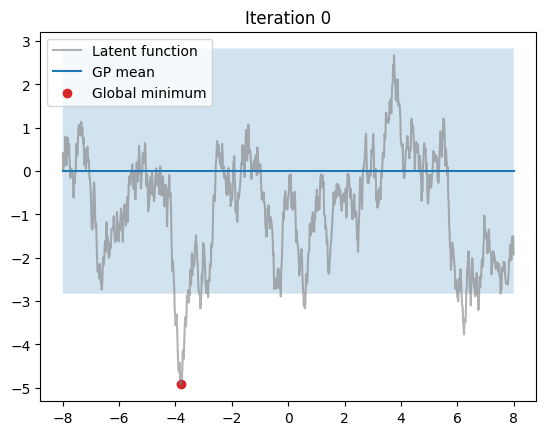

current surrogate price: -1.994706
optimal new expected surrogate price: -2.070635
minimum gittins index: -2.0039062


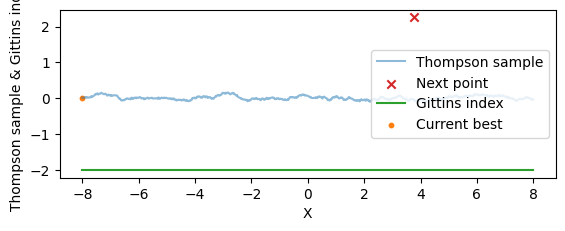

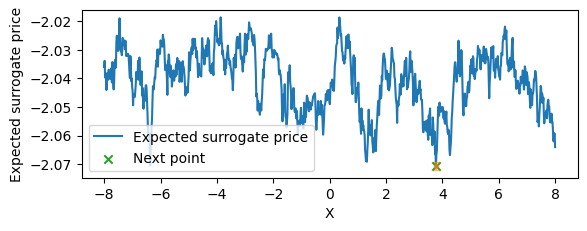

Next point: [3.7717714]

Iteration 1:
Current best value: [0]
Current best point: [-8]
New point: [3.7717714]
New value: [2.2551062]
Objective: [4.973608]


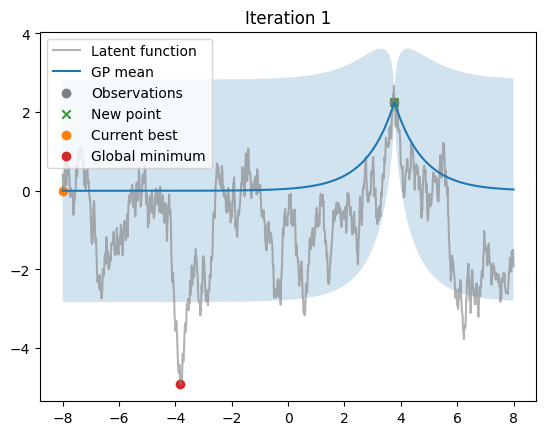


current surrogate price: -1.9684858
optimal new surrogate price: -2.0514088
minimum gittins index: -2.003296


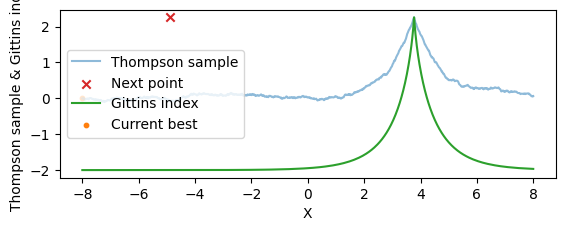

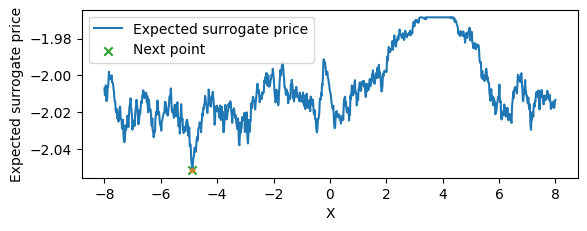

Next point: [-4.876877]

Iteration 2:
Current best value: [-0.13470295]
Current best point: [-4.876877]
New point: [-4.876877]
New value: [-0.13470295]
Objective: [4.8889046]


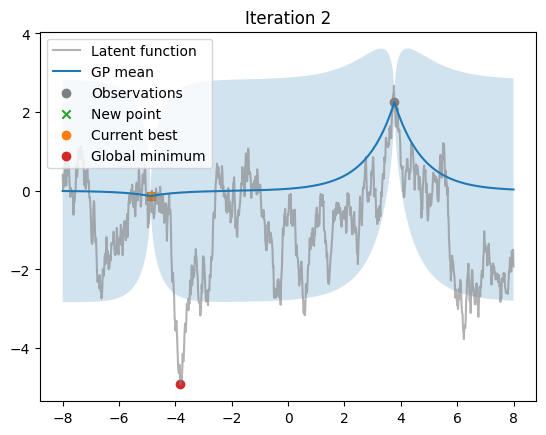


current surrogate price: -1.9613557
optimal new surrogate price: -2.0319633
minimum gittins index: -2.0066528


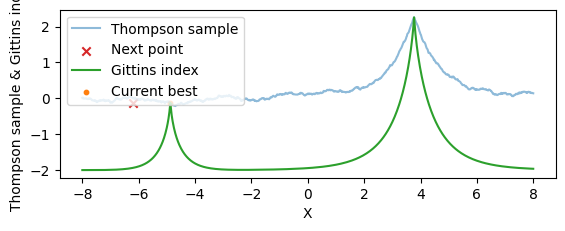

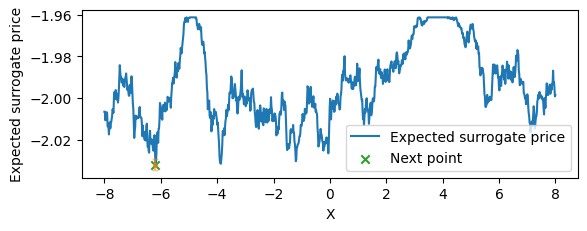

Next point: [-6.1901903]

Iteration 3:
Current best value: [-1.0411046]
Current best point: [-6.1901903]
New point: [-6.1901903]
New value: [-1.0411046]
Objective: [4.032503]


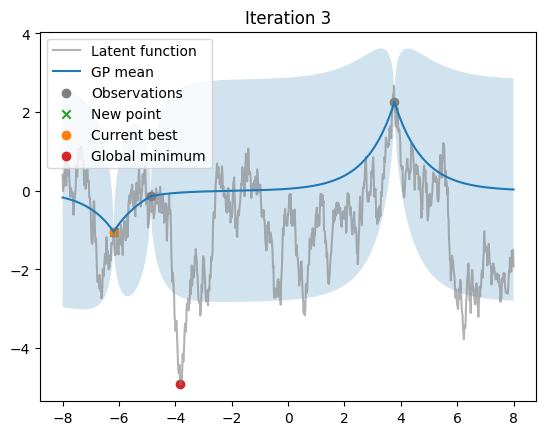


current surrogate price: -2.0618646
optimal new surrogate price: -2.133079
minimum gittins index: -2.2023315


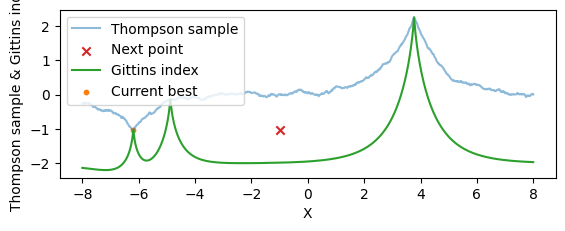

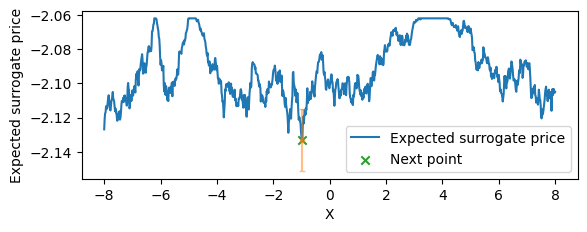

Next point: [-0.9689691]

Iteration 4:
Current best value: [-1.0411046]
Current best point: [-6.1901903]
New point: [-0.9689691]
New value: [-0.16996923]
Objective: [4.0825033]


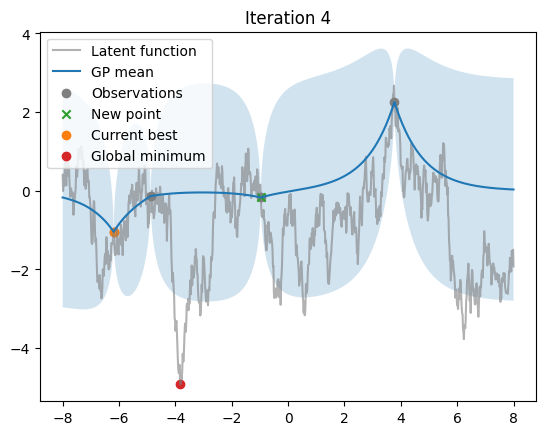


current surrogate price: -2.0463922
optimal new surrogate price: -2.1116965
minimum gittins index: -2.2023315


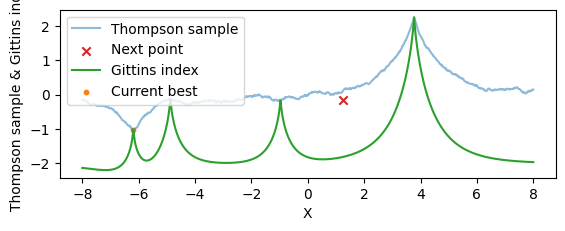

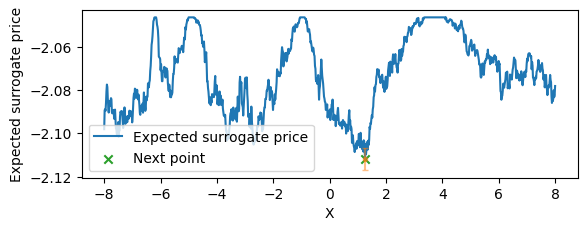

Next point: [1.2572572]

Iteration 5:
Current best value: [-1.0411046]
Current best point: [-6.1901903]
New point: [1.2572572]
New value: [-0.26717108]
Objective: [4.1325035]


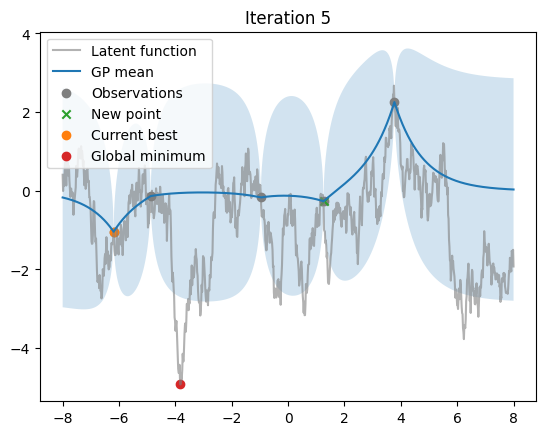


current surrogate price: -2.0451324
optimal new surrogate price: -2.1263697
minimum gittins index: -2.2023315


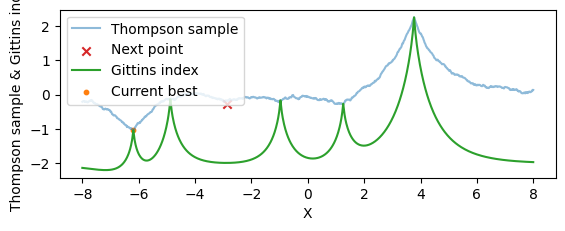

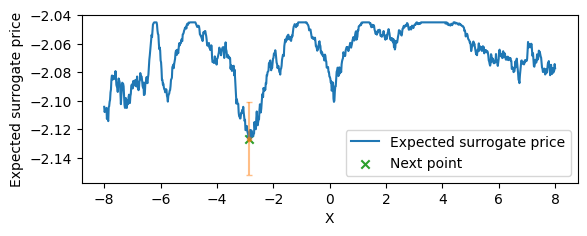

Next point: [-2.874875]

Iteration 6:
Current best value: [-2.6846151]
Current best point: [-2.874875]
New point: [-2.874875]
New value: [-2.6846151]
Objective: [2.5389926]


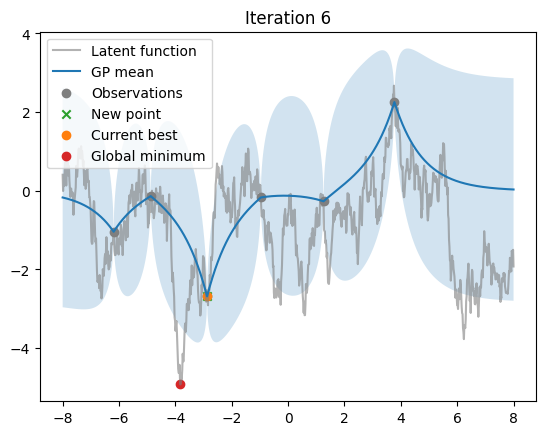


current surrogate price: -3.0115666
optimal new surrogate price: -3.0540745
minimum gittins index: -3.1290894


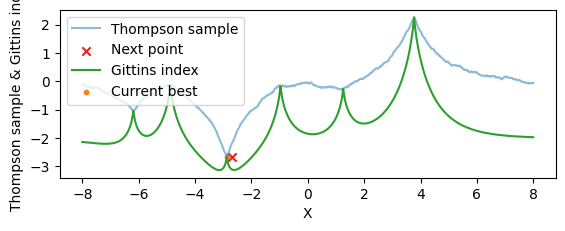

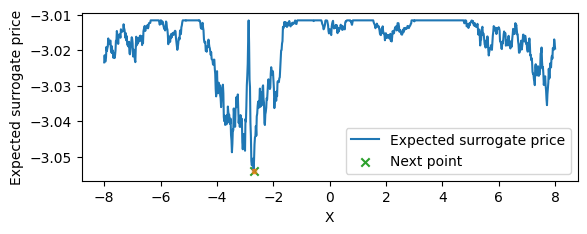

Next point: [-2.698699]

Iteration 7:
Current best value: [-2.6846151]
Current best point: [-2.874875]
New point: [-2.698699]
New value: [-1.7021114]
Objective: [2.5889926]


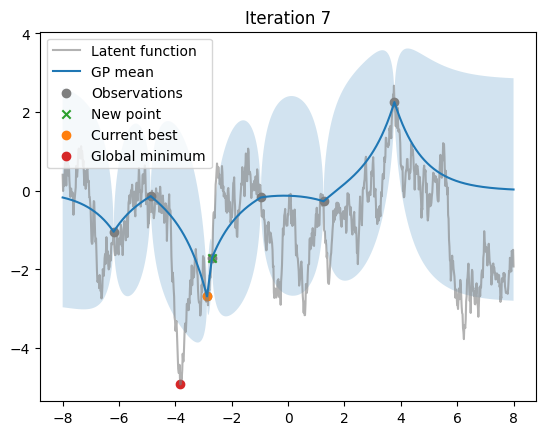


current surrogate price: -2.9267838
optimal new surrogate price: -2.9858851
minimum gittins index: -3.1290894


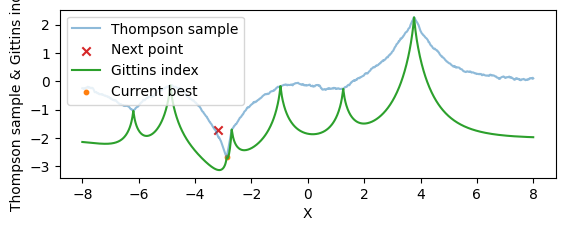

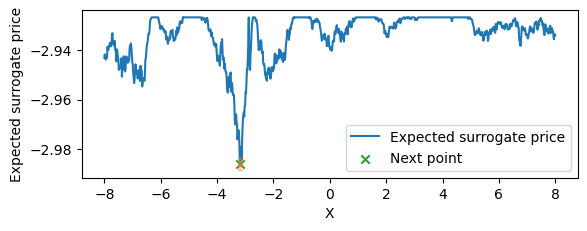

Next point: [-3.1791792]

Iteration 8:
Current best value: [-2.7447095]
Current best point: [-3.1791792]
New point: [-3.1791792]
New value: [-2.7447095]
Objective: [2.5788984]


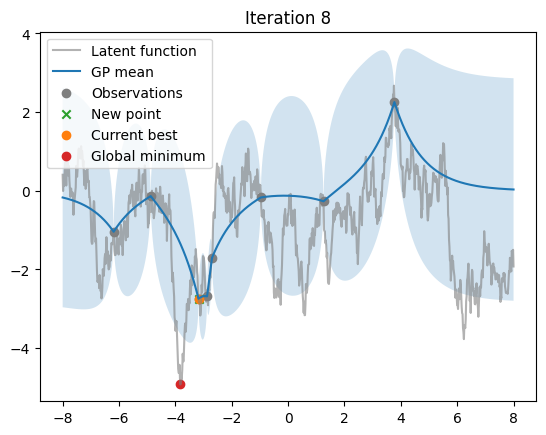


current surrogate price: -3.1053956
optimal new surrogate price: -3.1699822
minimum gittins index: -3.2079468


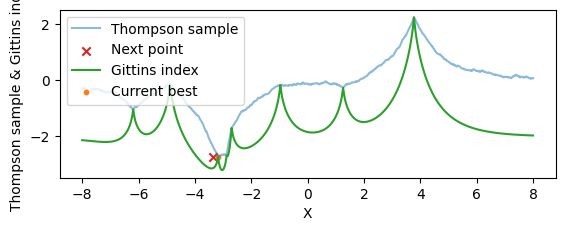

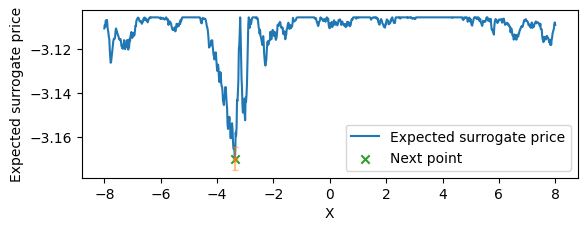

Next point: [-3.3713713]

Iteration 9:
Current best value: [-2.7447095]
Current best point: [-3.1791792]
New point: [-3.3713713]
New value: [-1.9511781]
Objective: [2.6288984]


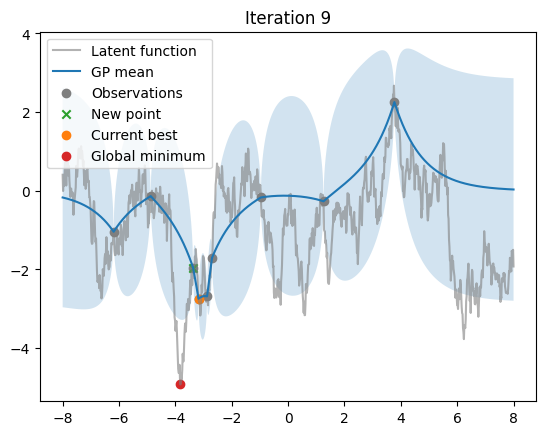


current surrogate price: -3.0573328
optimal new surrogate price: -3.1322954
minimum gittins index: -3.2079468


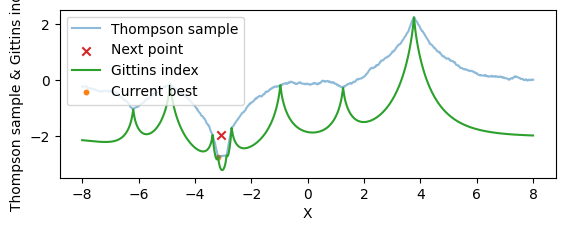

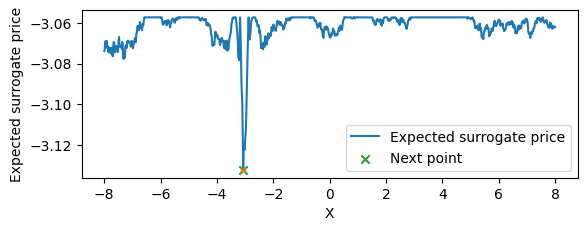

Next point: [-3.0670671]

Iteration 10:
Current best value: [-2.7447095]
Current best point: [-3.1791792]
New point: [-3.0670671]
New value: [-2.3900173]
Objective: [2.6788983]


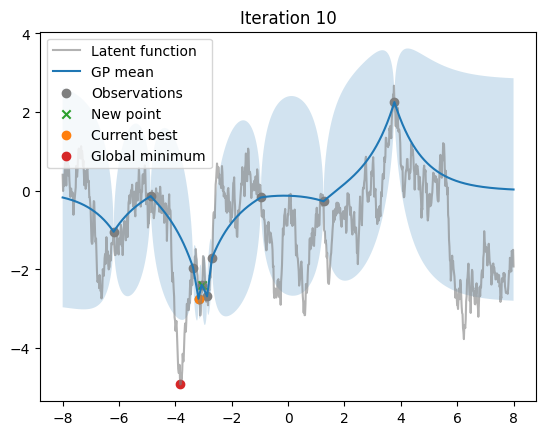


current surrogate price: -2.8461156
optimal new surrogate price: -2.902713
minimum gittins index: -2.9048462


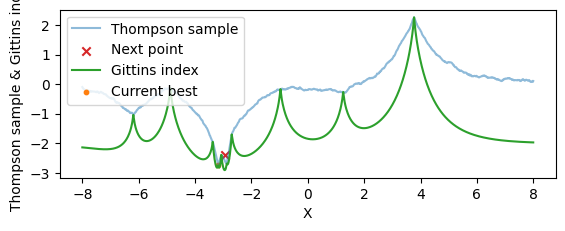

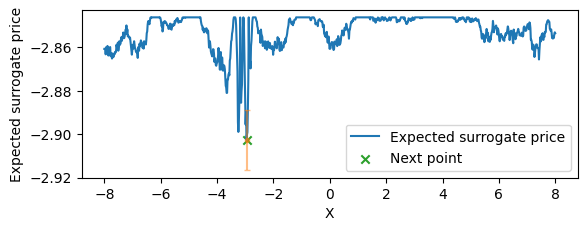

Next point: [-2.954955]

Iteration 11:
Current best value: [-2.7447095]
Current best point: [-3.1791792]
New point: [-2.954955]
New value: [-2.1866431]
Objective: [2.7288983]


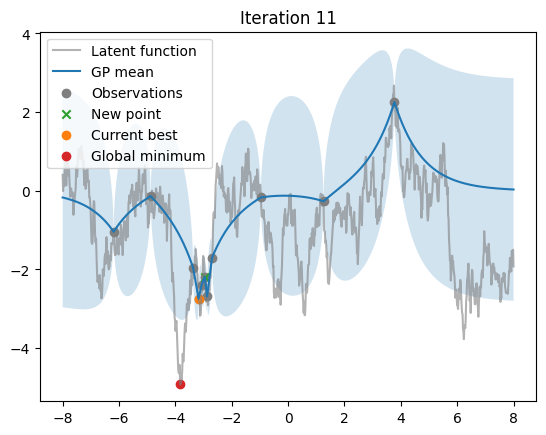


current surrogate price: -2.7965744
optimal new surrogate price: -2.8448718
minimum gittins index: -2.8251343


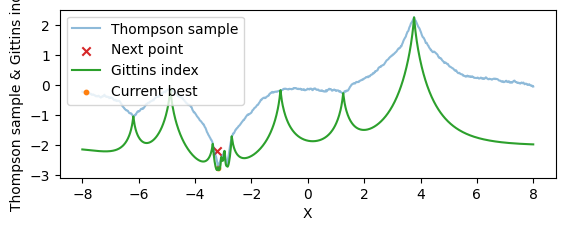

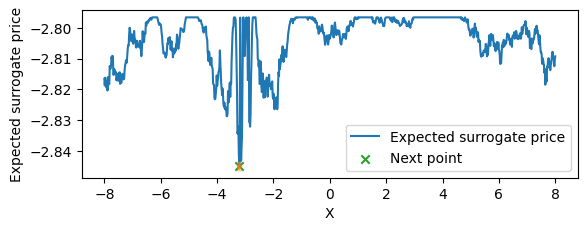

Next point: [-3.2112112]

Iteration 12:
Current best value: [-2.7447095]
Current best point: [-3.1791792]
New point: [-3.2112112]
New value: [-2.1542397]
Objective: [2.7788982]


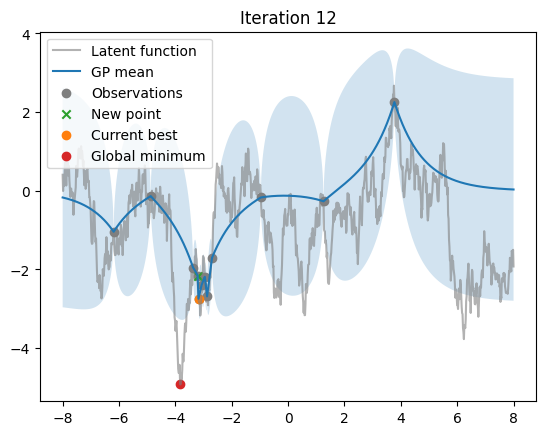


current surrogate price: -2.7789562
optimal new surrogate price: -2.824246
minimum gittins index: -2.8251343


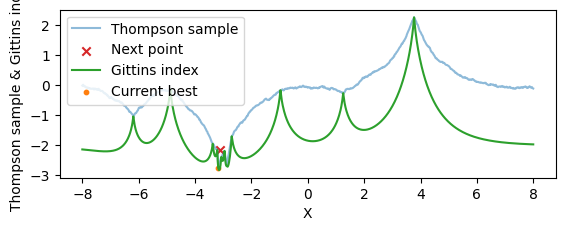

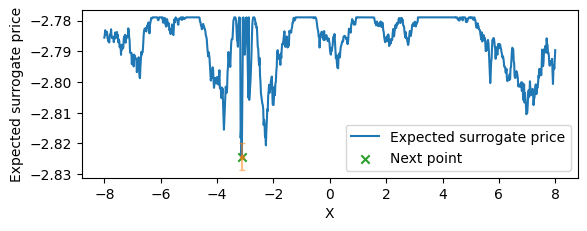

Next point: [-3.1311312]

Iteration 13:
Current best value: [-2.8691971]
Current best point: [-3.1311312]
New point: [-3.1311312]
New value: [-2.8691971]
Objective: [2.7044106]


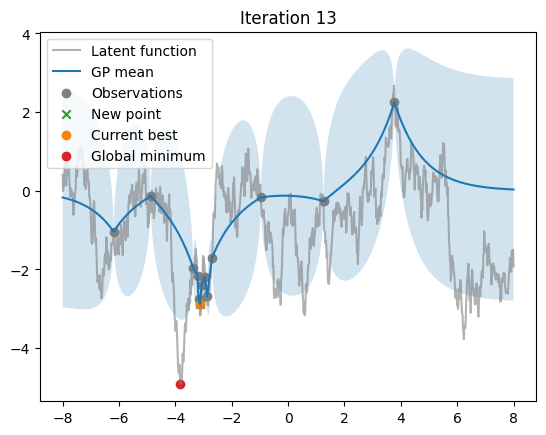


current surrogate price: -2.8808367
optimal new surrogate price: -2.9286711
minimum gittins index: -2.902893


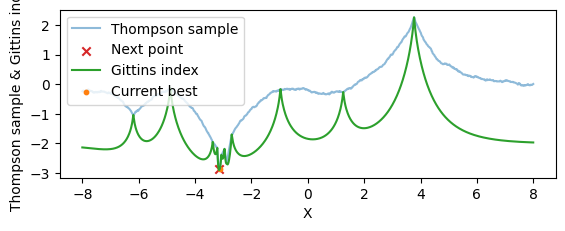

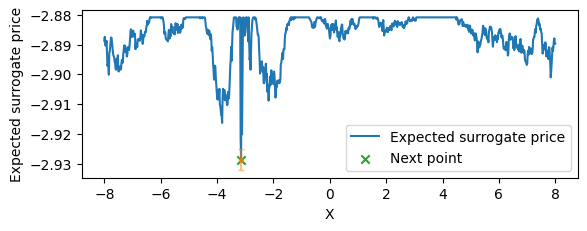

Next point: [-3.1471472]

Iteration 14:
Current best value: [-2.8691971]
Current best point: [-3.1311312]
New point: [-3.1471472]
New value: [-2.8371358]
Objective: [2.7544107]


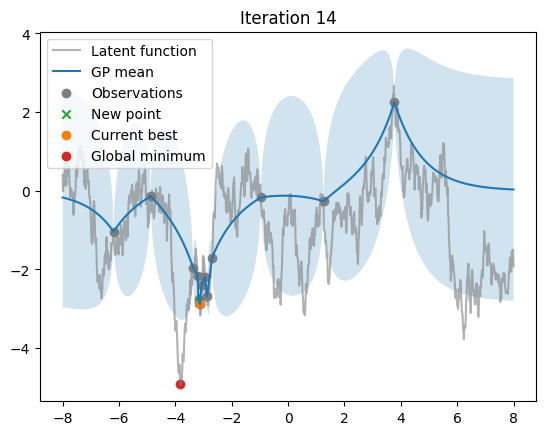


current surrogate price: -2.8685858
optimal new surrogate price: -2.9062622
minimum gittins index: -2.8691528


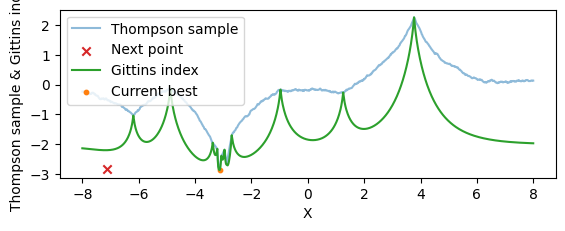

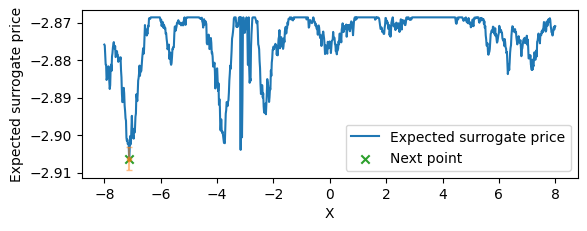

Next point: [-7.1191187]

Iteration 15:
Current best value: [-2.8691971]
Current best point: [-3.1311312]
New point: [-7.1191187]
New value: [0.5601212]
Objective: [2.8044107]


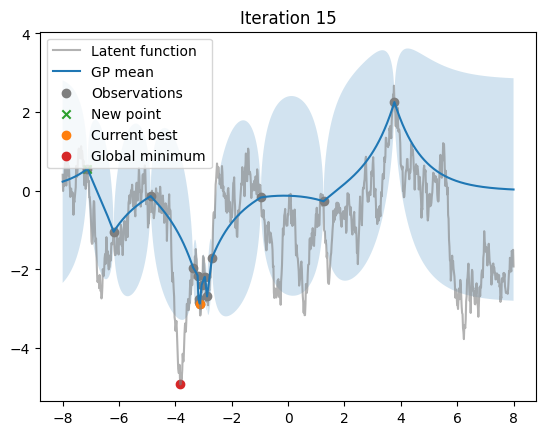


current surrogate price: -2.8686187
optimal new surrogate price: -2.9130173
minimum gittins index: -2.8691528


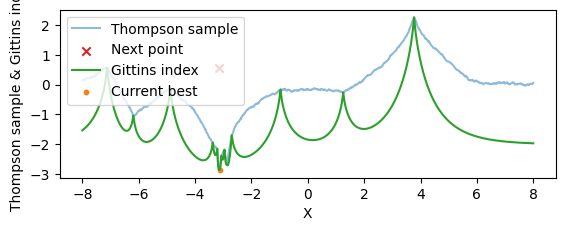

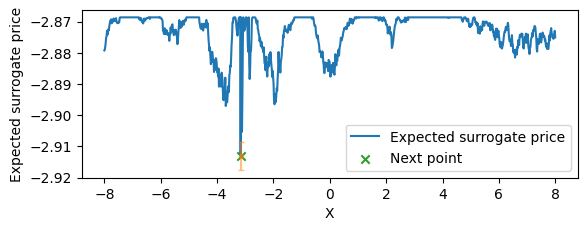

Next point: [-3.1631632]

Iteration 16:
Current best value: [-2.8691971]
Current best point: [-3.1311312]
New point: [-3.1631632]
New value: [-2.8385332]
Objective: [2.8544106]


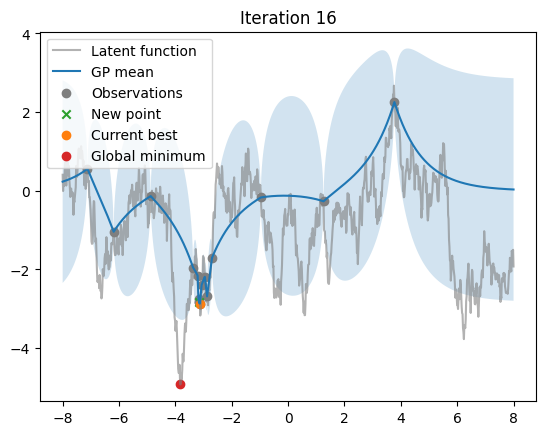


current surrogate price: -2.8686025
optimal new surrogate price: -2.9085252
minimum gittins index: -2.8691528


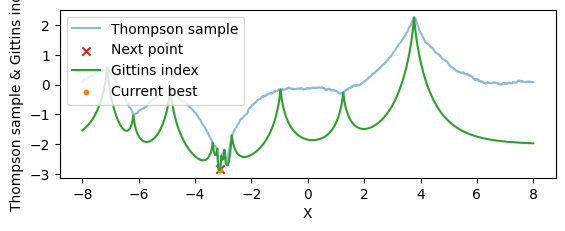

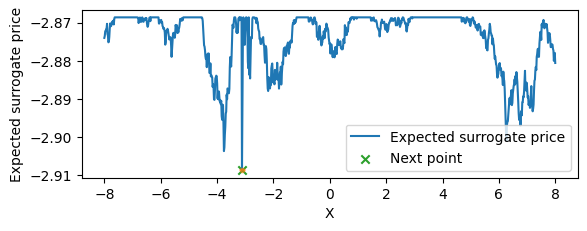

Next point: [-3.1151152]

Stopping time: 14
Objective value: 2.7544107
Best observed value: -2.8691971


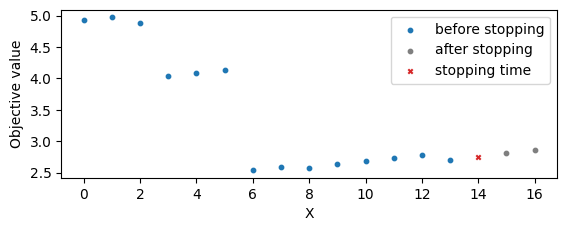

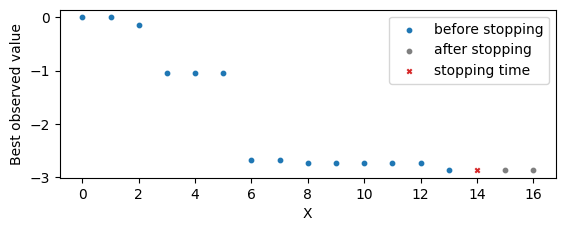

In [196]:
eps = 0.0001
num_samples = 400
# Specifiy policy and kernel hyperparameters
BayesianOptimization(seed=35, policy='Surrogate', num_points=1000, iterations = 16, query_cost = 0.05, kernel = jk.Matern12(), kernel_parameters={"lengthscale": jnp.array([1.0]), "variance": jnp.array([2.0])})

Global minimum point: [-3.8198197]
Global minimum value: -4.92360782623291



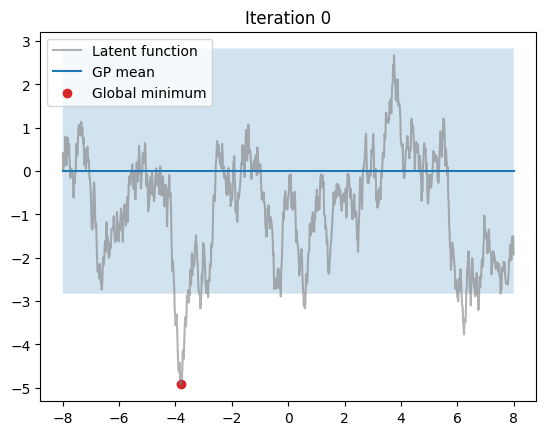

current surrogate price: -1.9903415
optimal new expected surrogate price: -2.0631394
minimum gittins index: -2.0039062


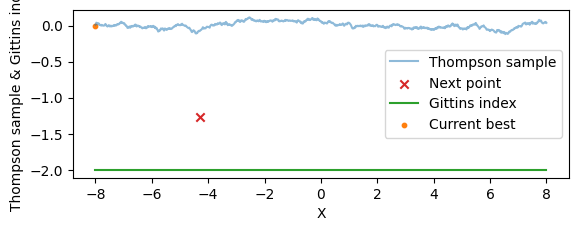

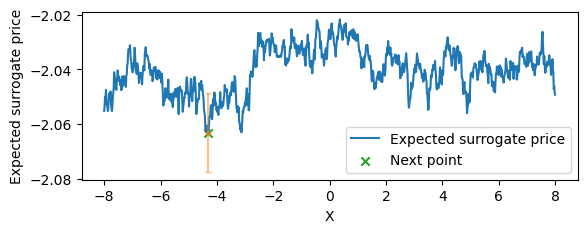

Next point: [-4.3003006]

Iteration 1:
Current best value: [-1.2739596]
Current best point: [-4.3003006]
New point: [-4.3003006]
New value: [-1.2739596]
Objective: [3.6996481]


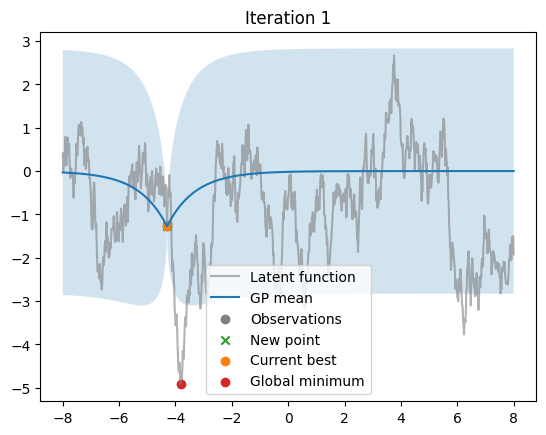


current surrogate price: -2.2062001
optimal new surrogate price: -2.2721088
minimum gittins index: -2.2971191


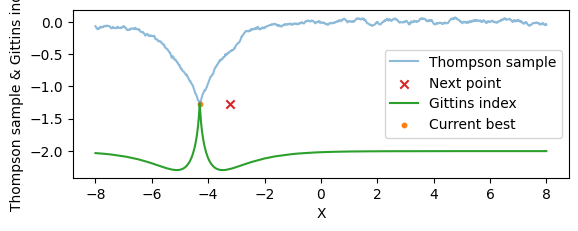

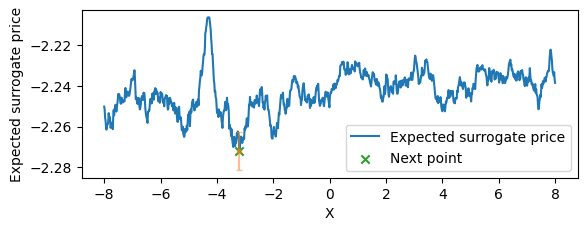

Next point: [-3.2112112]

Iteration 2:
Current best value: [-2.1542397]
Current best point: [-3.2112112]
New point: [-3.2112112]
New value: [-2.1542397]
Objective: [2.869368]


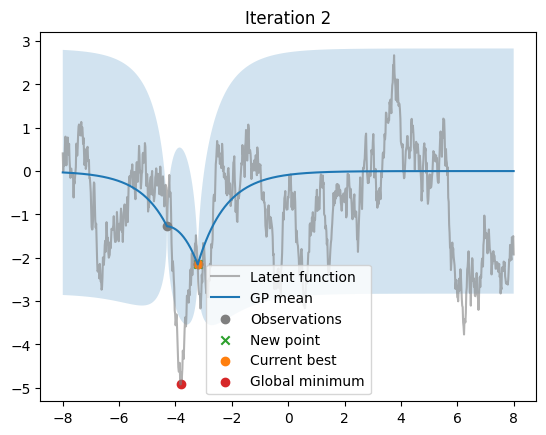


current surrogate price: -2.6719632
optimal new surrogate price: -2.7355828
minimum gittins index: -2.8127441


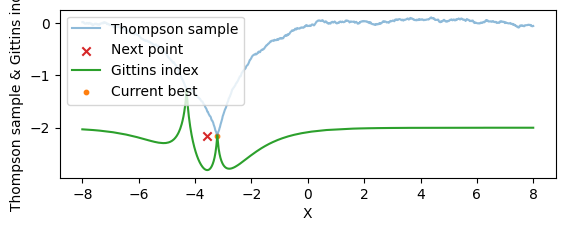

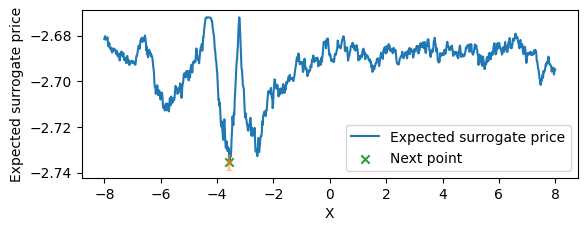

Next point: [-3.5635636]

Iteration 3:
Current best value: [-2.9198723]
Current best point: [-3.5635636]
New point: [-3.5635636]
New value: [-2.9198723]
Objective: [2.1537356]


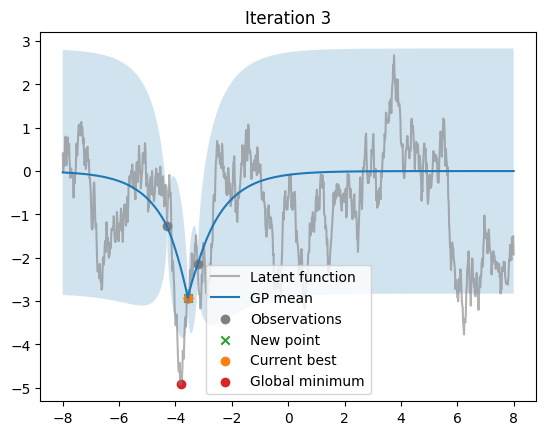


current surrogate price: -3.1280243
optimal new surrogate price: -3.1826785
minimum gittins index: -3.2165527


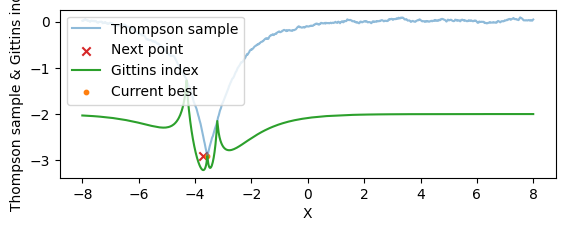

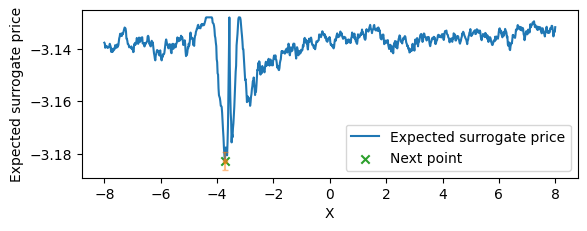

Next point: [-3.7237236]

Iteration 4:
Current best value: [-4.334664]
Current best point: [-3.7237236]
New point: [-3.7237236]
New value: [-4.334664]
Objective: [0.78894395]


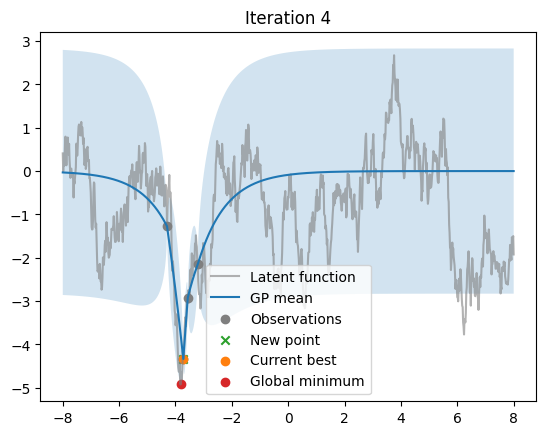


current surrogate price: -4.351648
optimal new surrogate price: -4.4046626
minimum gittins index: -4.3779907


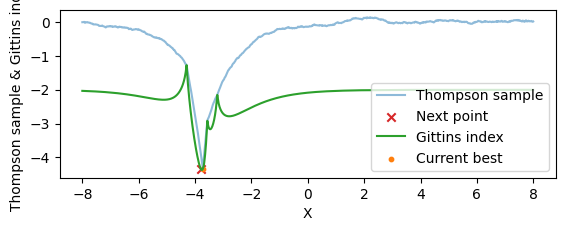

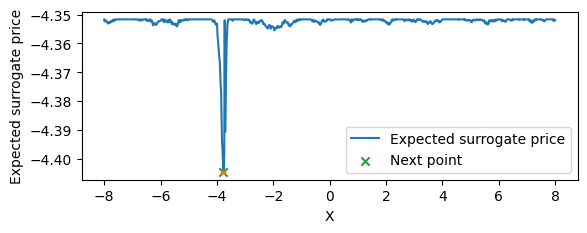

Next point: [-3.7717717]

Iteration 5:
Current best value: [-4.748908]
Current best point: [-3.7717717]
New point: [-3.7717717]
New value: [-4.748908]
Objective: [0.42469978]


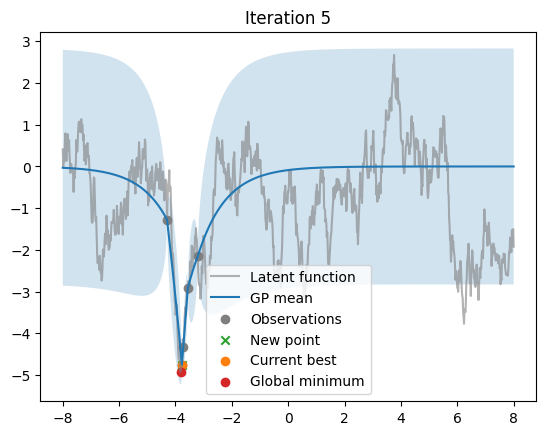


current surrogate price: -4.749476
optimal new surrogate price: -4.805058
minimum gittins index: -4.7512817


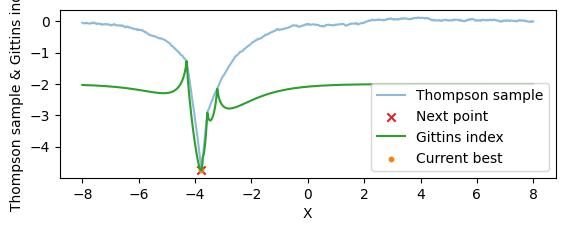

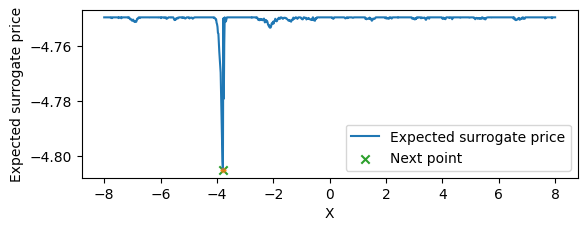

Next point: [-3.7877877]

Iteration 6:
Current best value: [-4.823165]
Current best point: [-3.7877877]
New point: [-3.7877877]
New value: [-4.823165]
Objective: [0.4004429]


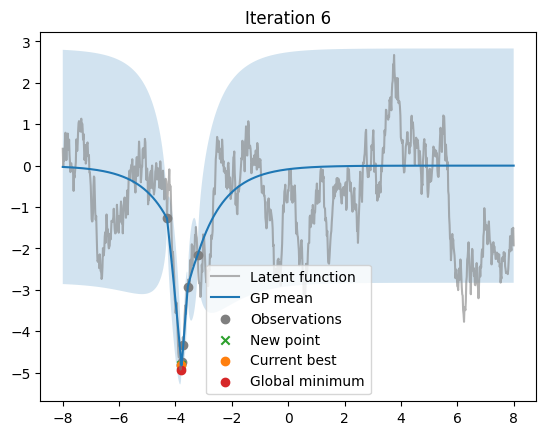


current surrogate price: -4.822593
optimal new surrogate price: -4.871298
minimum gittins index: -4.8231325


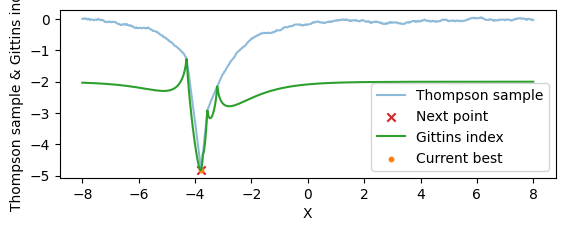

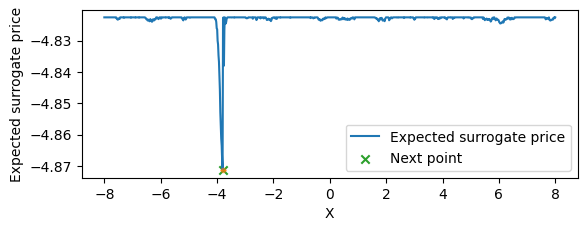

Next point: [-3.8038037]

Iteration 7:
Current best value: [-4.823165]
Current best point: [-3.7877877]
New point: [-3.8038037]
New value: [-4.6467075]
Objective: [0.45044288]


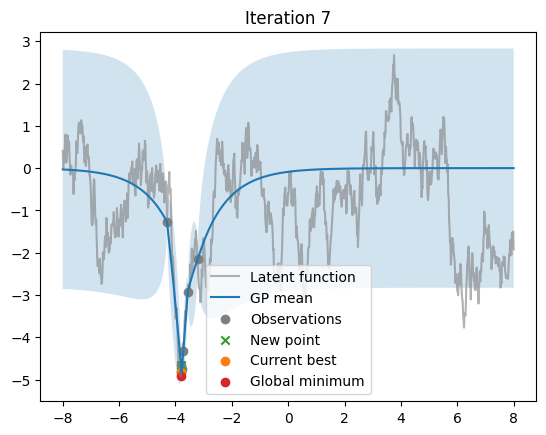


current surrogate price: -4.8225956
optimal new surrogate price: -4.8440533
minimum gittins index: -4.8231325


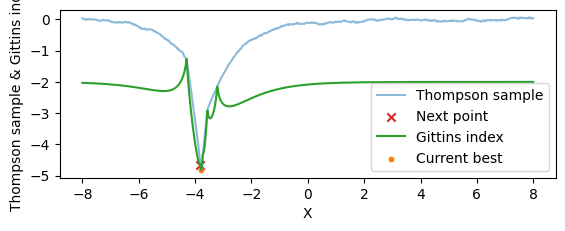

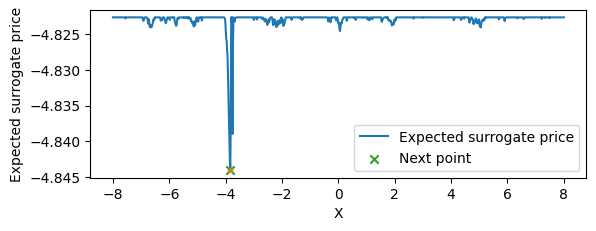

Next point: [-3.8358357]

Iteration 8:
Current best value: [-4.823165]
Current best point: [-3.7877877]
New point: [-3.8358357]
New value: [-4.8114414]
Objective: [0.50044286]


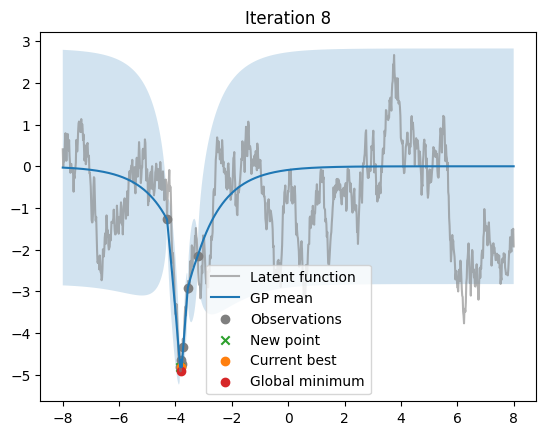


current surrogate price: -4.8225813
optimal new surrogate price: -4.8667526
minimum gittins index: -4.8231325


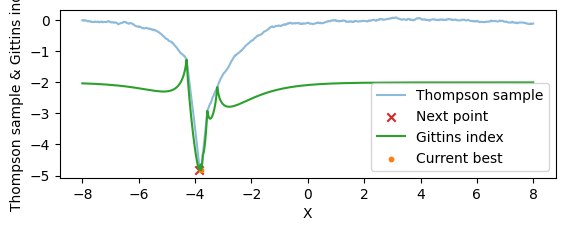

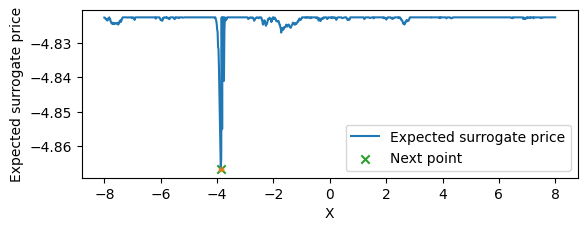

Next point: [-3.8678677]

Iteration 9:
Current best value: [-4.823165]
Current best point: [-3.7877877]
New point: [-3.8678677]
New value: [-4.629747]
Objective: [0.5504429]


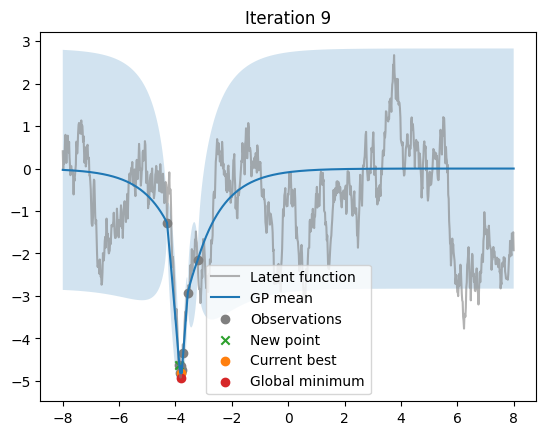


current surrogate price: -4.8226066
optimal new surrogate price: -4.855168
minimum gittins index: -4.8231325


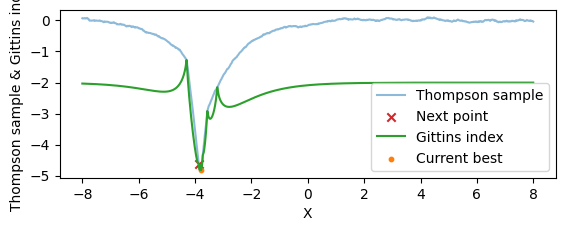

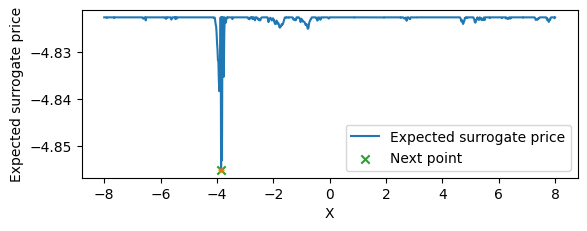

Next point: [-3.8518517]

Iteration 10:
Current best value: [-4.823165]
Current best point: [-3.7877877]
New point: [-3.8518517]
New value: [-4.4236784]
Objective: [0.6004429]


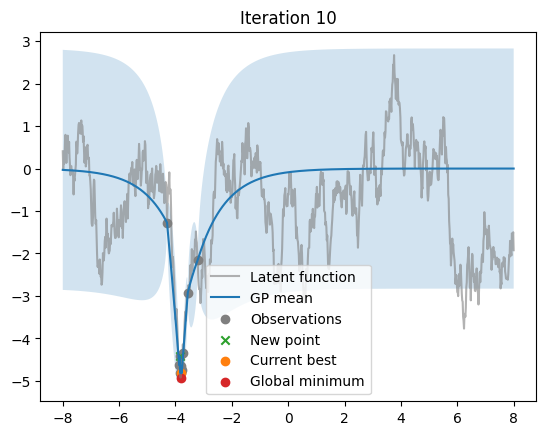


current surrogate price: -4.82256
optimal new surrogate price: -4.856591
minimum gittins index: -4.8231325


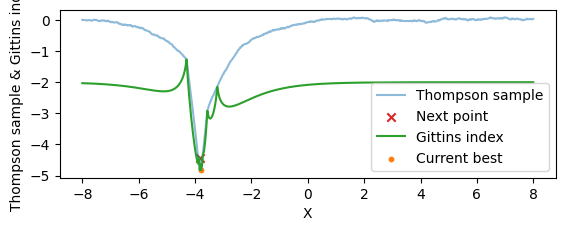

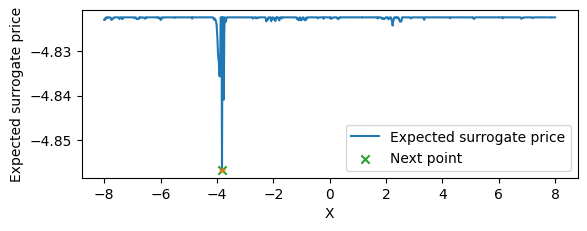

Next point: [-3.8198197]

Iteration 11:
Current best value: [-4.923608]
Current best point: [-3.8198197]
New point: [-3.8198197]
New value: [-4.923608]
Objective: [0.55]


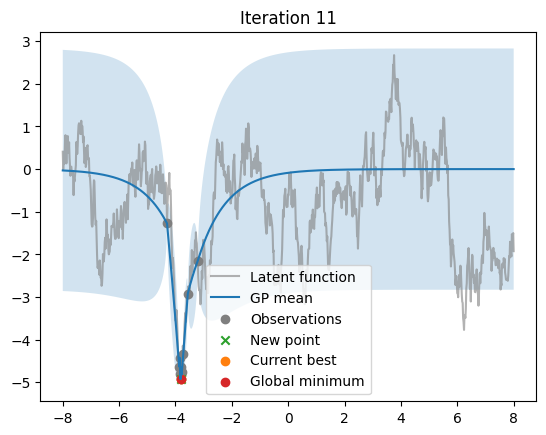


current surrogate price: -4.9230514
optimal new surrogate price: -4.9343133
minimum gittins index: -4.9235964


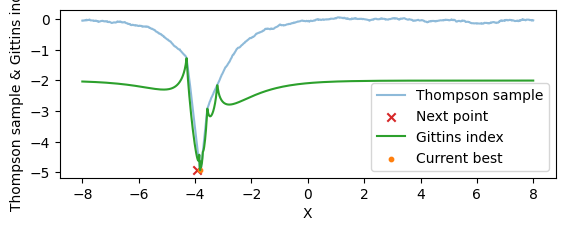

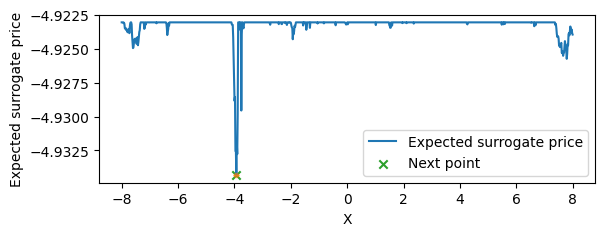

Next point: [-3.9319322]

Iteration 12:
Current best value: [-4.923608]
Current best point: [-3.8198197]
New point: [-3.9319322]
New value: [-3.868667]
Objective: [0.6]


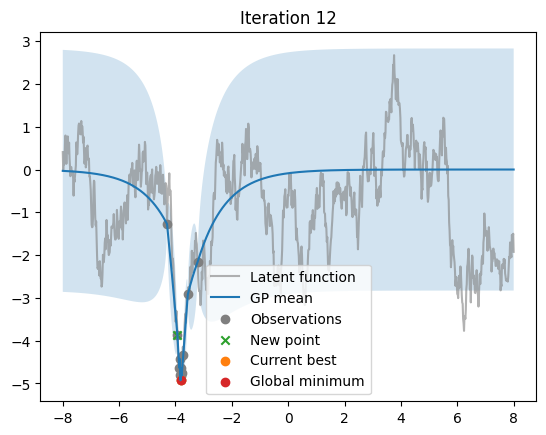


current surrogate price: -4.9230275
optimal new surrogate price: -4.928218
minimum gittins index: -4.9235964


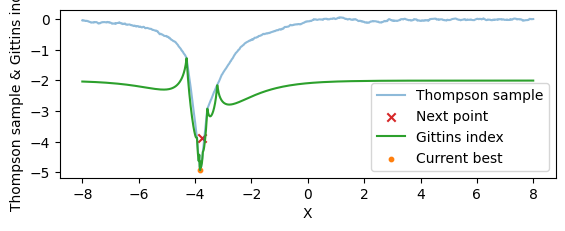

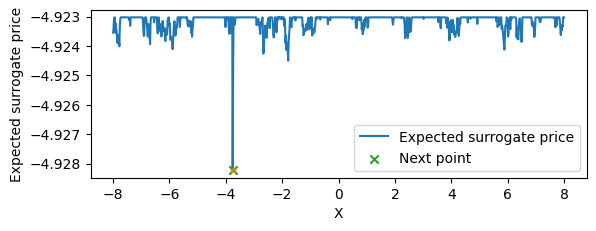

Next point: [-3.7557557]

Iteration 13:
Current best value: [-4.923608]
Current best point: [-3.8198197]
New point: [-3.7557557]
New value: [-4.552999]
Objective: [0.65]


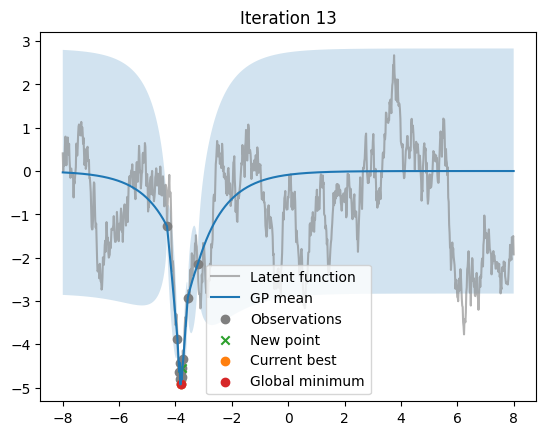


current surrogate price: -4.92302
optimal new surrogate price: -4.9249797
minimum gittins index: -4.9235964


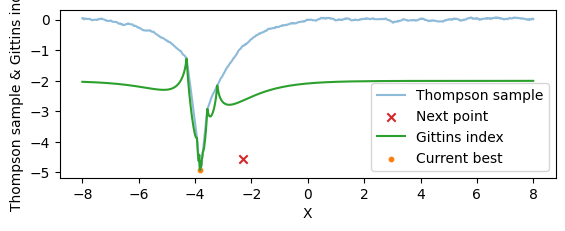

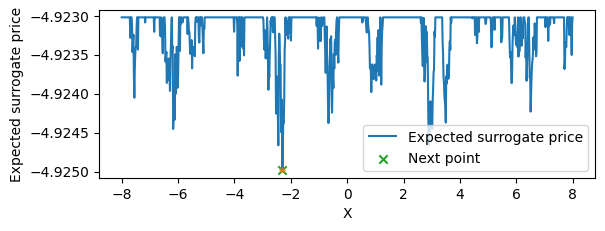

Next point: [-2.2982986]

Iteration 14:
Current best value: [-4.923608]
Current best point: [-3.8198197]
New point: [-2.2982986]
New value: [0.11605471]
Objective: [0.7]


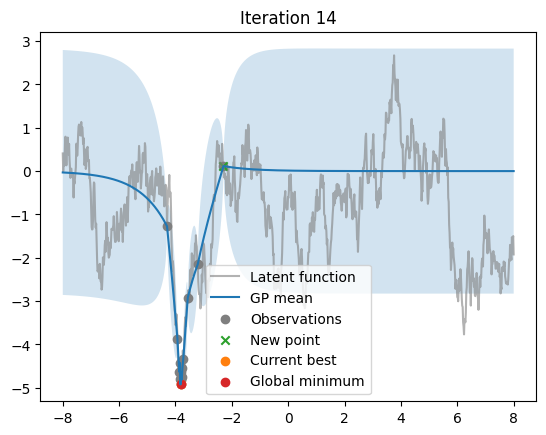


current surrogate price: -4.923034
optimal new surrogate price: -4.9243073
minimum gittins index: -4.9235964


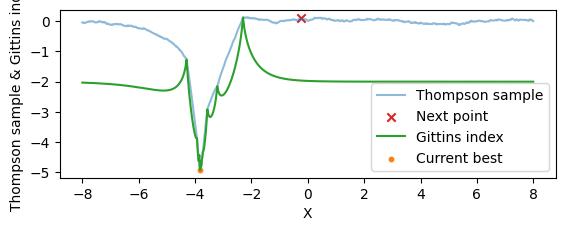

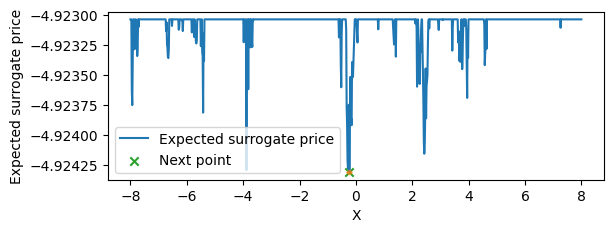

Next point: [-0.23223233]

Iteration 15:
Current best value: [-4.923608]
Current best point: [-3.8198197]
New point: [-0.23223233]
New value: [-2.1308022]
Objective: [0.75]


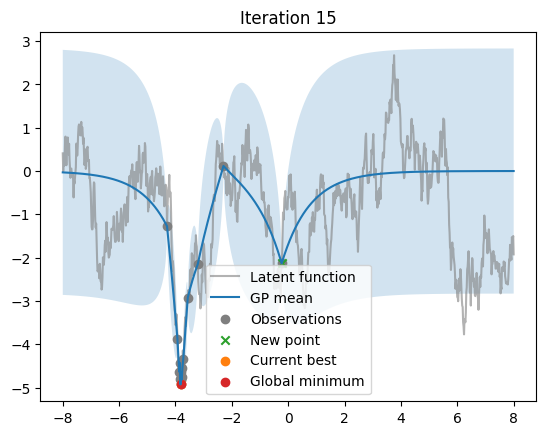


current surrogate price: -4.9229994
optimal new surrogate price: -4.9251466
minimum gittins index: -4.9235964


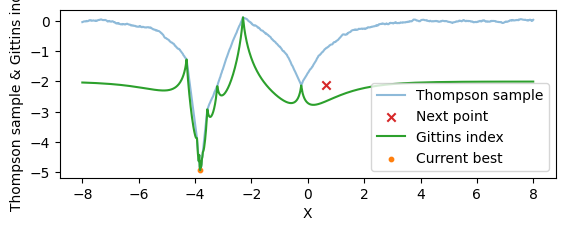

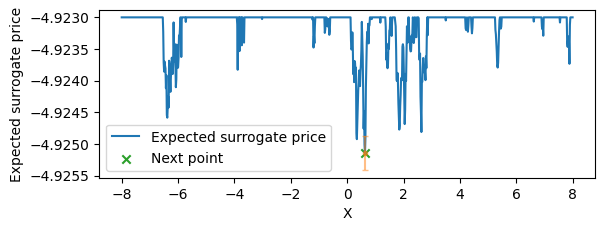

Next point: [0.6326325]

Iteration 16:
Current best value: [-4.923608]
Current best point: [-3.8198197]
New point: [0.6326325]
New value: [-2.369853]
Objective: [0.8]


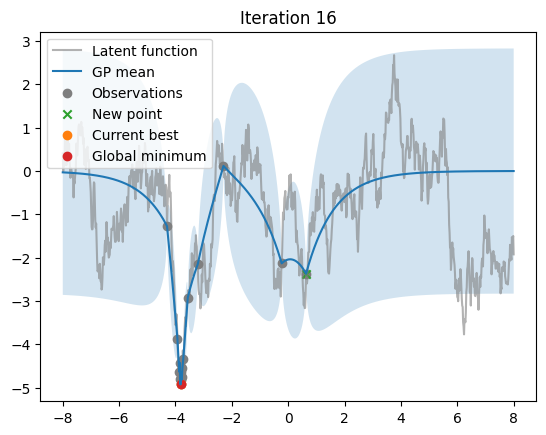


current surrogate price: -4.9230065
optimal new surrogate price: -4.924413
minimum gittins index: -4.9235964


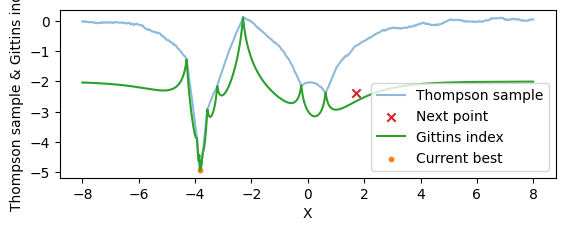

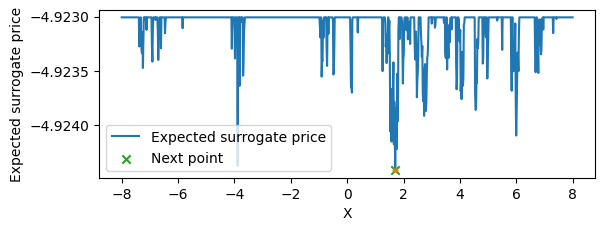

Next point: [1.7057056]

Stopping time: 6
Objective value: 0.4004429
Best observed value: -4.823165


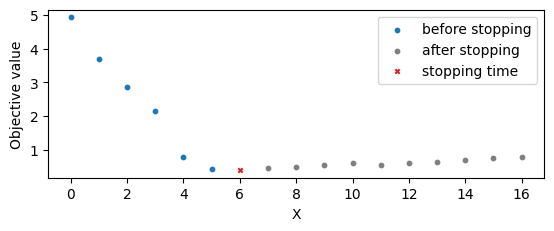

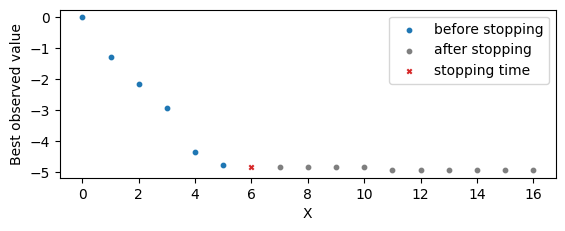

In [197]:
eps = 0.0001
num_samples = 900
# Specifiy policy and kernel hyperparameters
BayesianOptimization(seed=35, policy='Surrogate', num_points=1000, iterations = 16, query_cost = 0.05, kernel = jk.Matern12(), kernel_parameters={"lengthscale": jnp.array([1.0]), "variance": jnp.array([2.0])})

Global minimum point: [-4.3163166]
Global minimum value: -4.103152275085449



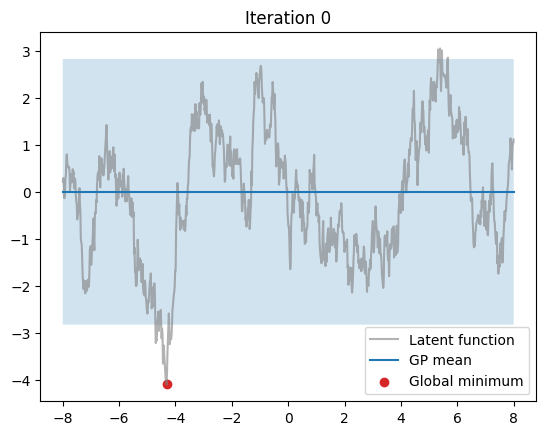

current surrogate price: -2.0008657
optimal new expected surrogate price: -2.0798616
minimum gittins index: -2.0039062


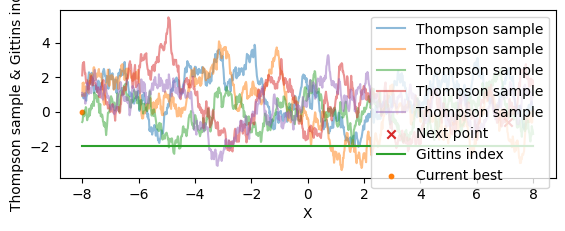

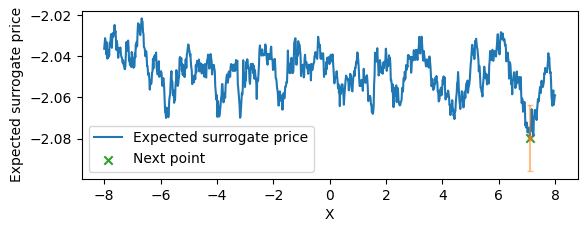

Next point: [7.1031027]

Iteration 1:
Current best value: [-0.63051665]
Current best point: [7.1031027]
New point: [7.1031027]
New value: [-0.63051665]
Objective: [3.5226357]


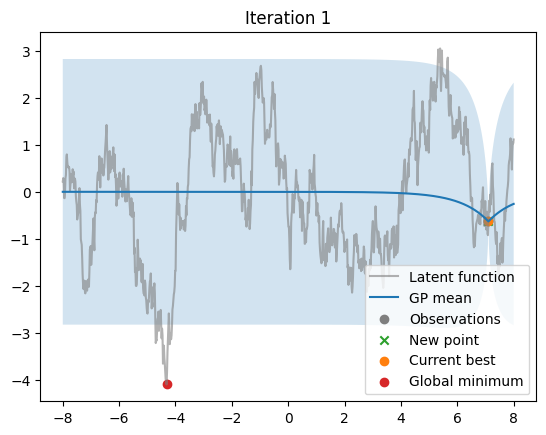


current surrogate price: -2.0268784
optimal new surrogate price: -2.1049137
minimum gittins index: -2.0777588


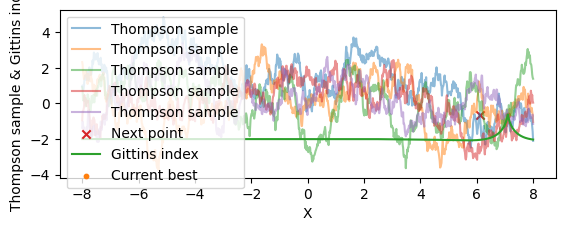

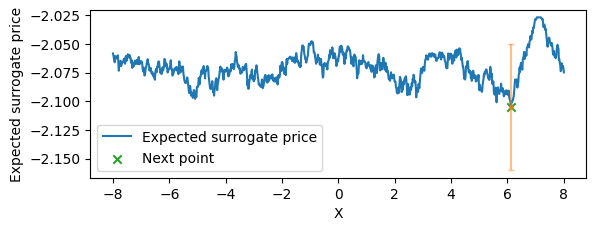

Next point: [6.1261263]

Iteration 2:
Current best value: [-0.63051665]
Current best point: [7.1031027]
New point: [6.1261263]
New value: [1.2594988]
Objective: [3.5726357]


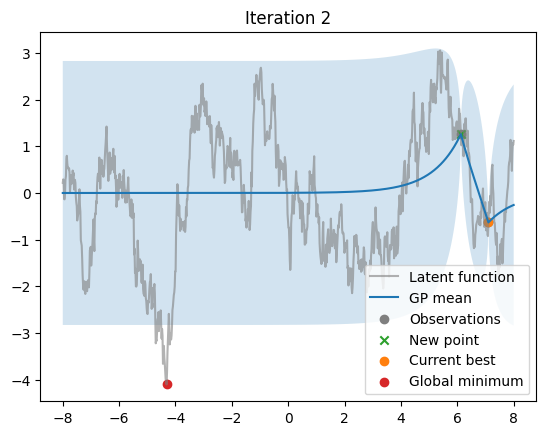


current surrogate price: -1.9823854
optimal new surrogate price: -2.0716991
minimum gittins index: -2.032837


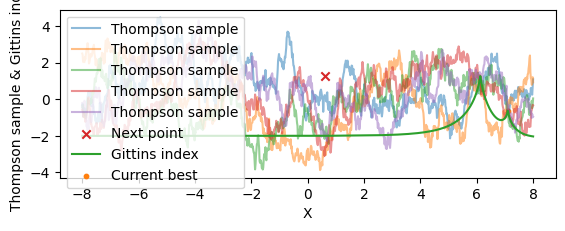

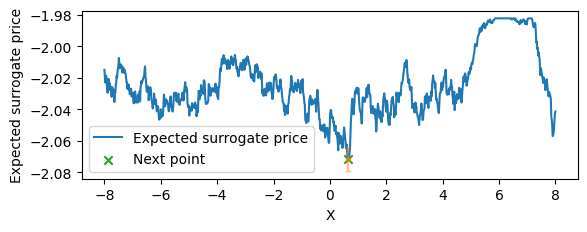

Next point: [0.6326325]

Iteration 3:
Current best value: [-1.0667229]
Current best point: [0.6326325]
New point: [0.6326325]
New value: [-1.0667229]
Objective: [3.1864295]


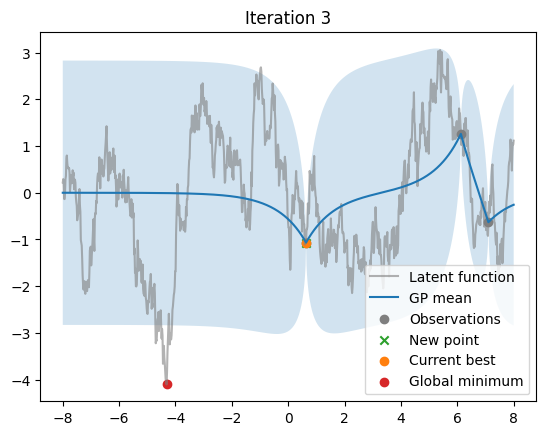


current surrogate price: -2.1287715
optimal new surrogate price: -2.2079206
minimum gittins index: -2.2120361


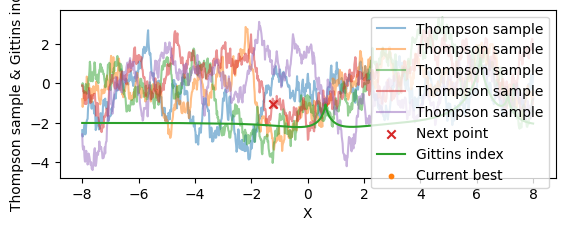

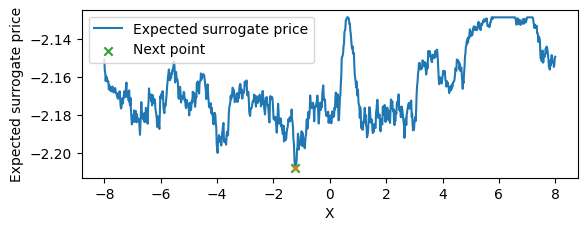

Next point: [-1.2412415]

Iteration 4:
Current best value: [-1.0667229]
Current best point: [0.6326325]
New point: [-1.2412415]
New value: [1.4885166]
Objective: [3.2364295]


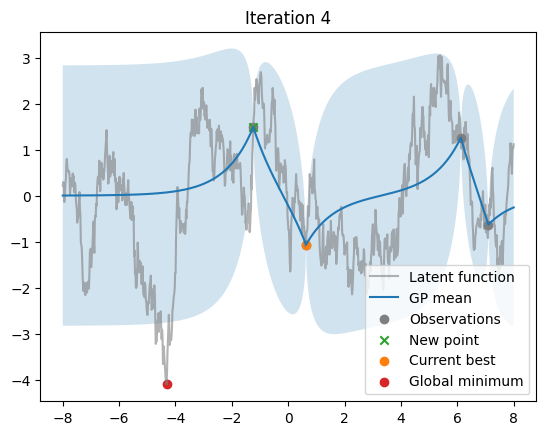


current surrogate price: -2.0509074
optimal new surrogate price: -2.1104007
minimum gittins index: -2.2003174


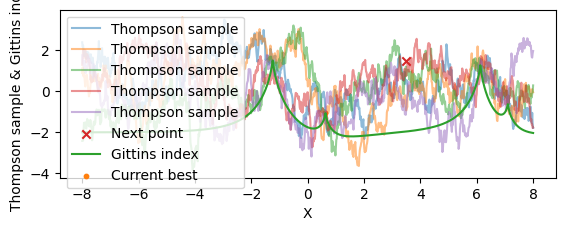

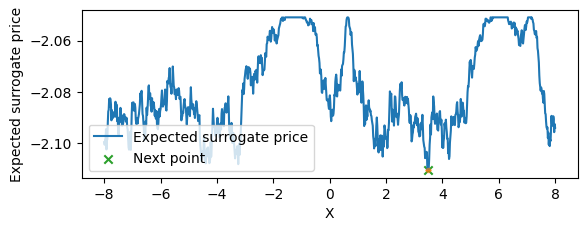

Next point: [3.4994993]

Iteration 5:
Current best value: [-1.0667229]
Current best point: [0.6326325]
New point: [3.4994993]
New value: [-1.0368874]
Objective: [3.2864294]


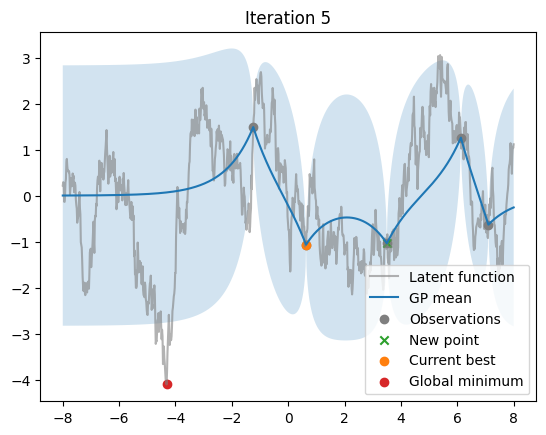


current surrogate price: -2.1494915
optimal new surrogate price: -2.219521
minimum gittins index: -2.3326416


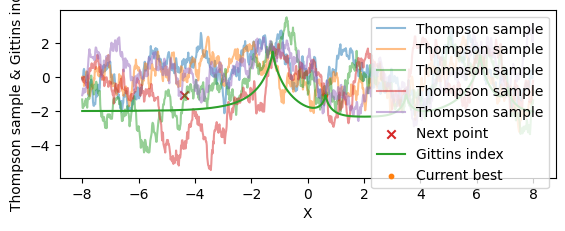

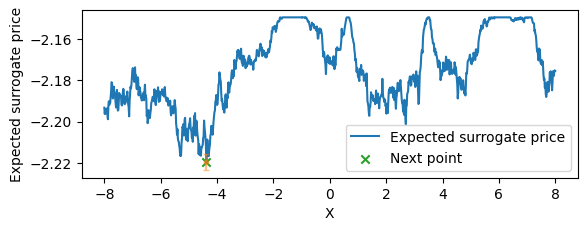

Next point: [-4.3803806]

Iteration 6:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.3803806]
New value: [-3.6525016]
Objective: [0.7506507]


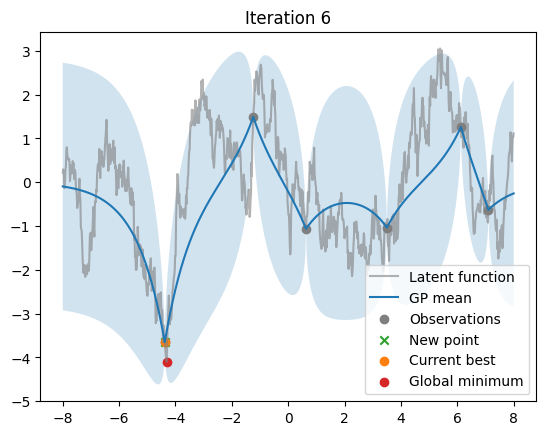


current surrogate price: -3.849287
optimal new surrogate price: -3.9100766
minimum gittins index: -3.932251


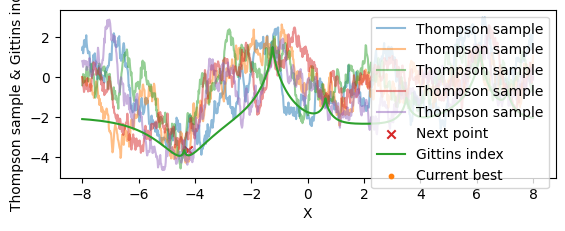

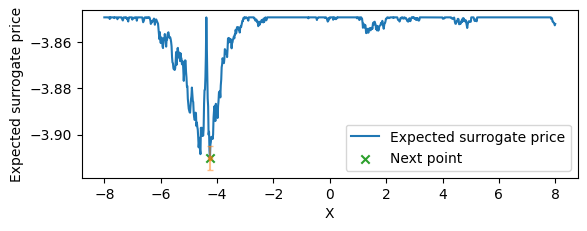

Next point: [-4.2522526]

Iteration 7:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.2522526]
New value: [-2.862173]
Objective: [0.8006507]


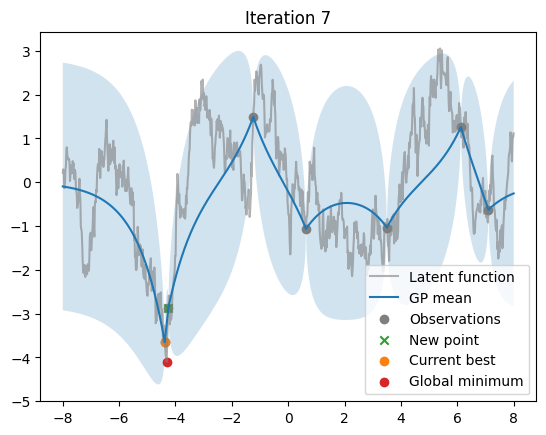


current surrogate price: -3.7882135
optimal new surrogate price: -3.8304431
minimum gittins index: -3.932251


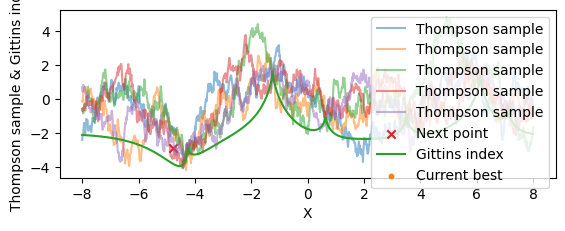

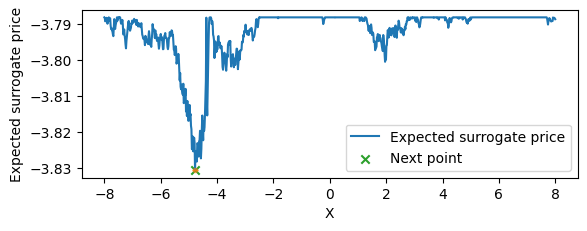

Next point: [-4.780781]

Iteration 8:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.780781]
New value: [-2.1810029]
Objective: [0.85065067]


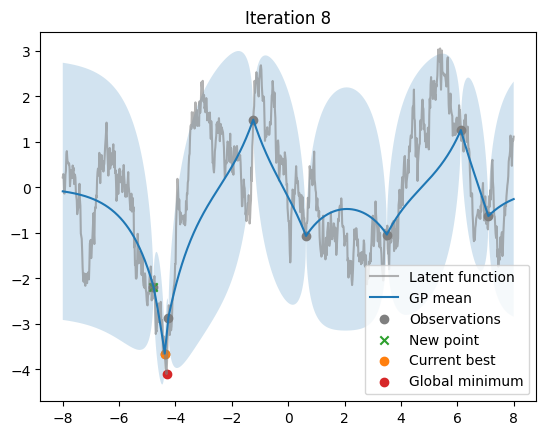


current surrogate price: -3.7108202
optimal new surrogate price: -3.7522743
minimum gittins index: -3.7816162


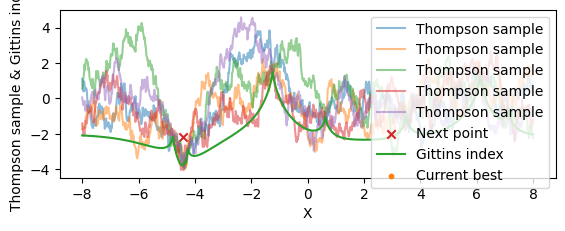

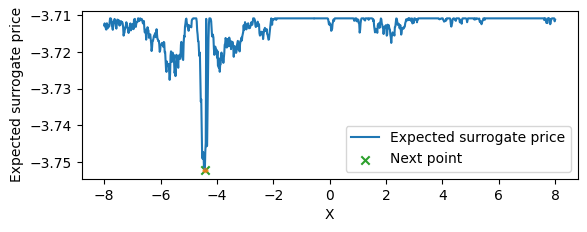

Next point: [-4.4284286]

Iteration 9:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.4284286]
New value: [-3.5792904]
Objective: [0.9006507]


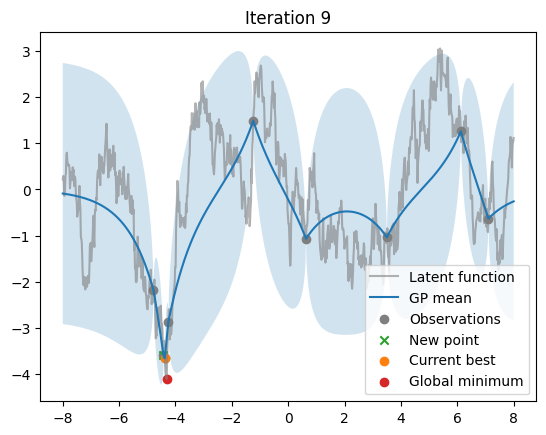


current surrogate price: -3.6821933
optimal new surrogate price: -3.733704
minimum gittins index: -3.703064


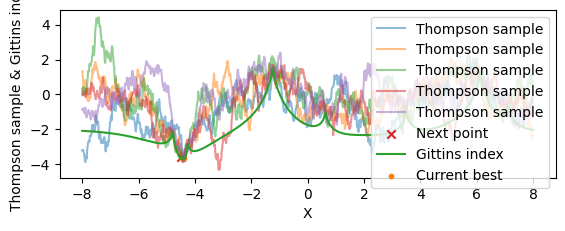

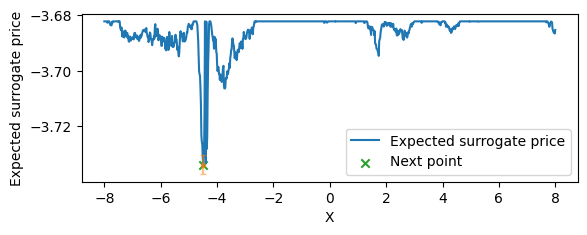

Next point: [-4.4924927]

Iteration 10:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.4924927]
New value: [-3.1205378]
Objective: [0.9506507]


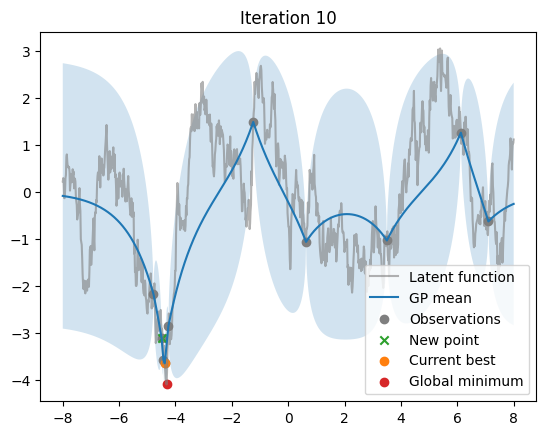


current surrogate price: -3.6780422
optimal new surrogate price: -3.7301826
minimum gittins index: -3.703064


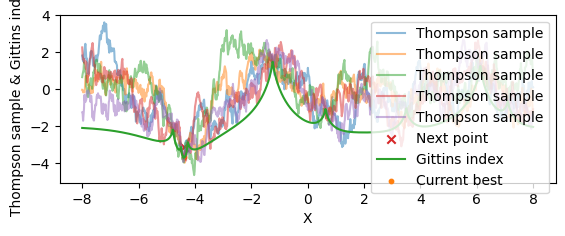

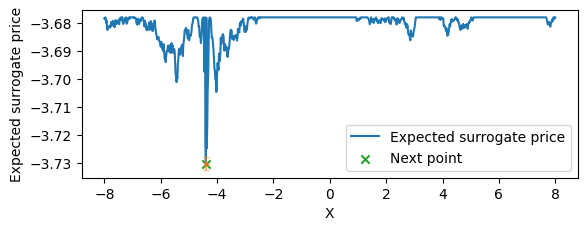

Next point: [-4.3963966]

Iteration 11:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.3963966]
New value: [-3.5229]
Objective: [1.0006506]


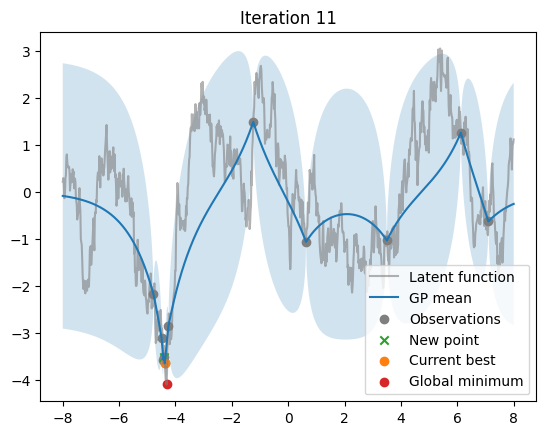


current surrogate price: -3.6543329
optimal new surrogate price: -3.705711
minimum gittins index: -3.6589966


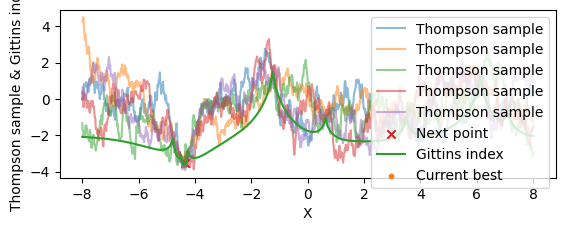

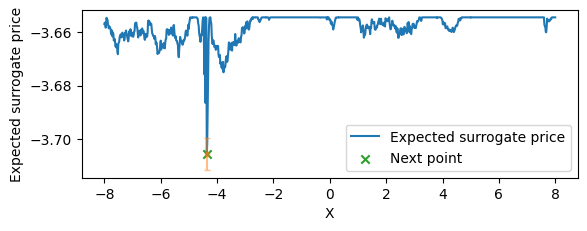

Next point: [-4.3643646]

Iteration 12:
Current best value: [-3.8192153]
Current best point: [-4.3643646]
New point: [-4.3643646]
New value: [-3.8192153]
Objective: [0.883937]


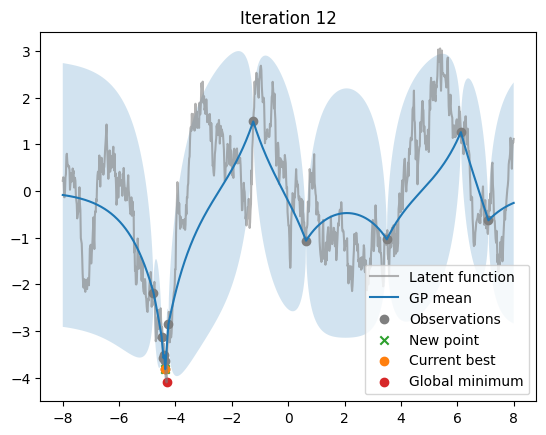


current surrogate price: -3.8185918
optimal new surrogate price: -3.8564153
minimum gittins index: -3.819226


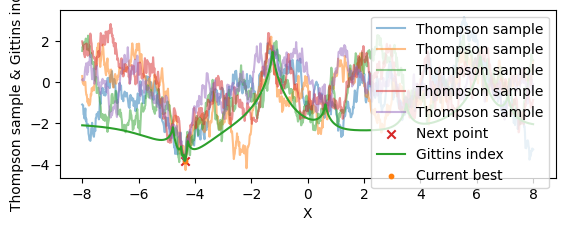

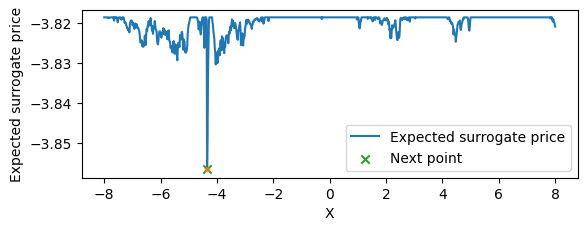

Next point: [-4.3483486]

Iteration 13:
Current best value: [-3.9953647]
Current best point: [-4.3483486]
New point: [-4.3483486]
New value: [-3.9953647]
Objective: [0.7577876]


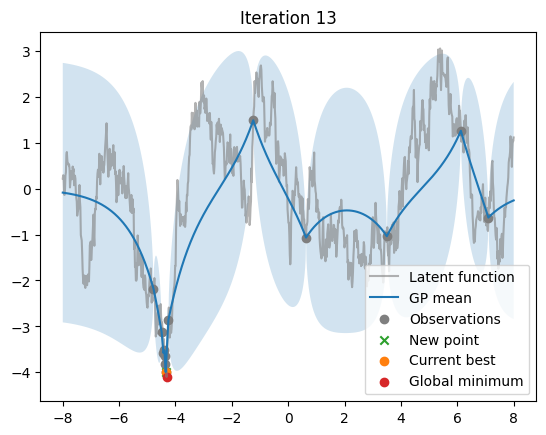


current surrogate price: -3.9948113
optimal new surrogate price: -4.025452
minimum gittins index: -3.9953735


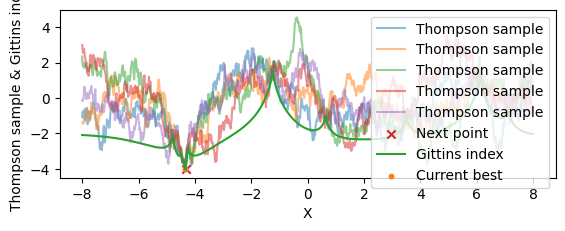

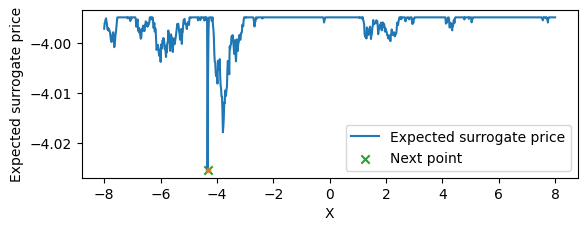

Next point: [-4.3323326]

Iteration 14:
Current best value: [-3.9953647]
Current best point: [-4.3483486]
New point: [-4.3323326]
New value: [-3.9875772]
Objective: [0.8077876]


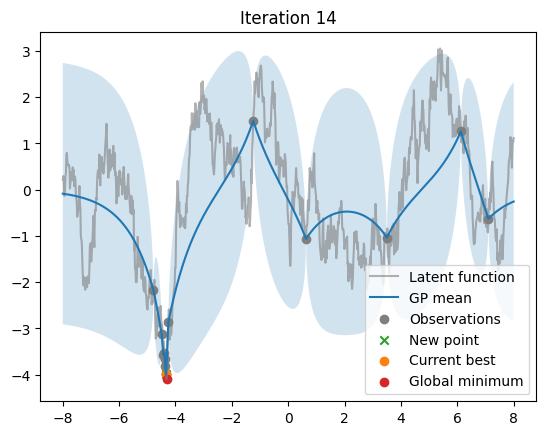


current surrogate price: -3.9947746
optimal new surrogate price: -4.0074368
minimum gittins index: -3.9953735


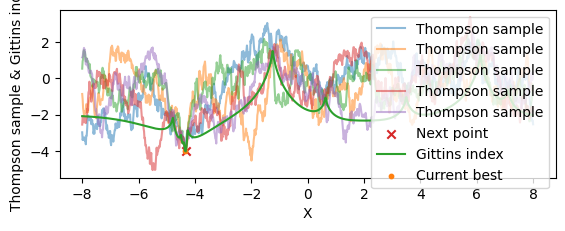

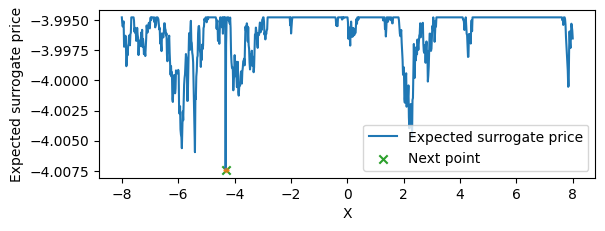

Next point: [-4.3163166]

Iteration 15:
Current best value: [-4.1031523]
Current best point: [-4.3163166]
New point: [-4.3163166]
New value: [-4.1031523]
Objective: [0.75]


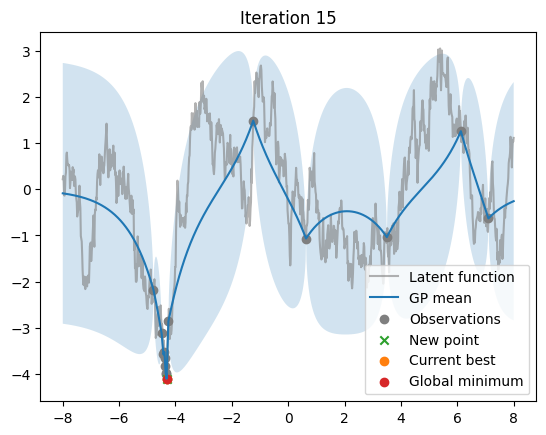


current surrogate price: -4.1025686
optimal new surrogate price: -4.1141124
minimum gittins index: -4.103162


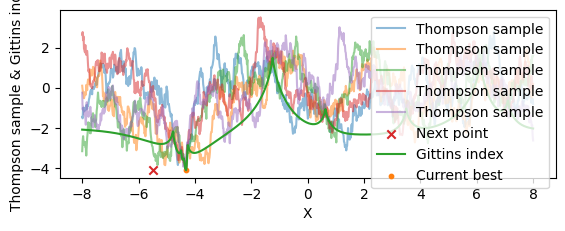

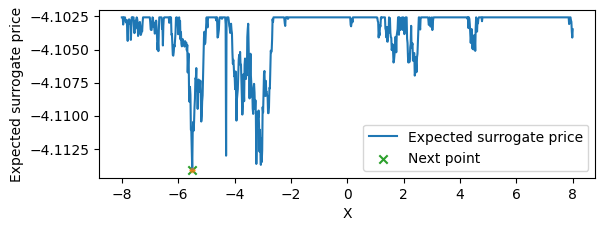

Next point: [-5.501501]

Iteration 16:
Current best value: [-4.1031523]
Current best point: [-4.3163166]
New point: [-5.501501]
New value: [-0.52551895]
Objective: [0.8]


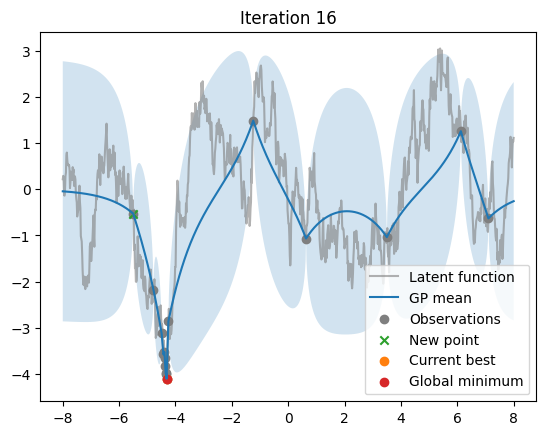


current surrogate price: -4.1026225
optimal new surrogate price: -4.116499
minimum gittins index: -4.103162


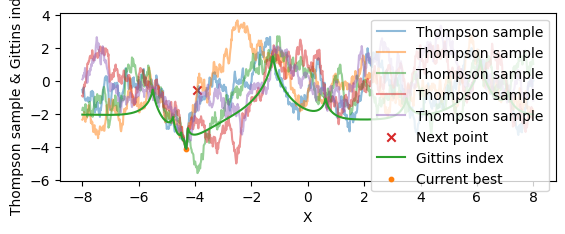

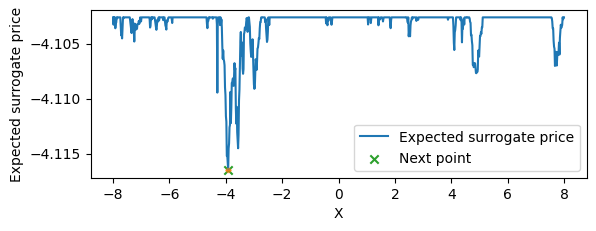

Next point: [-3.9159162]

Stopping time: 12
Objective value: 0.883937
Best observed value: -3.8192153


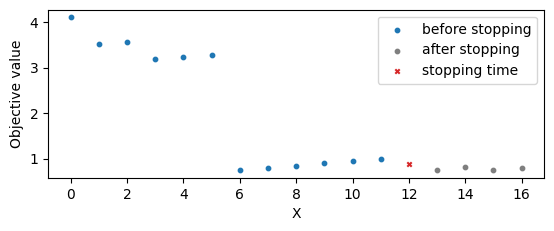

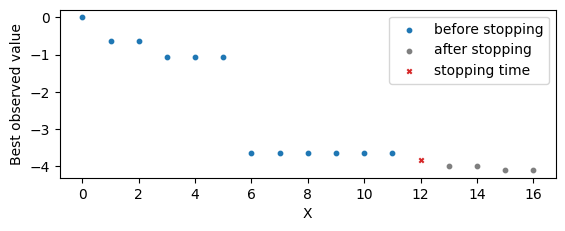

In [184]:
eps = 0.0001
num_samples = 400
# Specifiy policy and kernel hyperparameters
BayesianOptimization(seed=370, policy='Surrogate', num_points=1000, iterations = 16, query_cost = 0.05, kernel = jk.Matern12(), kernel_parameters={"lengthscale": jnp.array([1.0]), "variance": jnp.array([2.0])})

Global minimum point: [7.1511507]
Global minimum value: -10.15494155883789



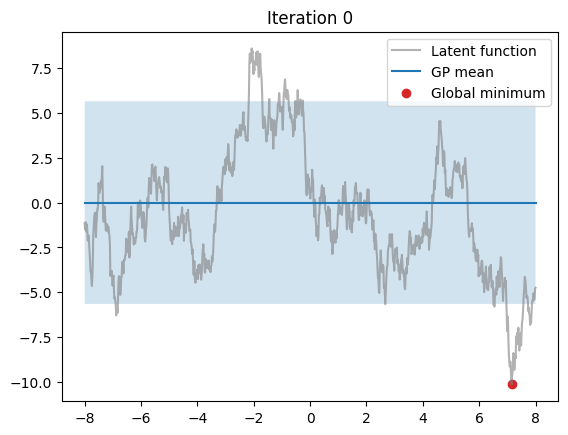

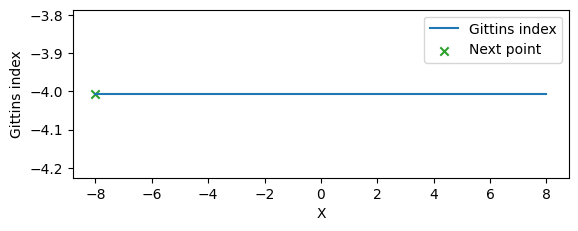

Next point: [-8.]

Iteration 1:
Current best value: [-1.1576277]
Current best point: [-8.]
New point: [-8.]
New value: [-1.1576277]
Objective: [9.097314]


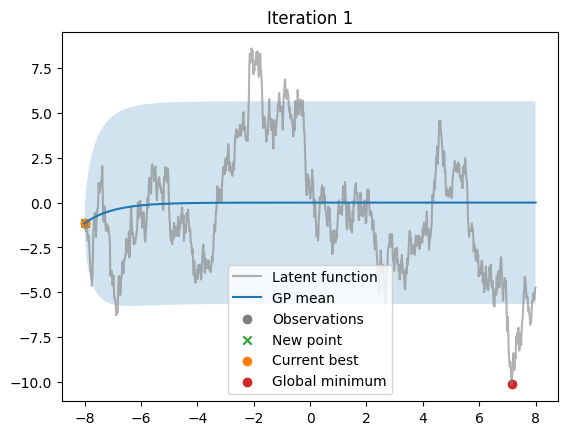

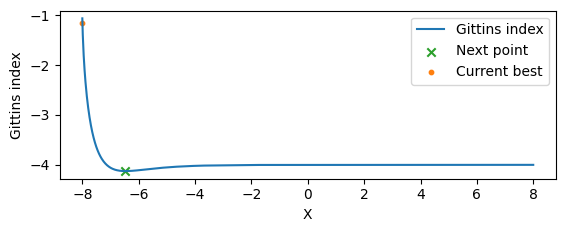

Next point: [-6.4784784]

Iteration 2:
Current best value: [-2.3321552]
Current best point: [-6.4784784]
New point: [-6.4784784]
New value: [-2.3321552]
Objective: [8.022786]


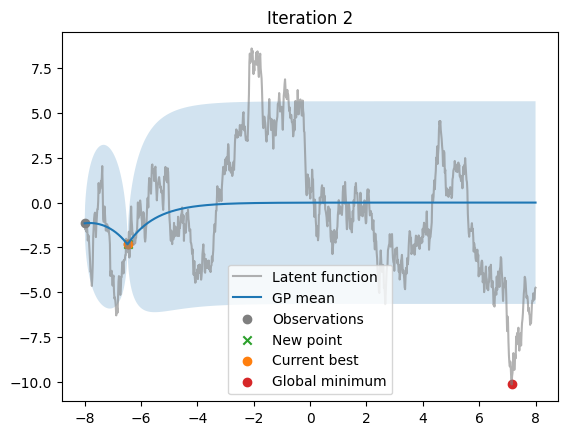

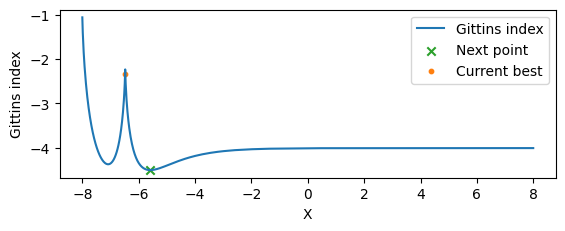

Next point: [-5.581582]

Iteration 3:
Current best value: [-2.3321552]
Current best point: [-6.4784784]
New point: [-5.581582]
New value: [1.6719029]
Objective: [8.1227865]


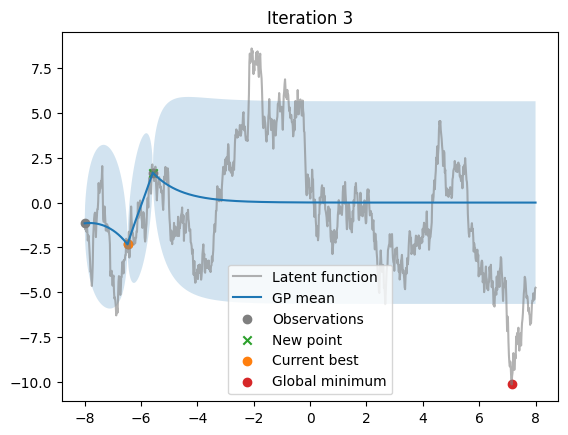

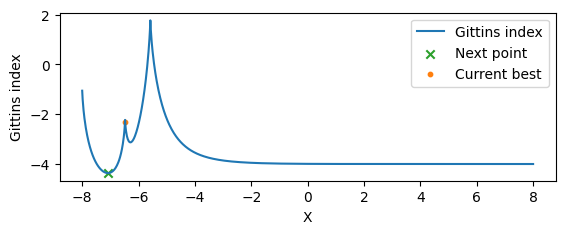

Next point: [-7.0870867]

Iteration 4:
Current best value: [-4.096481]
Current best point: [-7.0870867]
New point: [-7.0870867]
New value: [-4.096481]
Objective: [6.458461]


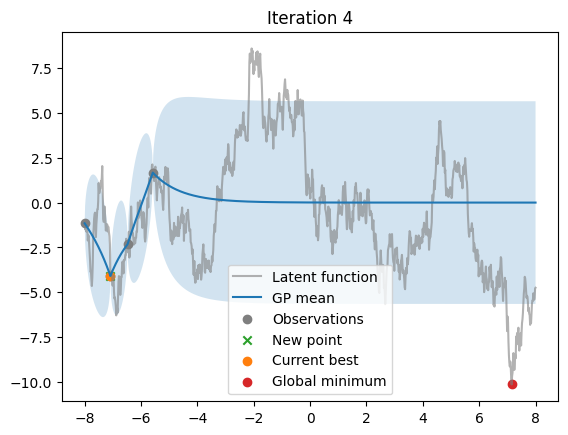

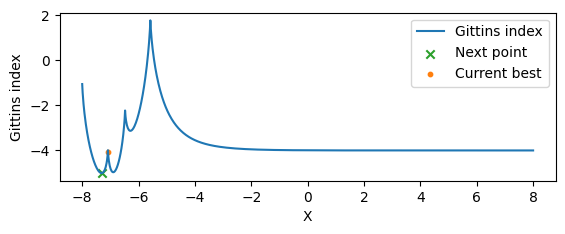

Next point: [-7.3113117]

Iteration 5:
Current best value: [-4.096481]
Current best point: [-7.0870867]
New point: [-7.3113117]
New value: [-1.0551138]
Objective: [6.5584607]


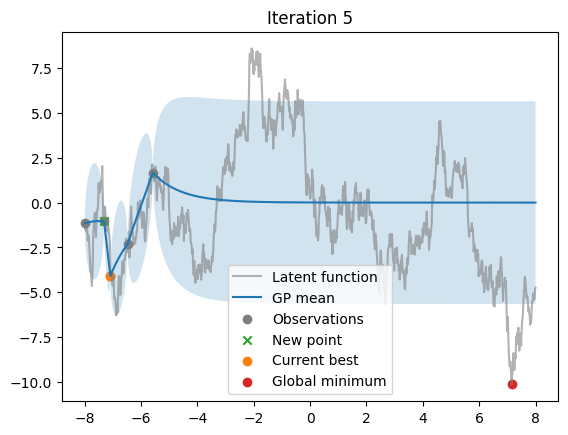

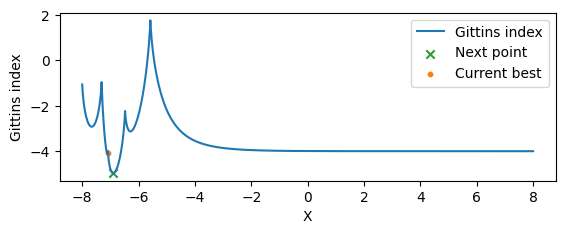

Next point: [-6.8948946]

Iteration 6:
Current best value: [-5.7738895]
Current best point: [-6.8948946]
New point: [-6.8948946]
New value: [-5.7738895]
Objective: [4.981052]


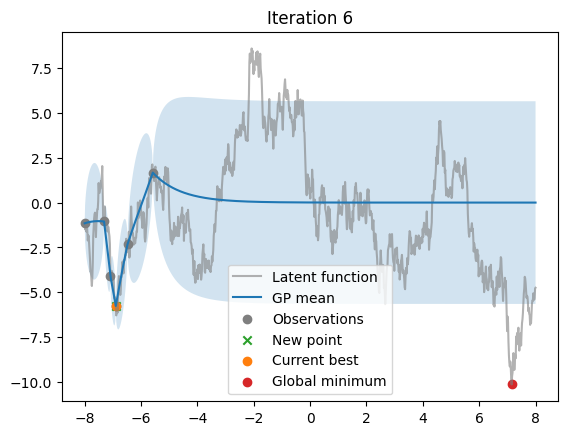

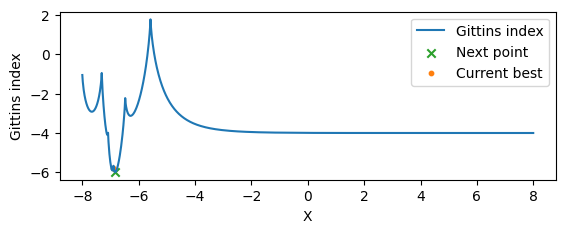

Next point: [-6.8308306]

Iteration 7:
Current best value: [-6.1426764]
Current best point: [-6.8308306]
New point: [-6.8308306]
New value: [-6.1426764]
Objective: [4.712265]


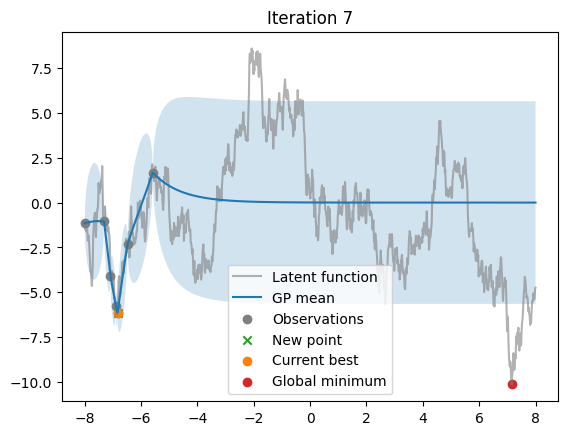

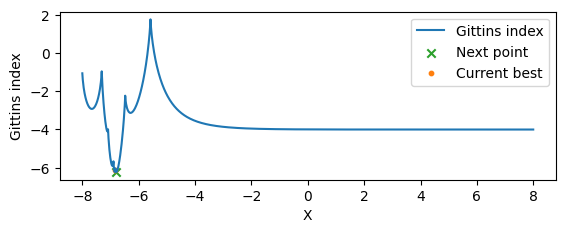

Next point: [-6.7987986]

Iteration 8:
Current best value: [-6.1426764]
Current best point: [-6.8308306]
New point: [-6.7987986]
New value: [-4.422141]
Objective: [4.8122654]


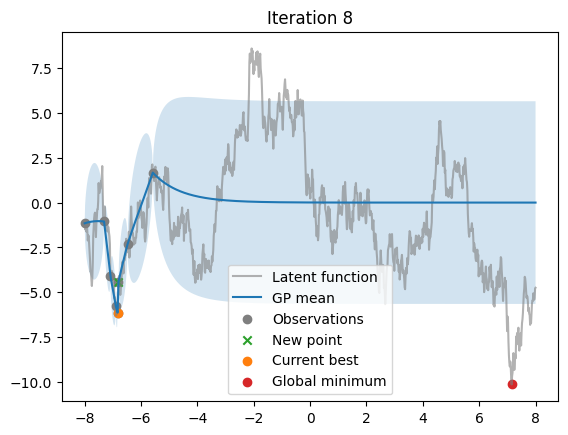

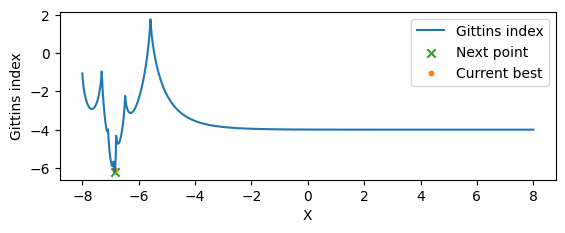

Next point: [-6.8468466]

Iteration 9:
Current best value: [-6.1426764]
Current best point: [-6.8308306]
New point: [-6.8468466]
New value: [-5.876844]
Objective: [4.9122653]


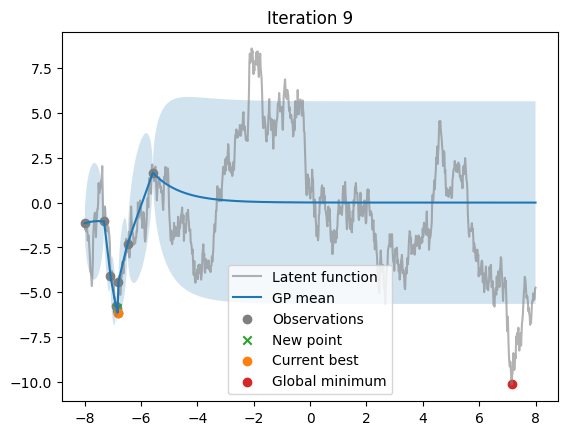

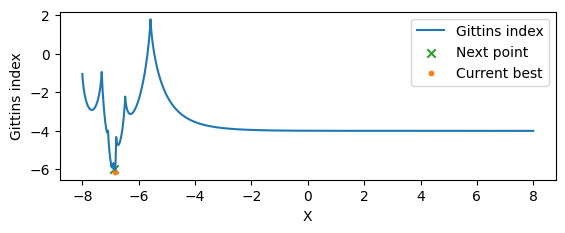

Next point: [-6.8628626]

Iteration 10:
Current best value: [-6.1426764]
Current best point: [-6.8308306]
New point: [-6.8628626]
New value: [-5.853799]
Objective: [5.012265]


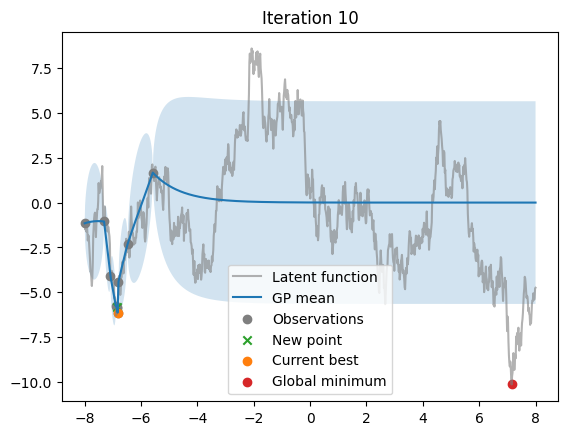

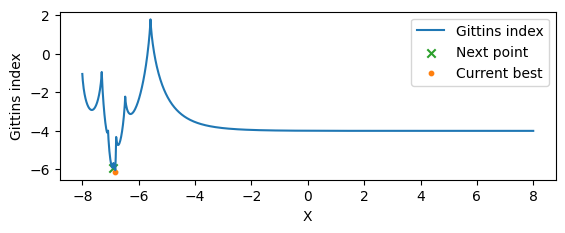

Next point: [-6.9269266]

Iteration 11:
Current best value: [-6.1426764]
Current best point: [-6.8308306]
New point: [-6.9269266]
New value: [-5.291892]
Objective: [5.112265]


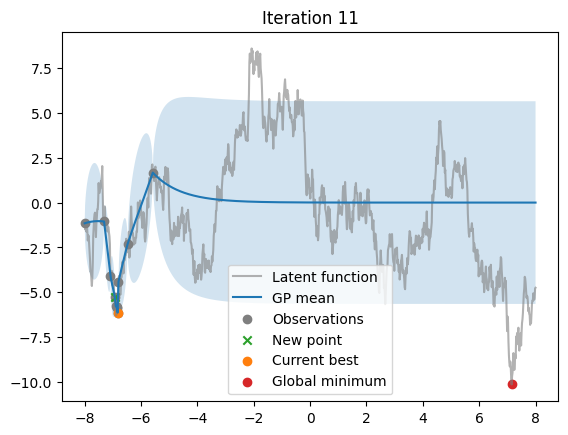

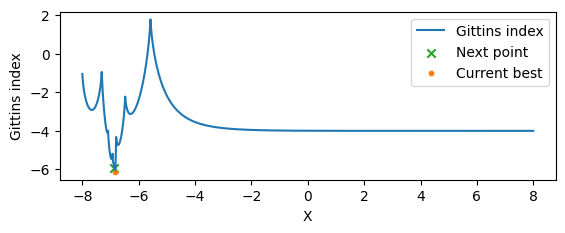

Next point: [-6.8788786]

Iteration 12:
Current best value: [-6.296947]
Current best point: [-6.8788786]
New point: [-6.8788786]
New value: [-6.296947]
Objective: [5.057995]


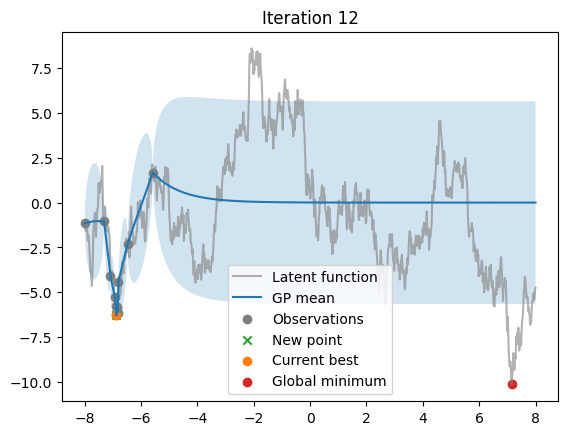

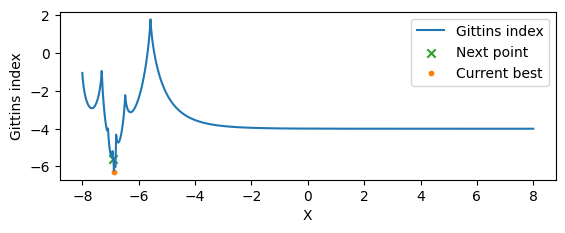

Next point: [-6.9109106]

Iteration 13:
Current best value: [-6.296947]
Current best point: [-6.8788786]
New point: [-6.9109106]
New value: [-5.48717]
Objective: [5.1579943]


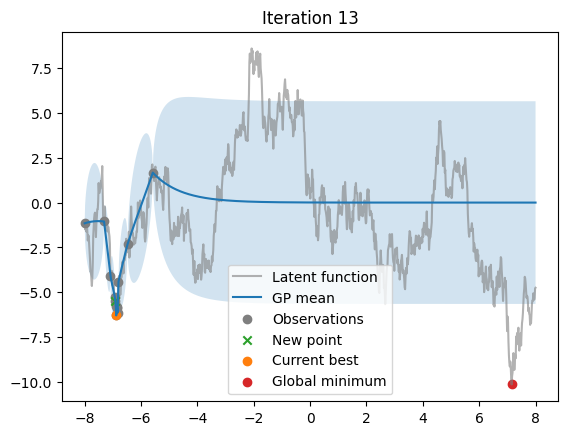

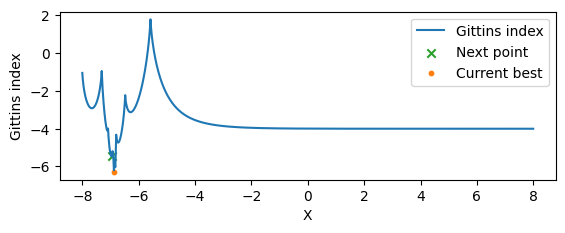

Next point: [-6.9589586]

Iteration 14:
Current best value: [-6.296947]
Current best point: [-6.8788786]
New point: [-6.9589586]
New value: [-4.9612107]
Objective: [5.2579947]


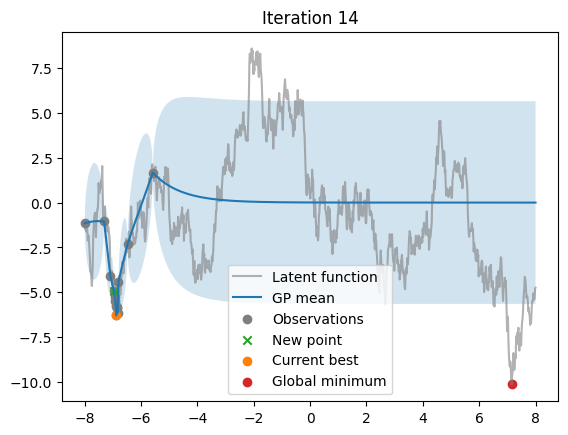

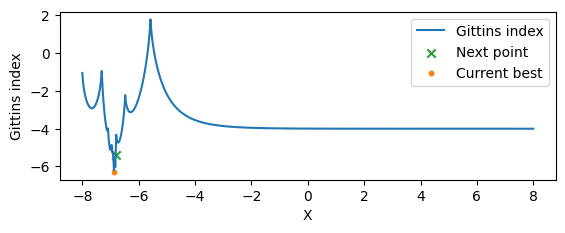

Next point: [-6.8148146]

Iteration 15:
Current best value: [-6.296947]
Current best point: [-6.8788786]
New point: [-6.8148146]
New value: [-5.193089]
Objective: [5.3579946]


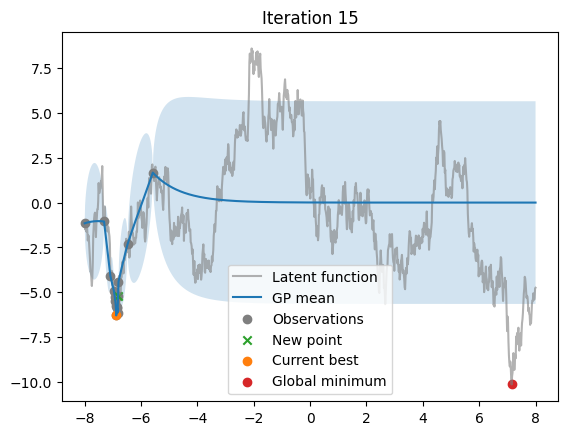

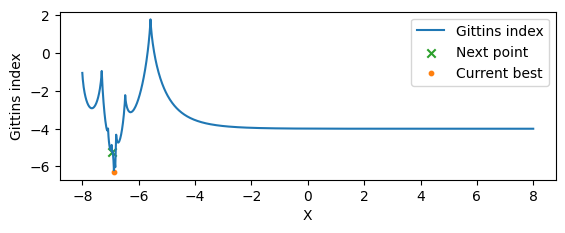

Next point: [-6.9429426]

Stopping time: 9
Objective value: 4.9122653
Best observed value: -6.1426764


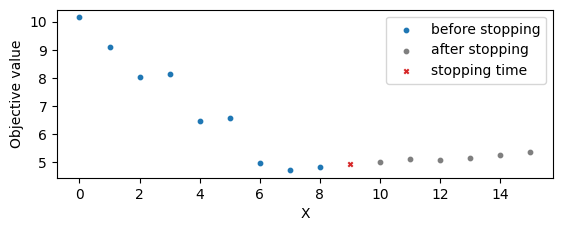

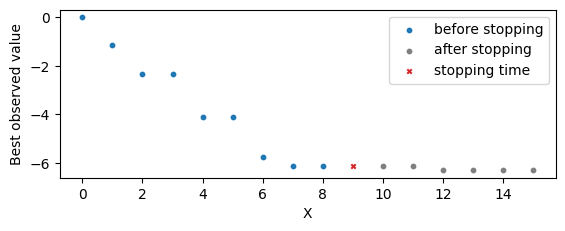

In [153]:
# Define the search space
bounds = jnp.array([[-8, 8]])
# Define the tolerance parameter
eps = 0.0001
# Specifiy policy and kernel hyperparameters
BayesianOptimization(seed=168, policy='Gittins', num_points=1000, iterations = 15, query_cost = 0.1, kernel = jk.Matern12(), kernel_parameters={"lengthscale": jnp.array([1.0]), "variance": jnp.array([8.0])})

Global minimum point: [-4.3163166]
Global minimum value: -4.103152275085449



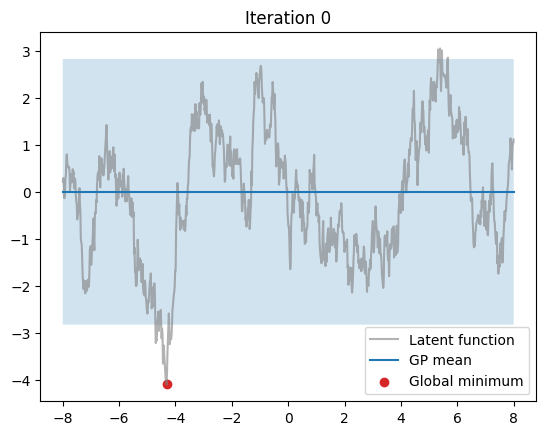

expected current surrogate price: -2.0008657
optimal new expected surrogate price: -2.0798616
minimum gittins index: -2.0039062


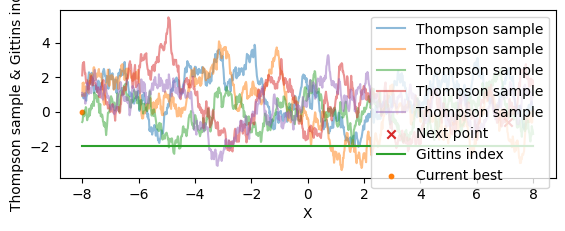

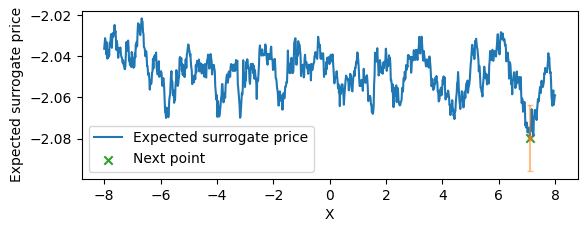

Next point: [7.1031027]

Iteration 1:
Current best value: [-0.63051665]
Current best point: [7.1031027]
New point: [7.1031027]
New value: [-0.63051665]
Objective: [3.5226357]


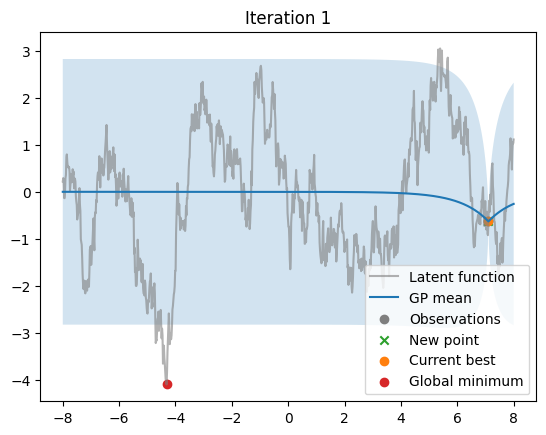

expected current surrogate price: -2.0268784
optimal new expected surrogate price: -2.1049137
minimum gittins index: -2.0777588


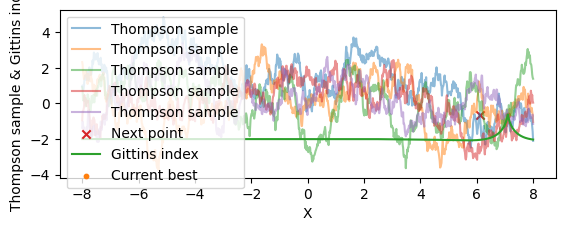

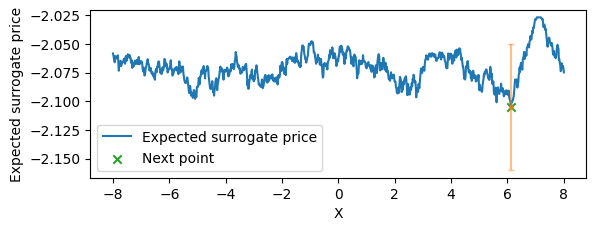

Next point: [6.1261263]

Iteration 2:
Current best value: [-0.63051665]
Current best point: [7.1031027]
New point: [6.1261263]
New value: [1.2594988]
Objective: [3.5726357]


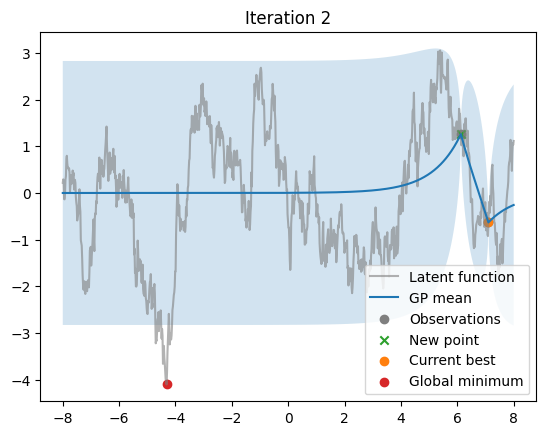

expected current surrogate price: -1.9823854
optimal new expected surrogate price: -2.0716991
minimum gittins index: -2.032837


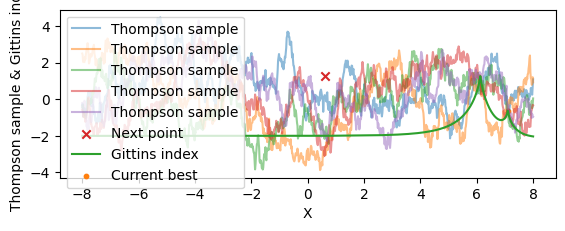

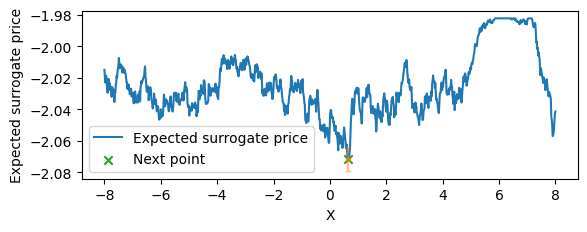

Next point: [0.6326325]

Iteration 3:
Current best value: [-1.0667229]
Current best point: [0.6326325]
New point: [0.6326325]
New value: [-1.0667229]
Objective: [3.1864295]


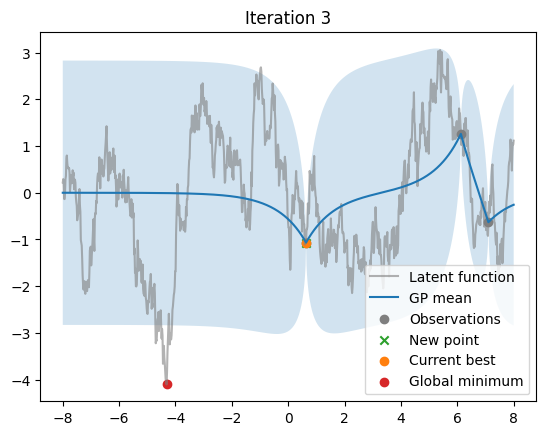

expected current surrogate price: -2.1287715
optimal new expected surrogate price: -2.2079206
minimum gittins index: -2.2120361


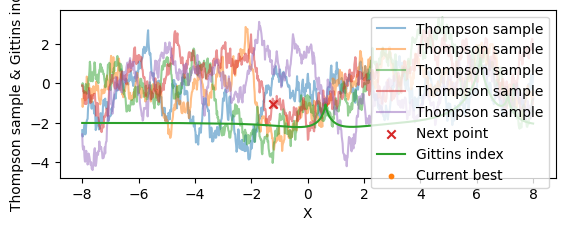

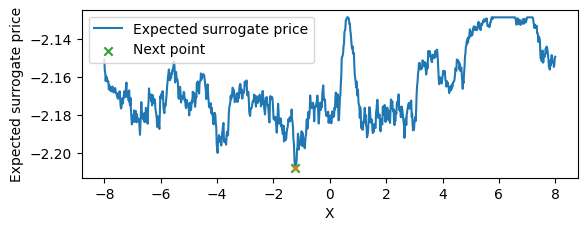

Next point: [-1.2412415]

Iteration 4:
Current best value: [-1.0667229]
Current best point: [0.6326325]
New point: [-1.2412415]
New value: [1.4885166]
Objective: [3.2364295]


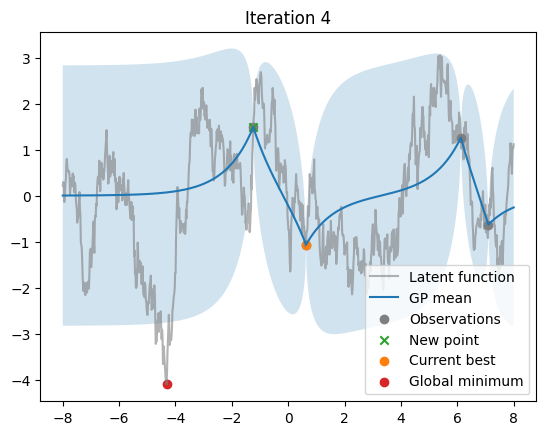

expected current surrogate price: -2.0509074
optimal new expected surrogate price: -2.1104007
minimum gittins index: -2.2003174


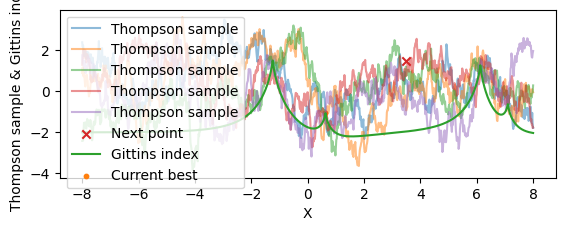

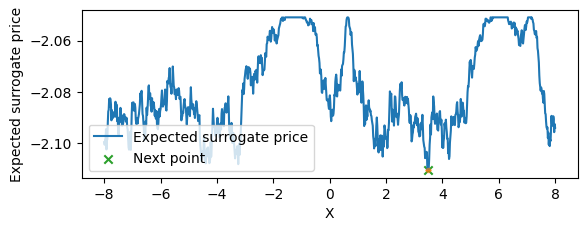

Next point: [3.4994993]

Iteration 5:
Current best value: [-1.0667229]
Current best point: [0.6326325]
New point: [3.4994993]
New value: [-1.0368874]
Objective: [3.2864294]


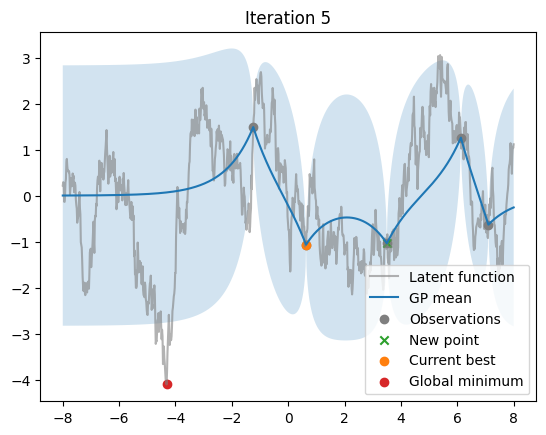

expected current surrogate price: -2.1494915
optimal new expected surrogate price: -2.219521
minimum gittins index: -2.3326416


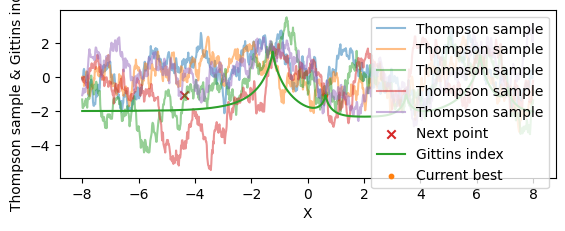

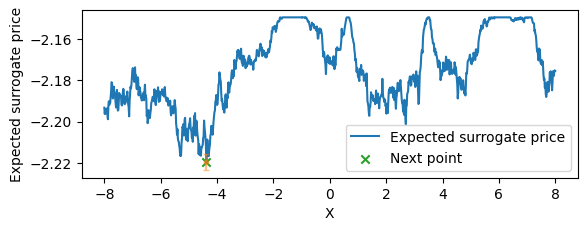

Next point: [-4.3803806]

Iteration 6:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.3803806]
New value: [-3.6525016]
Objective: [0.7506507]


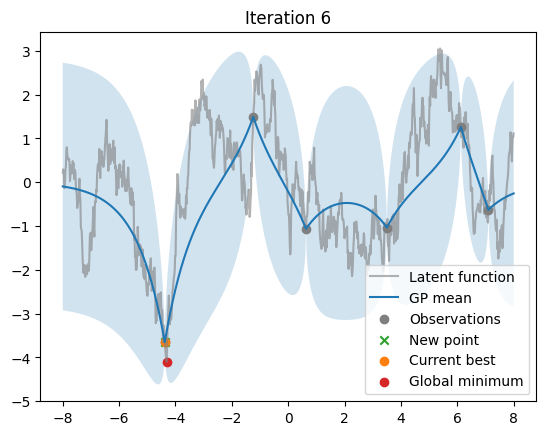

expected current surrogate price: -3.849287
optimal new expected surrogate price: -3.9100766
minimum gittins index: -3.932251


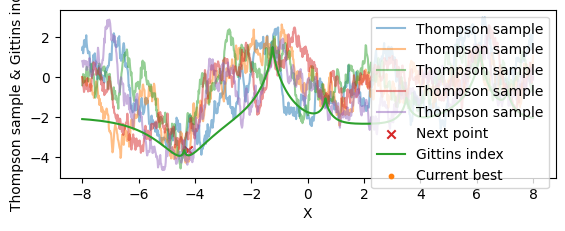

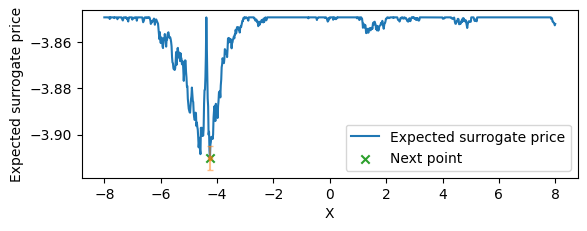

Next point: [-4.2522526]

Iteration 7:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.2522526]
New value: [-2.862173]
Objective: [0.8006507]


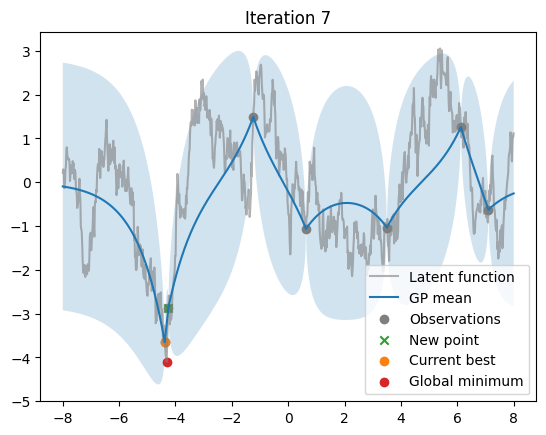

expected current surrogate price: -3.7882135
optimal new expected surrogate price: -3.8304431
minimum gittins index: -3.932251


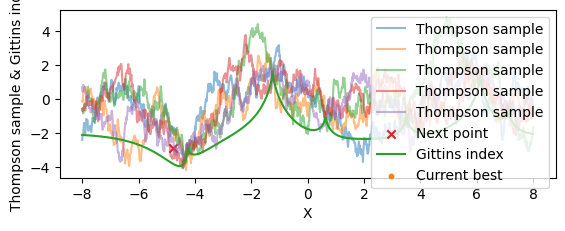

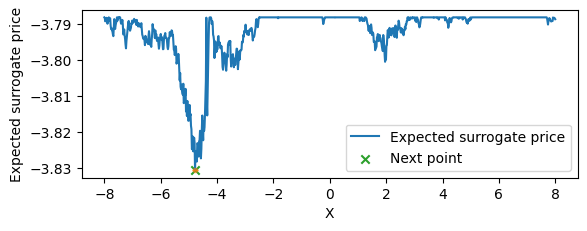

Next point: [-4.780781]

Iteration 8:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.780781]
New value: [-2.1810029]
Objective: [0.85065067]


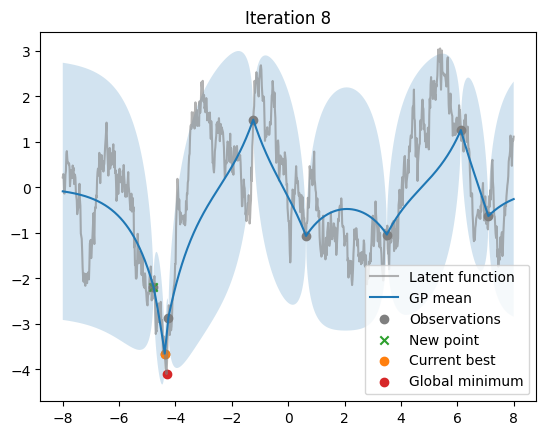

expected current surrogate price: -3.7108202
optimal new expected surrogate price: -3.7522743
minimum gittins index: -3.7816162


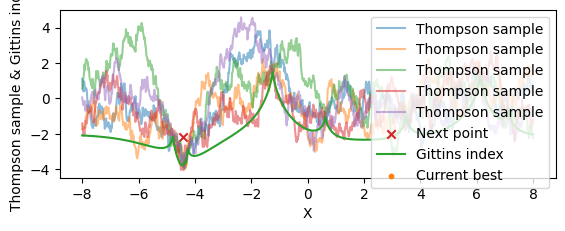

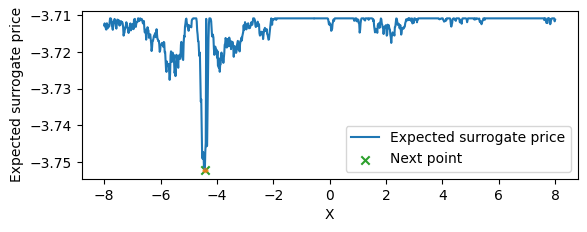

Next point: [-4.4284286]

Iteration 9:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.4284286]
New value: [-3.5792904]
Objective: [0.9006507]


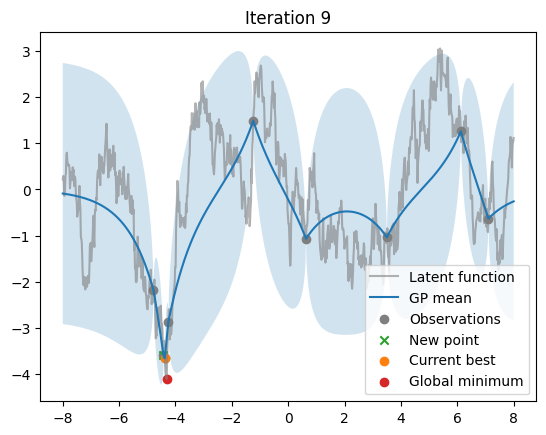

expected current surrogate price: -3.6821933
optimal new expected surrogate price: -3.733704
minimum gittins index: -3.703064


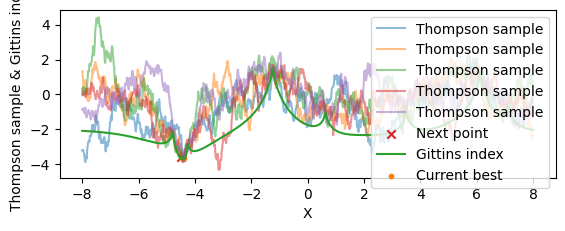

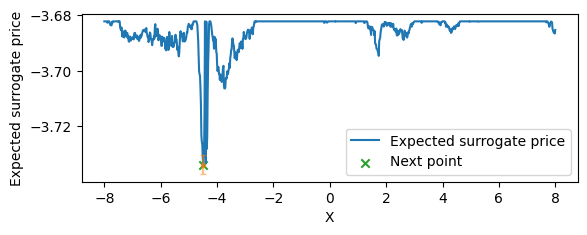

Next point: [-4.4924927]

Iteration 10:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.4924927]
New value: [-3.1205378]
Objective: [0.9506507]


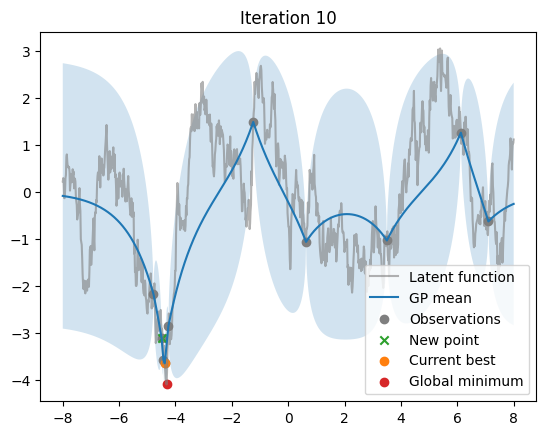

expected current surrogate price: -3.6780422
optimal new expected surrogate price: -3.7301826
minimum gittins index: -3.703064


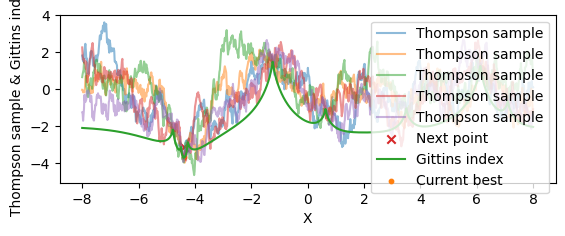

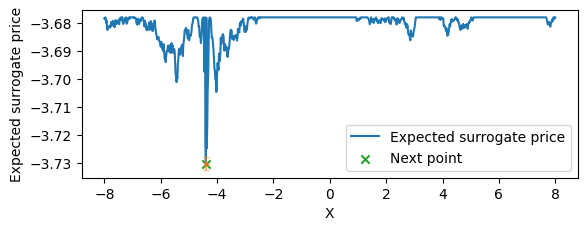

Next point: [-4.3963966]

Iteration 11:
Current best value: [-3.6525016]
Current best point: [-4.3803806]
New point: [-4.3963966]
New value: [-3.5229]
Objective: [1.0006506]


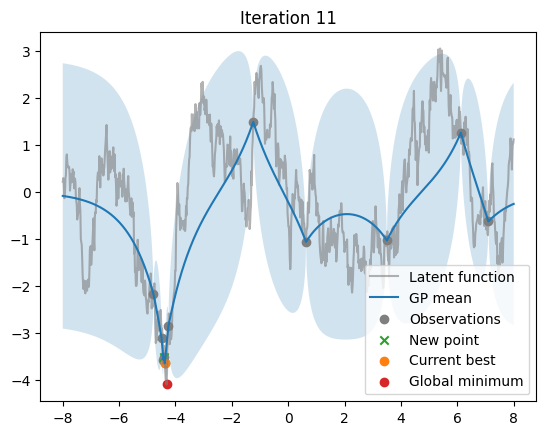

expected current surrogate price: -3.6543329
optimal new expected surrogate price: -3.705711
minimum gittins index: -3.6589966


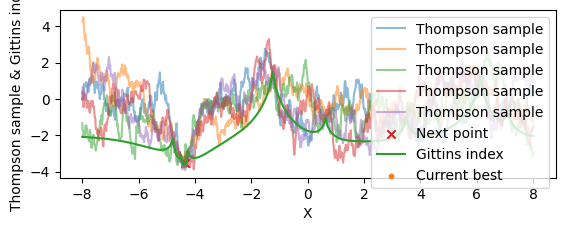

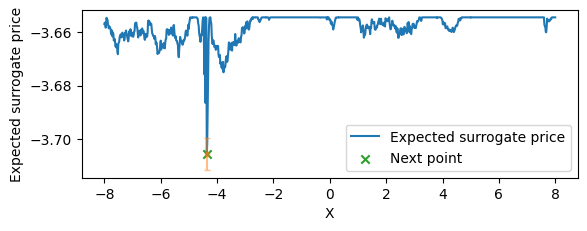

Next point: [-4.3643646]

Iteration 12:
Current best value: [-3.8192153]
Current best point: [-4.3643646]
New point: [-4.3643646]
New value: [-3.8192153]
Objective: [0.883937]


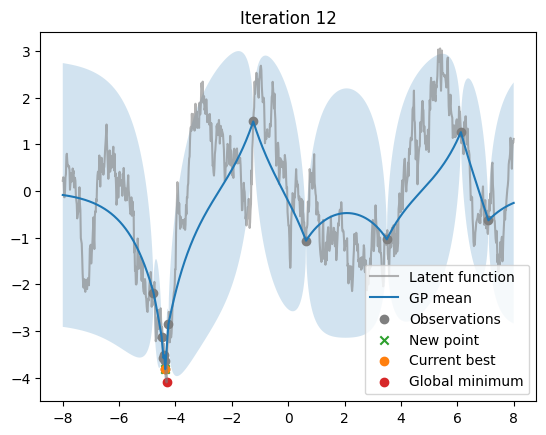

expected current surrogate price: -3.8185918
optimal new expected surrogate price: -3.8564153
minimum gittins index: -3.819226


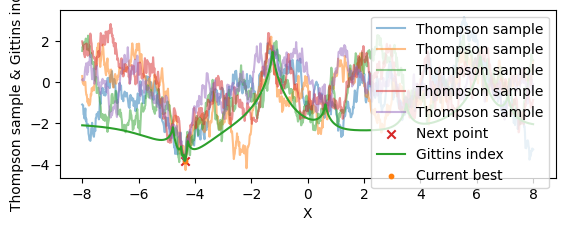

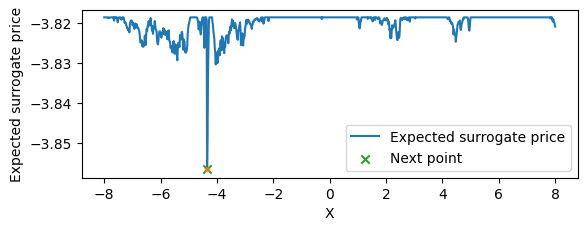

Next point: [-4.3483486]

Iteration 13:
Current best value: [-3.9953647]
Current best point: [-4.3483486]
New point: [-4.3483486]
New value: [-3.9953647]
Objective: [0.7577876]


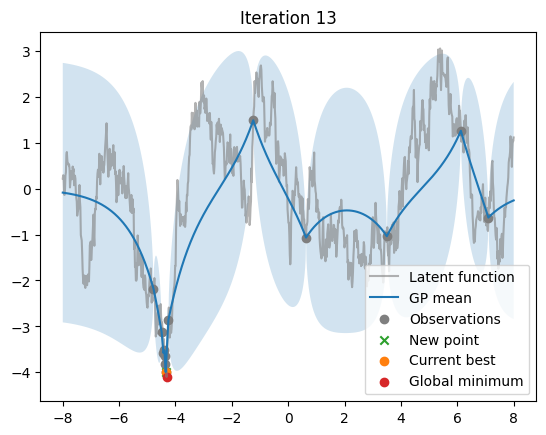

expected current surrogate price: -3.9948113
optimal new expected surrogate price: -4.025452
minimum gittins index: -3.9953735


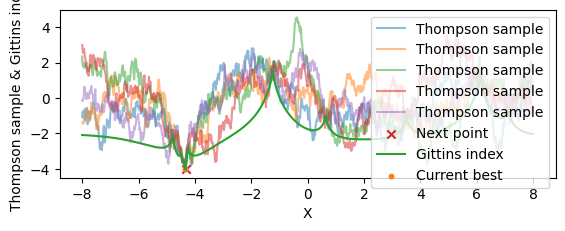

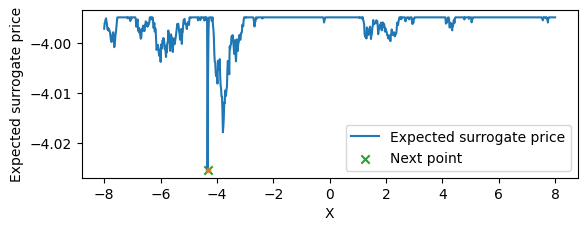

Next point: [-4.3323326]

Iteration 14:
Current best value: [-3.9953647]
Current best point: [-4.3483486]
New point: [-4.3323326]
New value: [-3.9875772]
Objective: [0.8077876]


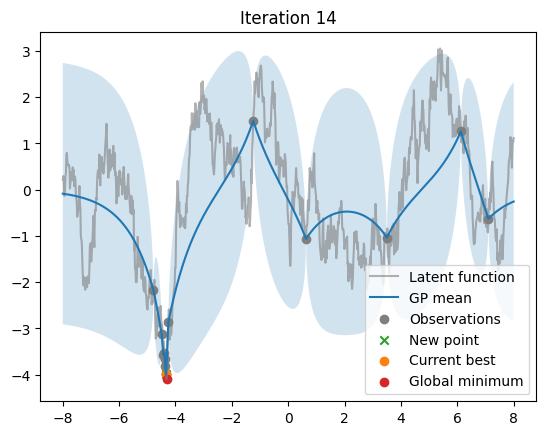

expected current surrogate price: -3.9947746
optimal new expected surrogate price: -4.0074368
minimum gittins index: -3.9953735


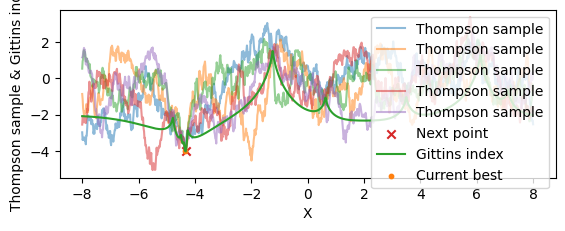

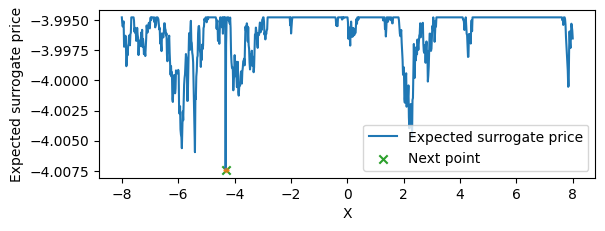

Next point: [-4.3163166]

Iteration 15:
Current best value: [-4.1031523]
Current best point: [-4.3163166]
New point: [-4.3163166]
New value: [-4.1031523]
Objective: [0.75]


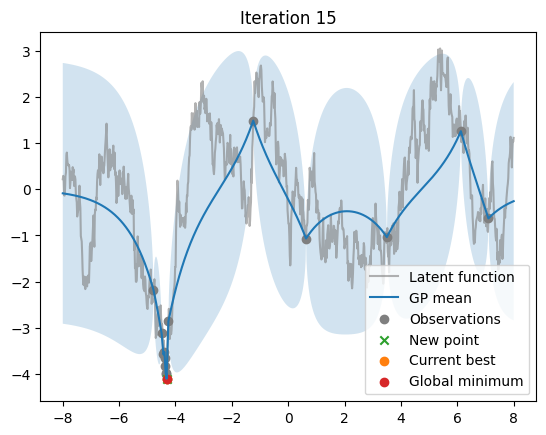

expected current surrogate price: -4.1025686
optimal new expected surrogate price: -4.1141124
minimum gittins index: -4.103162


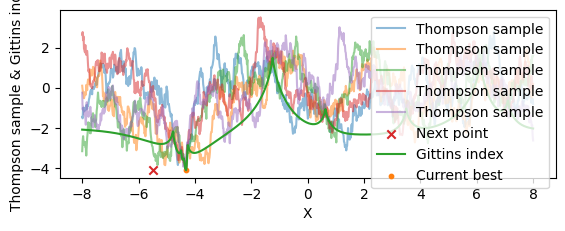

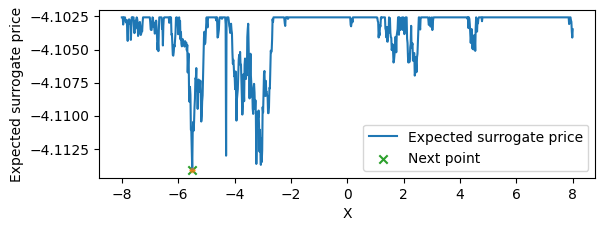

Next point: [-5.501501]

Iteration 16:
Current best value: [-4.1031523]
Current best point: [-4.3163166]
New point: [-5.501501]
New value: [-0.52551895]
Objective: [0.8]


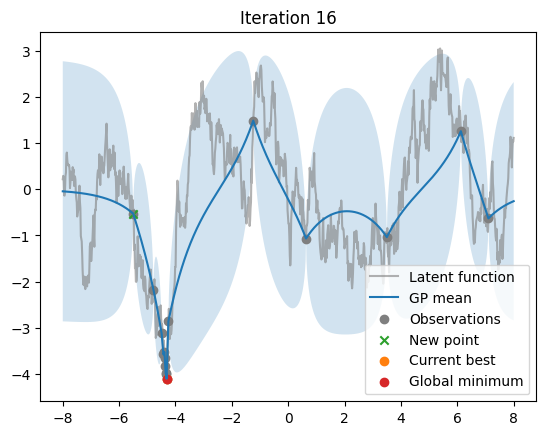

expected current surrogate price: -4.1026225
optimal new expected surrogate price: -4.116499
minimum gittins index: -4.103162


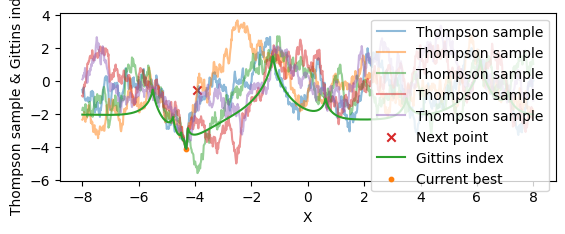

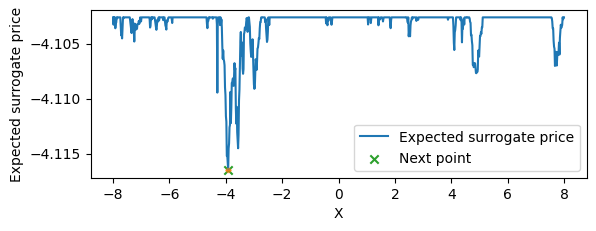

Next point: [-3.9159162]

Stopping time: 12
Objective value: 0.883937
Best observed value: -3.8192153


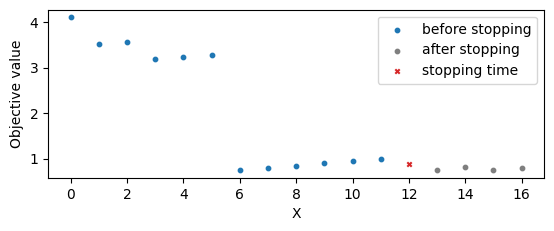

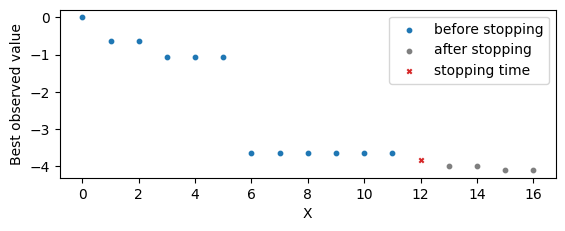

In [114]:
eps = 0.0001
num_samples = 400
# Specifiy policy and kernel hyperparameters
BayesianOptimization(seed=370, policy='Surrogate', num_points=1000, iterations = 16, query_cost = 0.05, kernel = jk.Matern12(), kernel_parameters={"lengthscale": jnp.array([1.0]), "variance": jnp.array([2.0])})

Global minimum point: [0.21621609]
Global minimum value: -4.010265350341797



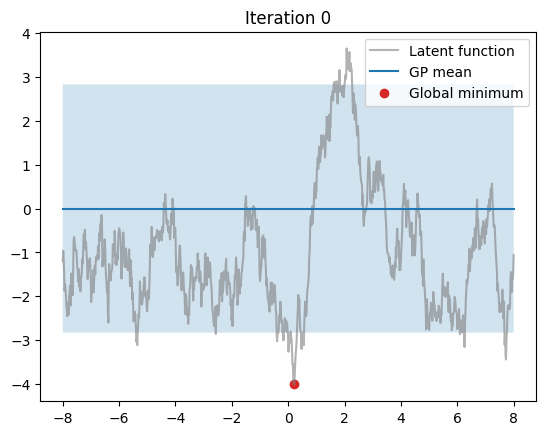

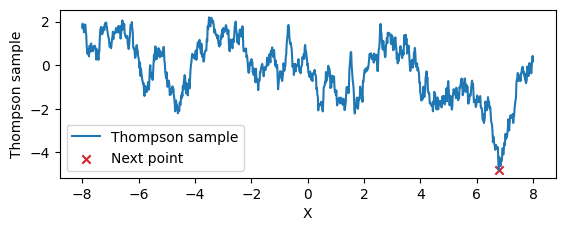

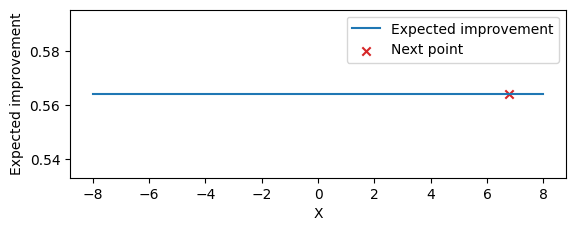

Next point: [6.7827826]

Iteration 1:
Current best value: [-0.92736995]
Current best point: [6.7827826]
New point: [6.7827826]
New value: [-0.92736995]
Objective: [3.1328952]


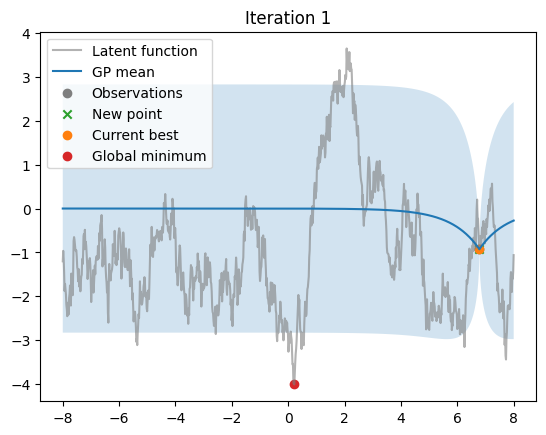

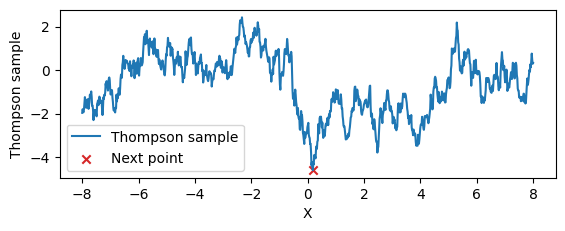

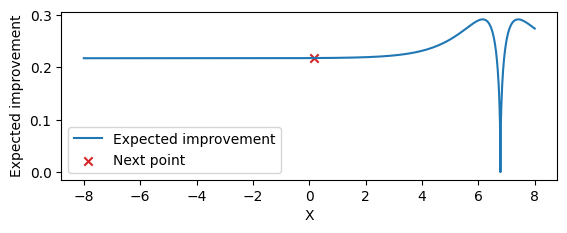

Next point: [0.18418407]

Iteration 2:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [0.18418407]
New value: [-3.9639664]
Objective: [0.14629897]


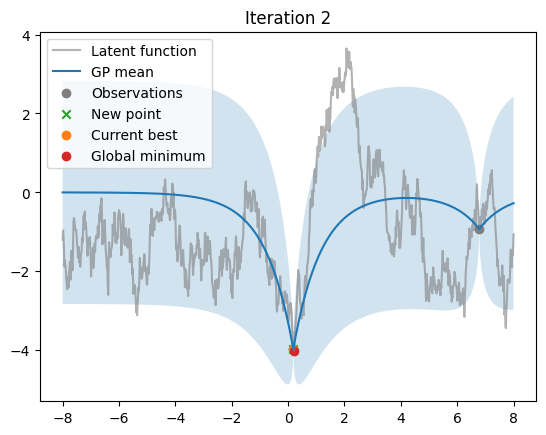

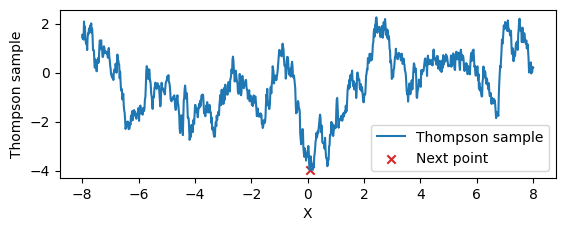

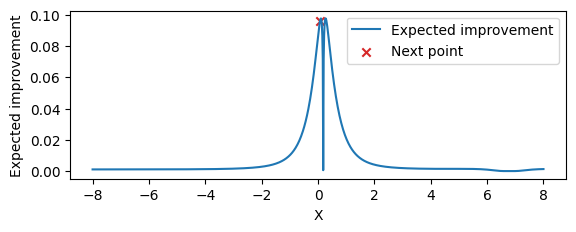

Next point: [0.07207203]

Iteration 3:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [0.07207203]
New value: [-3.0548527]
Objective: [0.19629899]


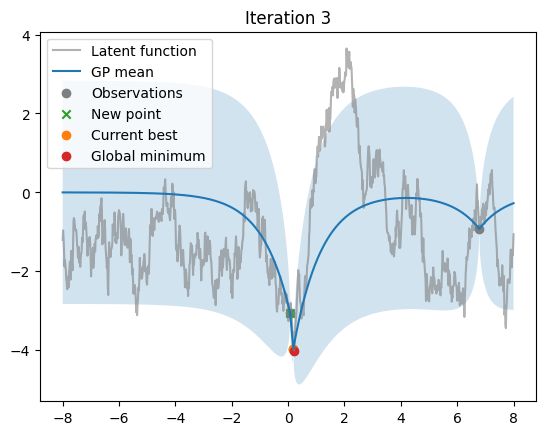

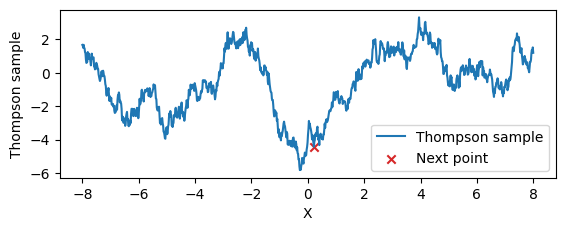

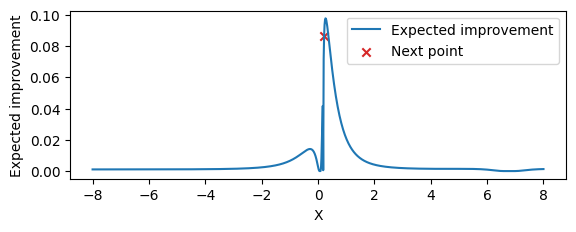

Next point: [0.21621609]

Iteration 4:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.21621609]
New value: [-4.0102654]
Objective: [0.2]


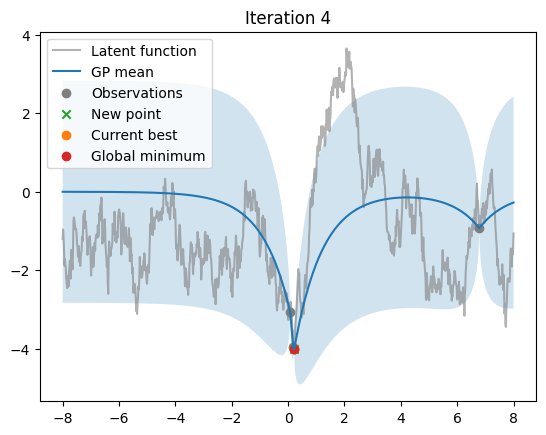

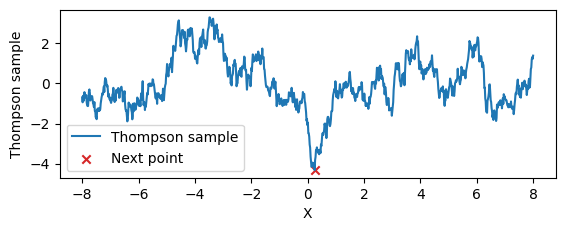

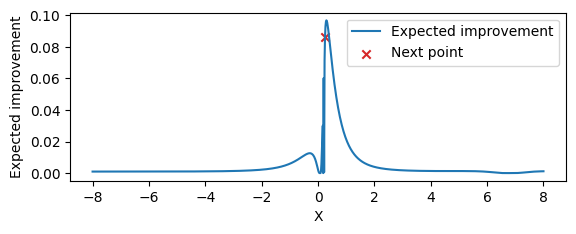

Next point: [0.2482481]

Iteration 5:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.2482481]
New value: [-3.5178592]
Objective: [0.25]


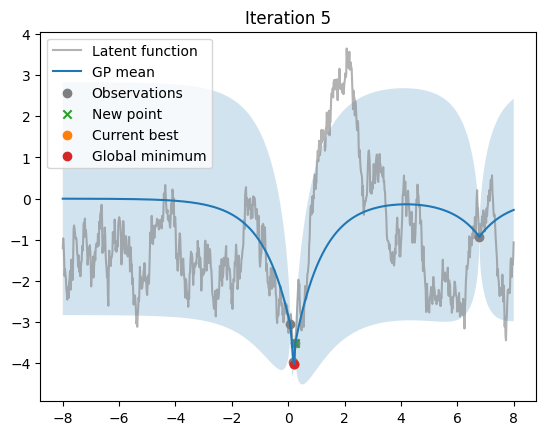

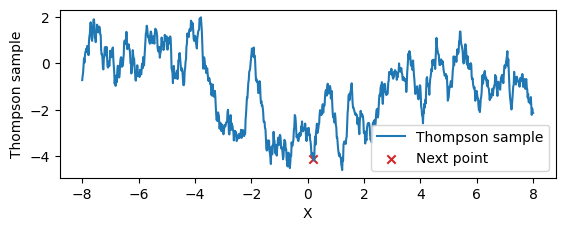

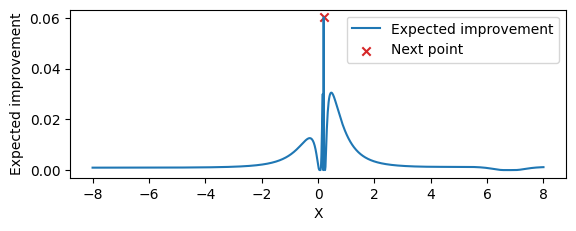

Next point: [0.20020008]

Iteration 6:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.20020008]
New value: [-3.9983726]
Objective: [0.3]


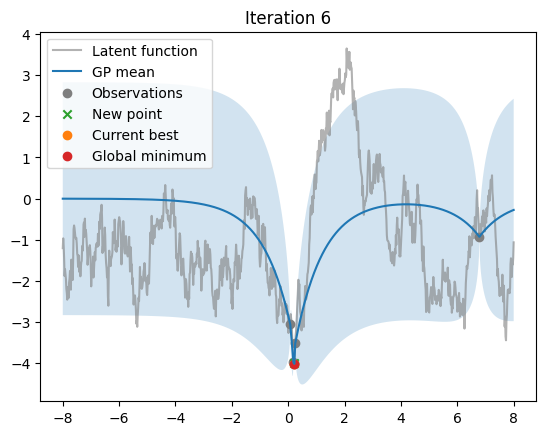

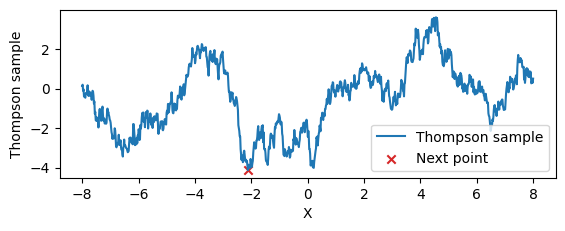

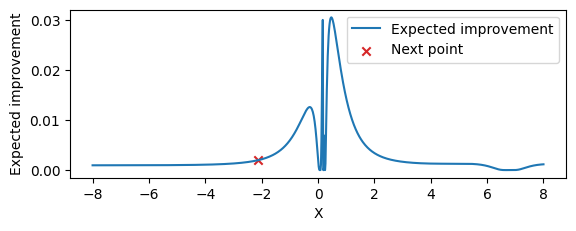

Next point: [-2.122122]

Iteration 7:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [-2.122122]
New value: [-1.6342604]
Objective: [0.35]


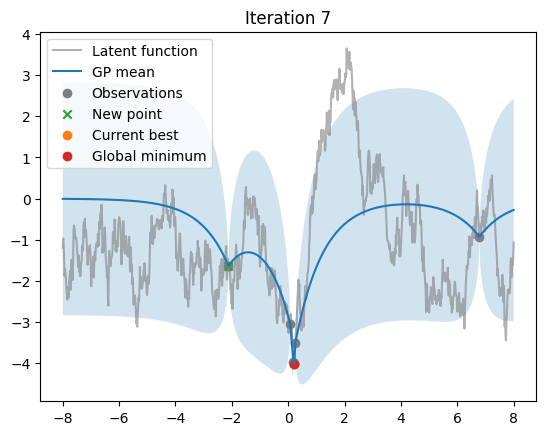

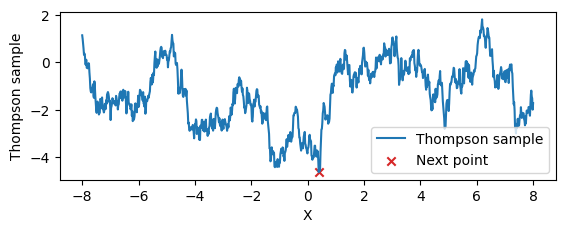

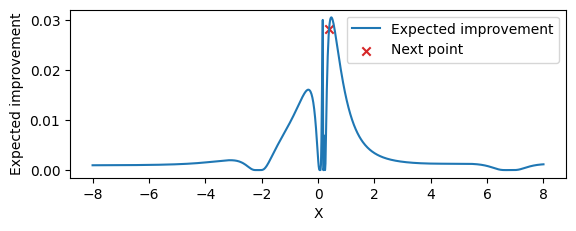

Next point: [0.39239216]

Iteration 8:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.39239216]
New value: [-2.0739007]
Objective: [0.4]


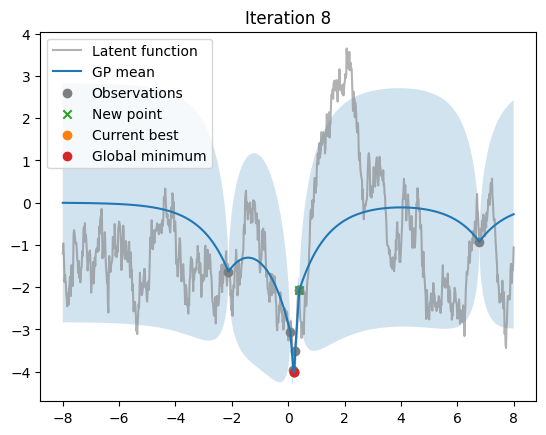

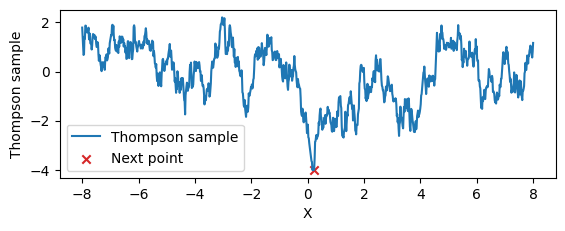

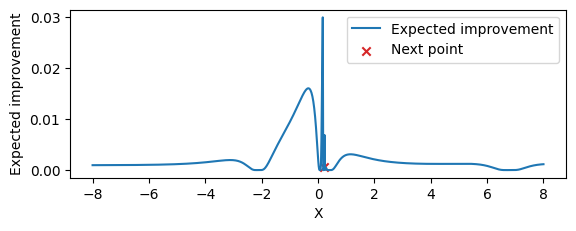

Next point: [0.21621609]

Iteration 9:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.21621609]
New value: [-4.0102654]
Objective: [0.45]


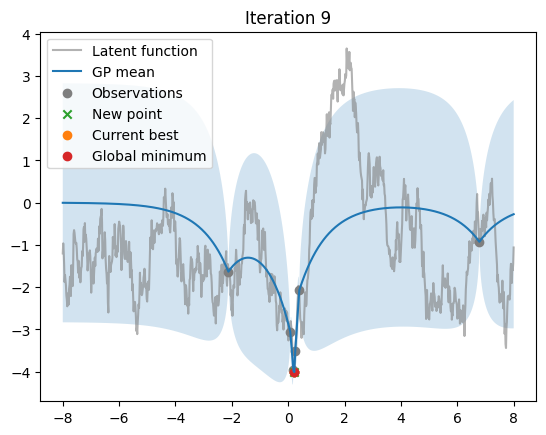

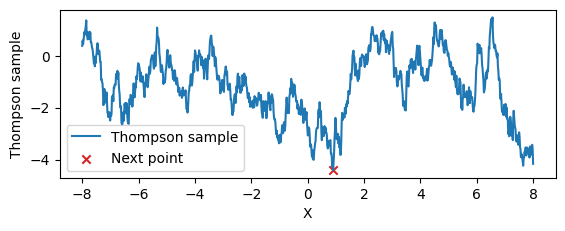

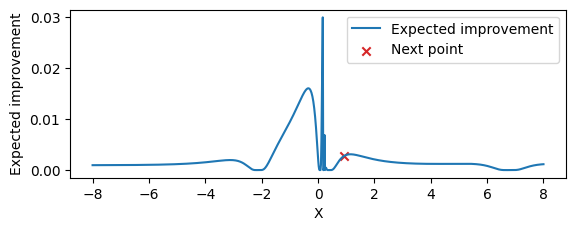

Next point: [0.9049046]

Iteration 10:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.9049046]
New value: [0.00868106]
Objective: [0.5]


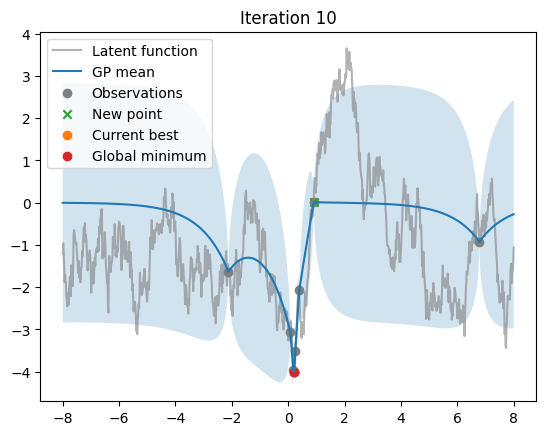

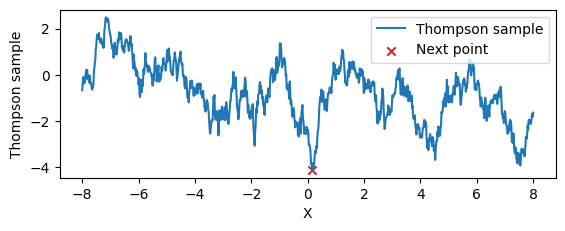

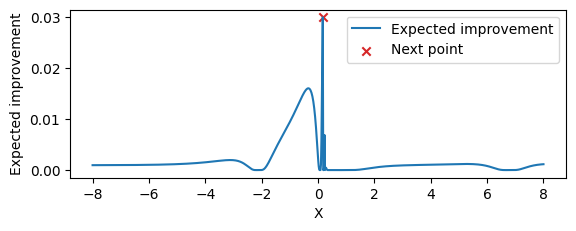

Next point: [0.16816807]

Iteration 11:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.16816807]
New value: [-3.5387454]
Objective: [0.55]


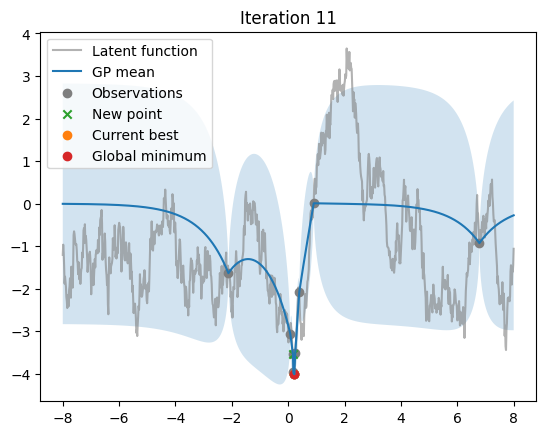

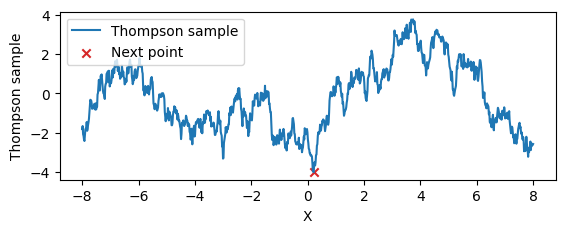

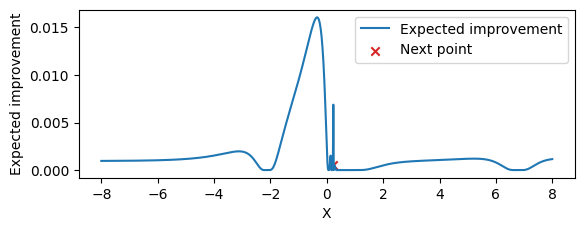

Next point: [0.21621609]

Iteration 12:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.21621609]
New value: [-4.0102654]
Objective: [0.6]


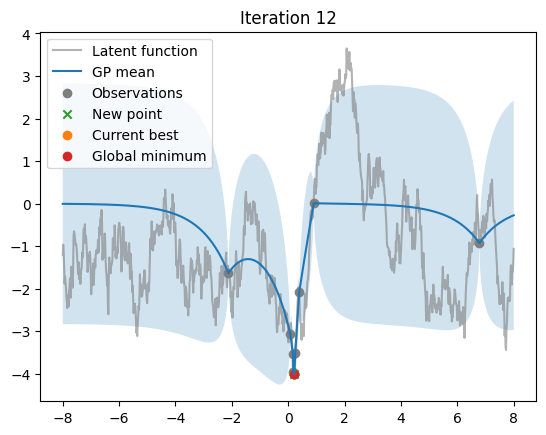

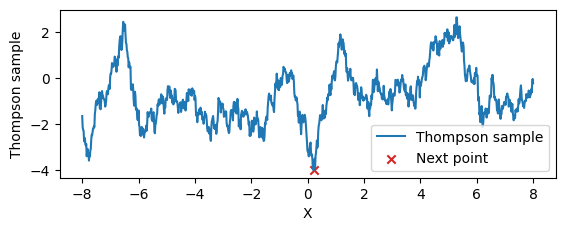

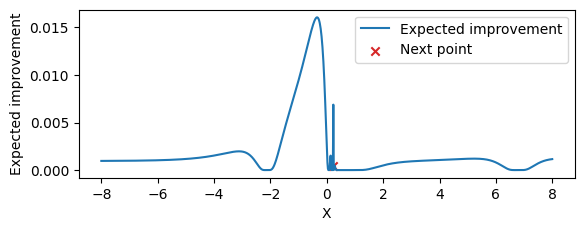

Next point: [0.21621609]

Iteration 13:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.21621609]
New value: [-4.0102654]
Objective: [0.65]


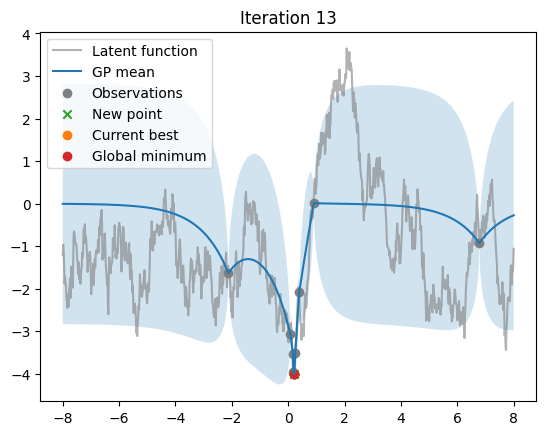

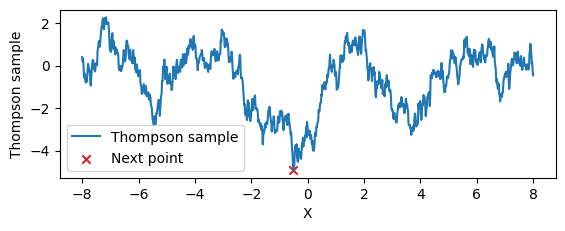

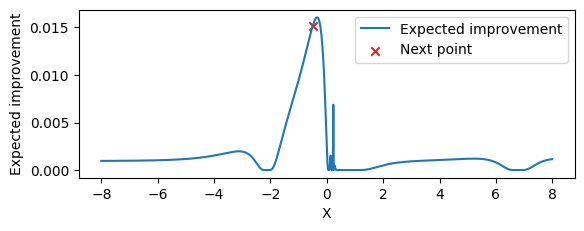

Next point: [-0.50450444]

Iteration 14:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [-0.50450444]
New value: [-1.8974093]
Objective: [0.7]


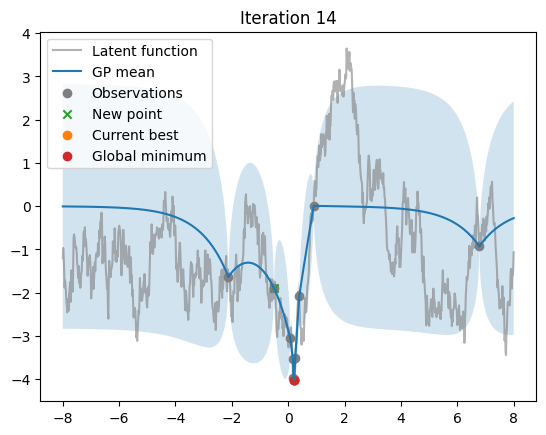

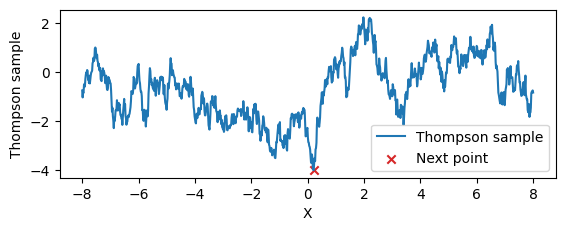

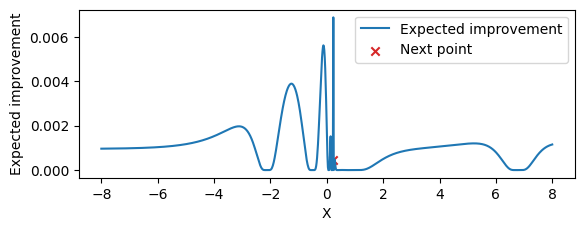

Next point: [0.21621609]

Iteration 15:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.21621609]
New value: [-4.0102654]
Objective: [0.75]


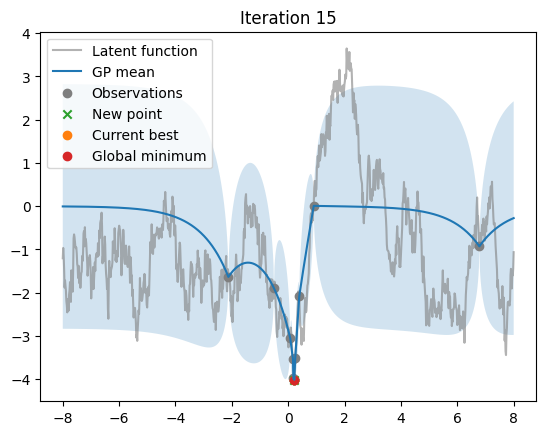

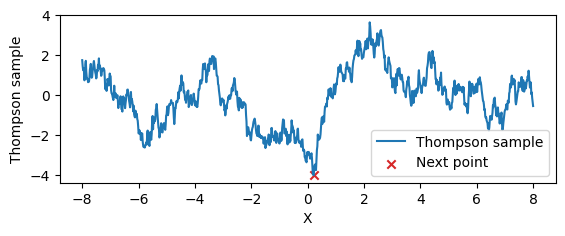

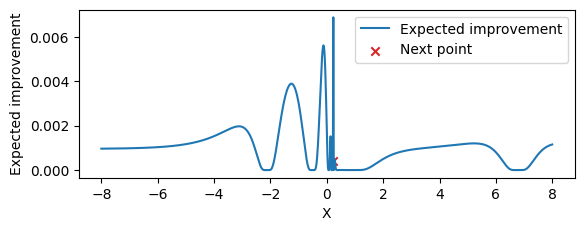

Next point: [0.21621609]

Iteration 16:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.21621609]
New value: [-4.0102654]
Objective: [0.8]


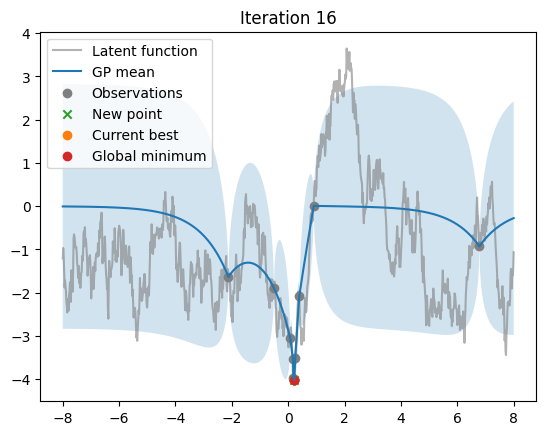

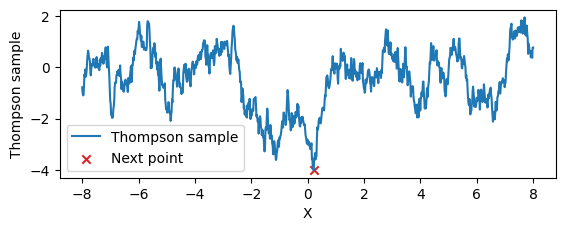

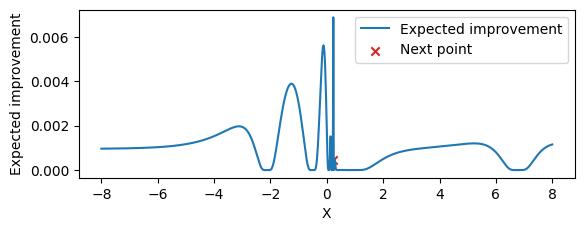

Next point: [0.21621609]

Stopping time: 6
Objective value: 0.3
Best observed value: -4.0102654


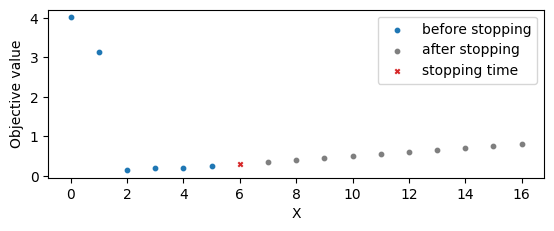

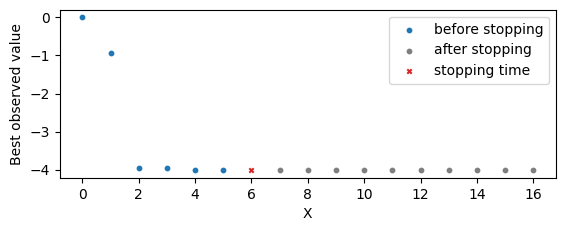

In [58]:
eps = 0.0001
# Specifiy policy and kernel hyperparameters
BayesianOptimization(seed=10, policy='TS+EI', num_points=1000, iterations = 16, query_cost = 0.05, kernel = jk.Matern12(), kernel_parameters={"lengthscale": jnp.array([1.0]), "variance": jnp.array([2.0])})

Global minimum point: [0.21621609]
Global minimum value: -4.010265350341797



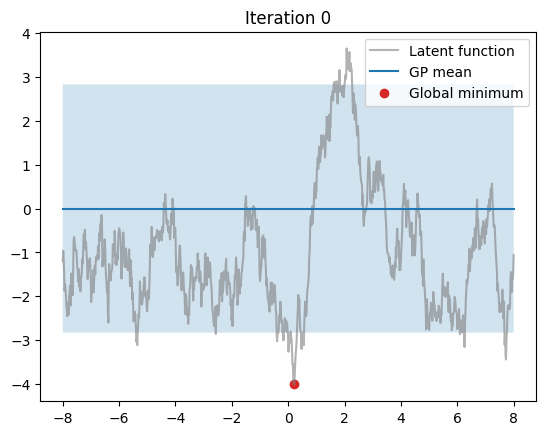

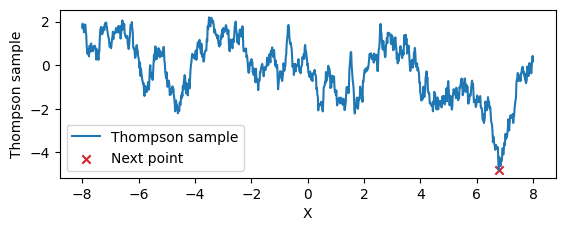

Next point: [6.7827826]

Iteration 1:
Current best value: [-0.92736995]
Current best point: [6.7827826]
New point: [6.7827826]
New value: [-0.92736995]
Objective: [3.1328952]


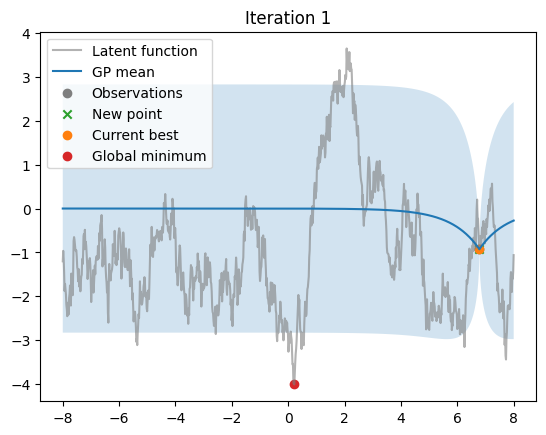

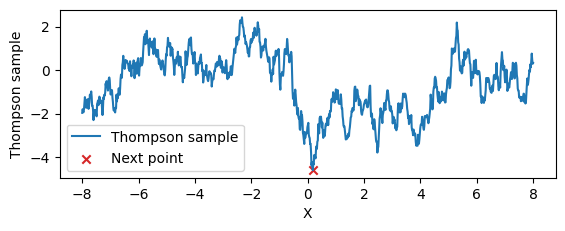

Next point: [0.18418407]

Iteration 2:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [0.18418407]
New value: [-3.9639664]
Objective: [0.14629897]


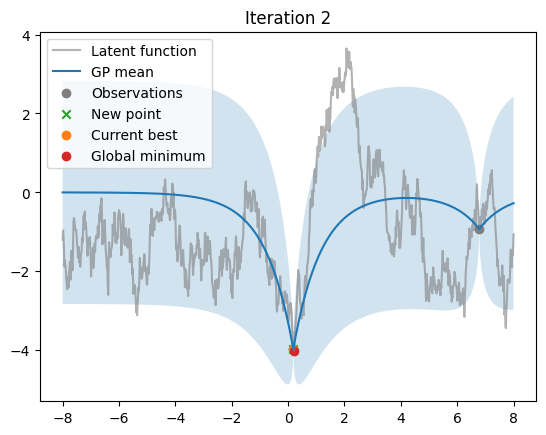

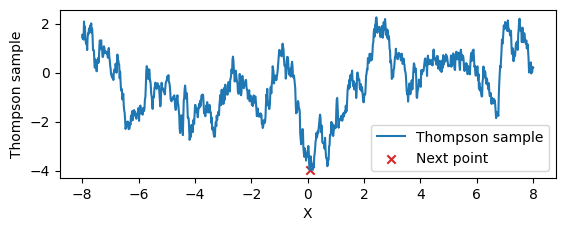

Next point: [0.07207203]

Iteration 3:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [0.07207203]
New value: [-3.0548527]
Objective: [0.19629899]


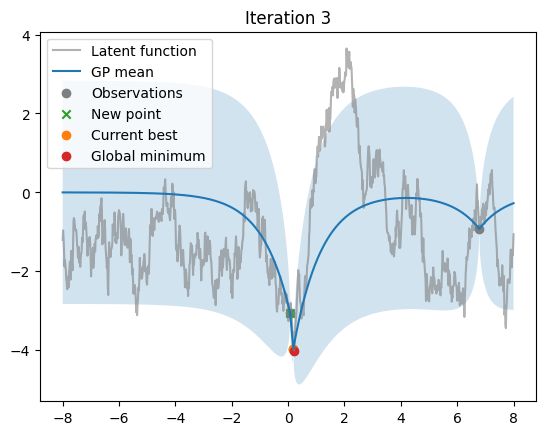

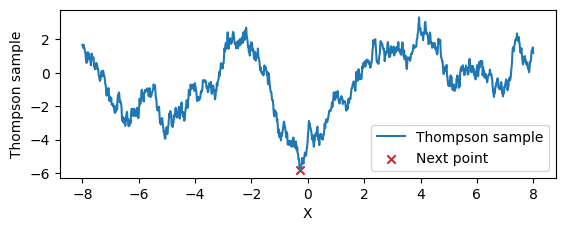

Next point: [-0.28028035]

Iteration 4:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [-0.28028035]
New value: [-2.123526]
Objective: [0.24629898]


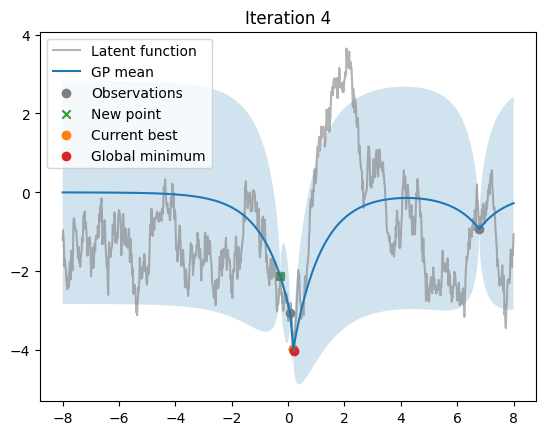

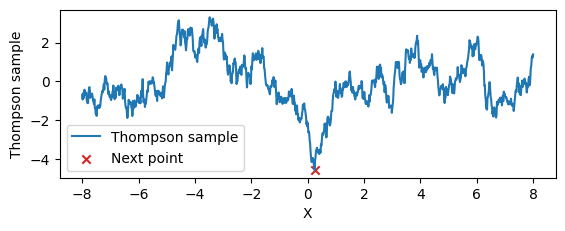

Next point: [0.2482481]

Iteration 5:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [0.2482481]
New value: [-3.5178592]
Objective: [0.29629898]


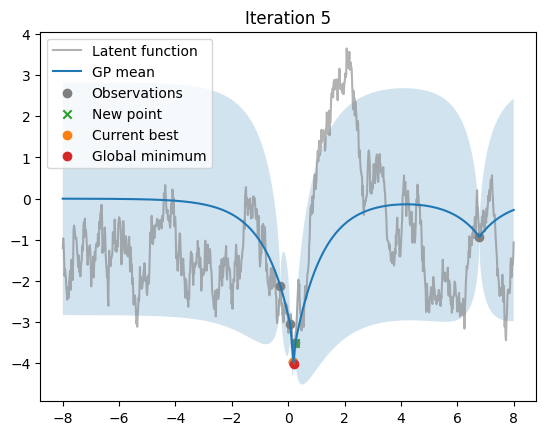

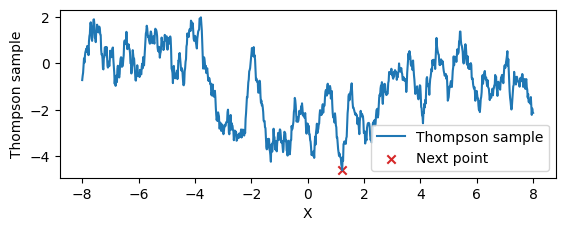

Next point: [1.2252252]

Iteration 6:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [1.2252252]
New value: [1.4423757]
Objective: [0.346299]


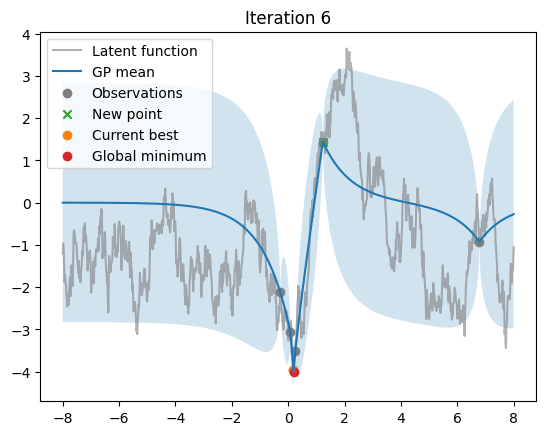

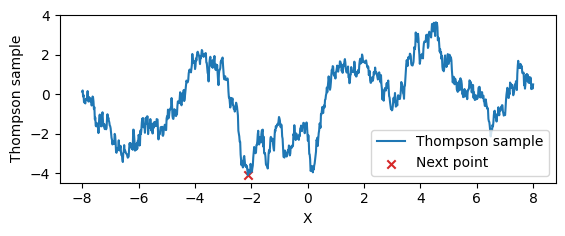

Next point: [-2.122122]

Iteration 7:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [-2.122122]
New value: [-1.6342604]
Objective: [0.39629897]


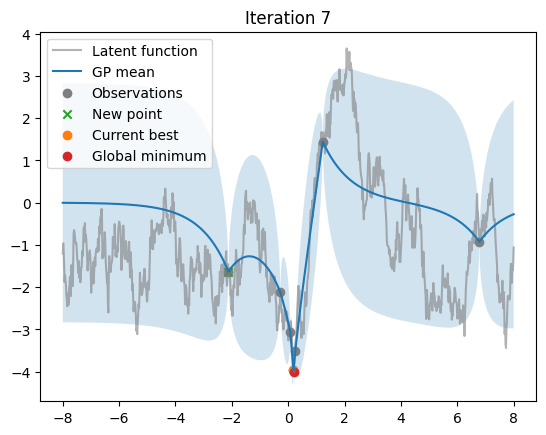

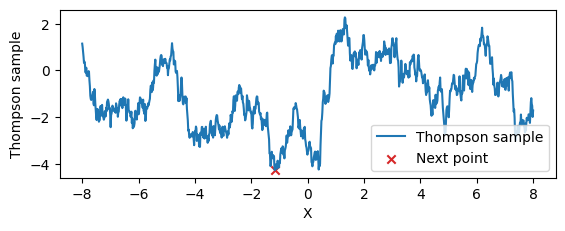

Next point: [-1.1611614]

Iteration 8:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [-1.1611614]
New value: [-0.36051166]
Objective: [0.446299]


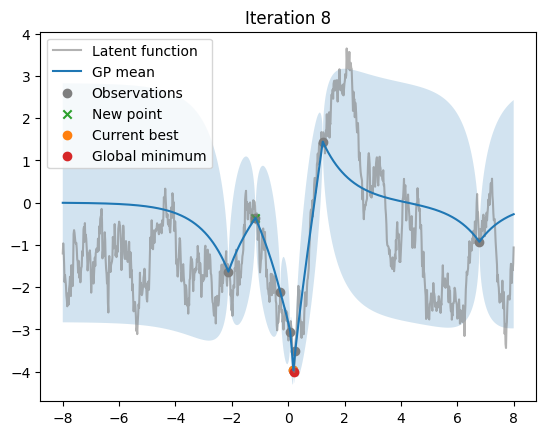

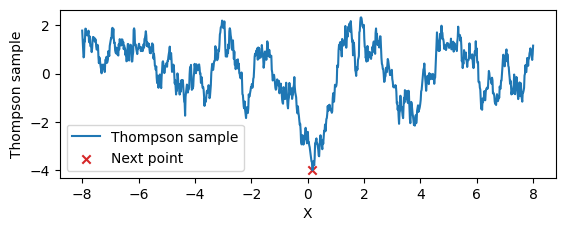

Next point: [0.16816807]

Iteration 9:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [0.16816807]
New value: [-3.5387454]
Objective: [0.49629897]


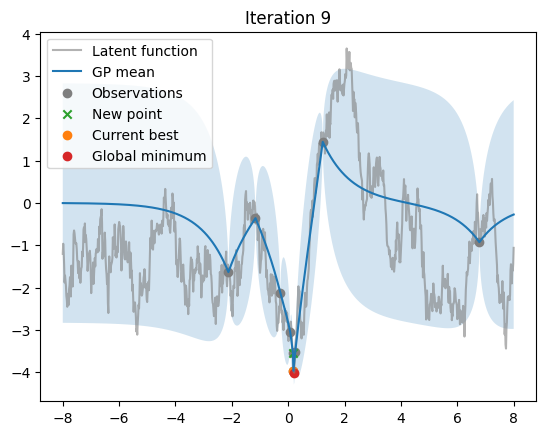

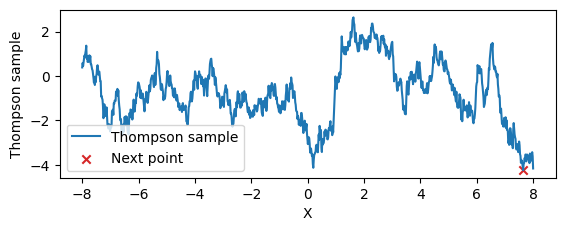

Next point: [7.647648]

Iteration 10:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [7.647648]
New value: [-2.1132317]
Objective: [0.546299]


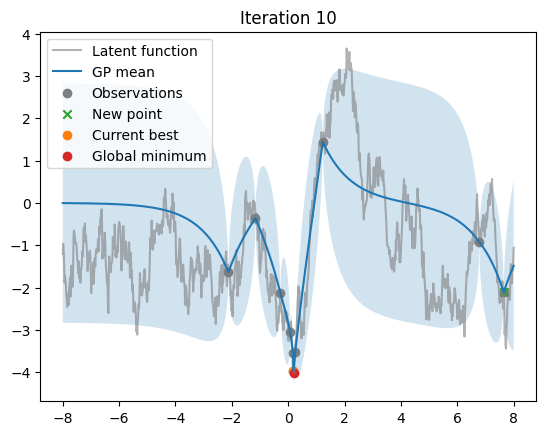

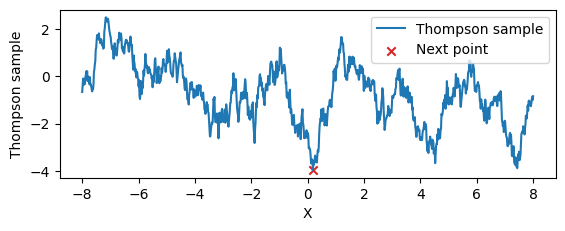

Next point: [0.18418407]

Iteration 11:
Current best value: [-3.9639664]
Current best point: [0.18418407]
New point: [0.18418407]
New value: [-3.9639664]
Objective: [0.596299]


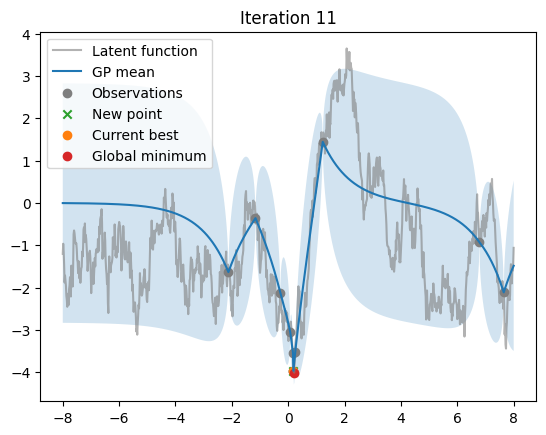

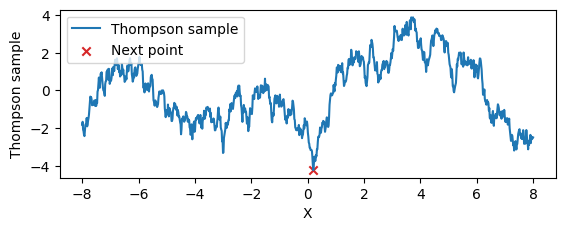

Next point: [0.20020008]

Iteration 12:
Current best value: [-3.9983726]
Current best point: [0.20020008]
New point: [0.20020008]
New value: [-3.9983726]
Objective: [0.6118928]


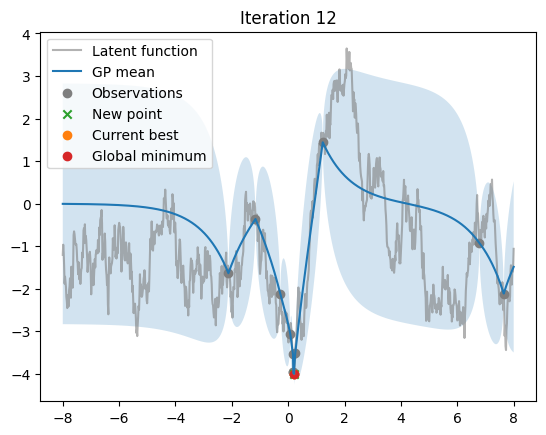

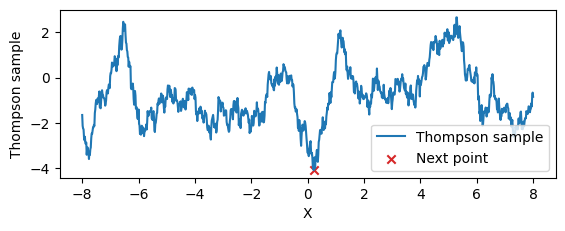

Next point: [0.21621609]

Iteration 13:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.21621609]
New value: [-4.0102654]
Objective: [0.65]


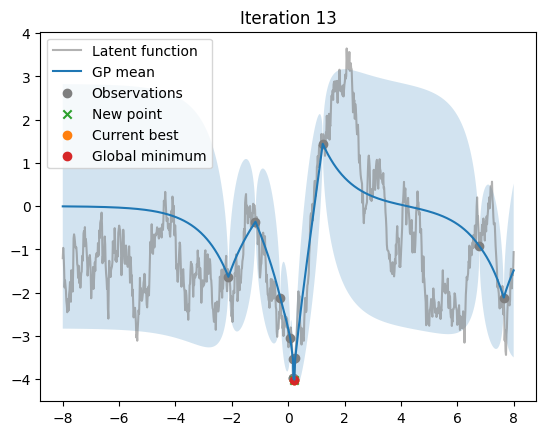

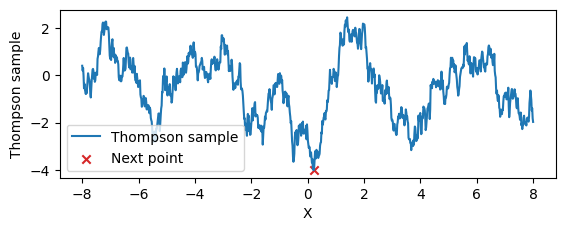

Next point: [0.21621609]

Iteration 14:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.21621609]
New value: [-4.0102654]
Objective: [0.7]


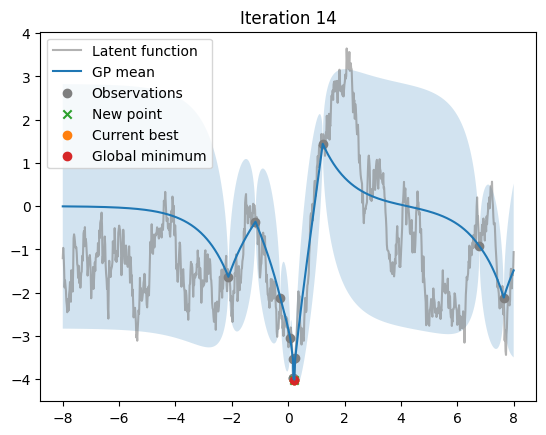

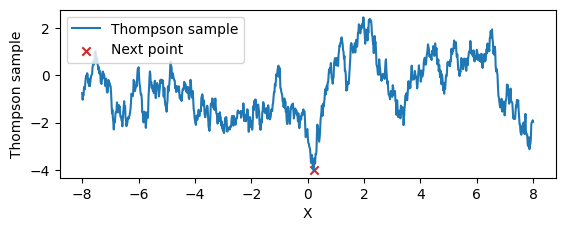

Next point: [0.21621609]

Iteration 15:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.21621609]
New value: [-4.0102654]
Objective: [0.75]


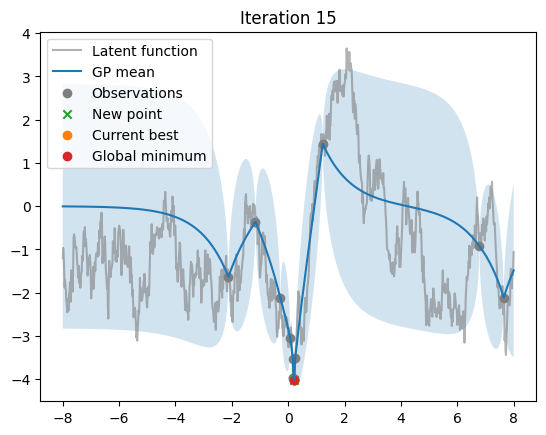

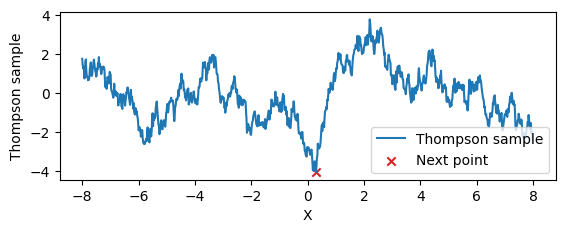

Next point: [0.29629612]

Iteration 16:
Current best value: [-4.0102654]
Current best point: [0.21621609]
New point: [0.29629612]
New value: [-3.030908]
Objective: [0.8]


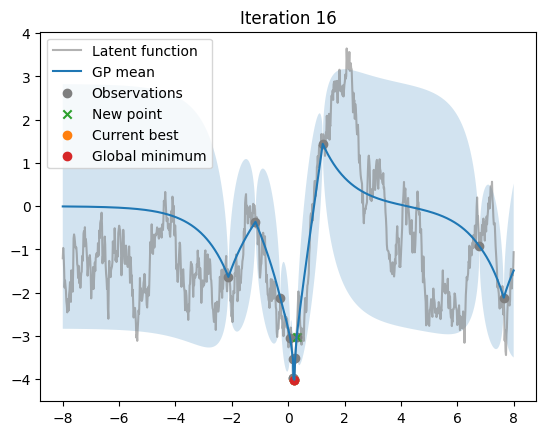

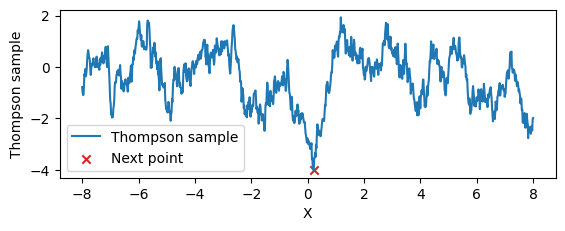

Next point: [0.21621609]

Stopping time: 17
Objective value: 0.8
Best observed value: -4.0102654


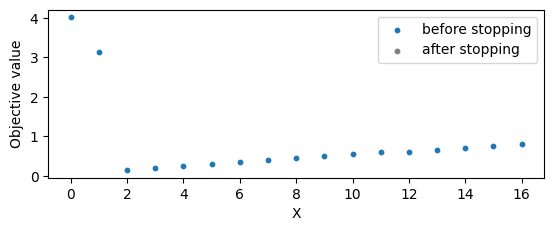

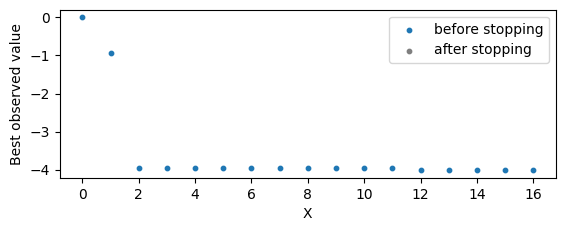

In [110]:
# Specifiy policy and kernel hyperparameters
BayesianOptimization(seed=10, policy='TS', num_points=1000, iterations = 16, query_cost = 0.05, kernel = jk.Matern12(), kernel_parameters={"lengthscale": jnp.array([1.0]), "variance": jnp.array([2.0])})

Global minimum point: [0.21621609]
Global minimum value: -4.010265350341797



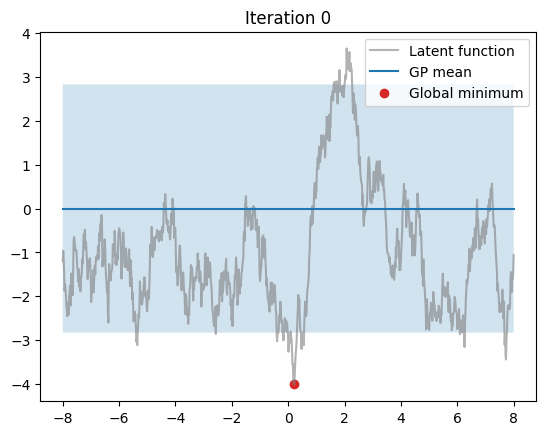

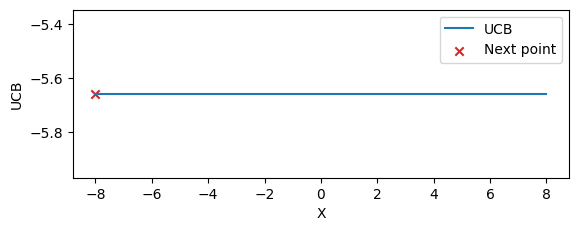

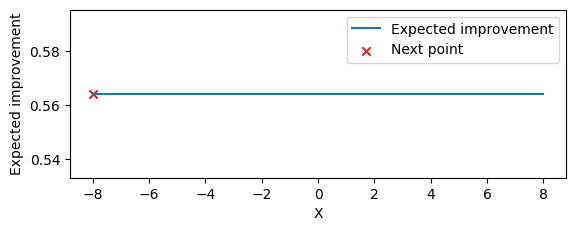

Next point: [-8.]

Iteration 1:
Current best value: [-1.2020764]
Current best point: [-8.]
New point: [-8.]
New value: [-1.2020764]
Objective: [2.8581889]


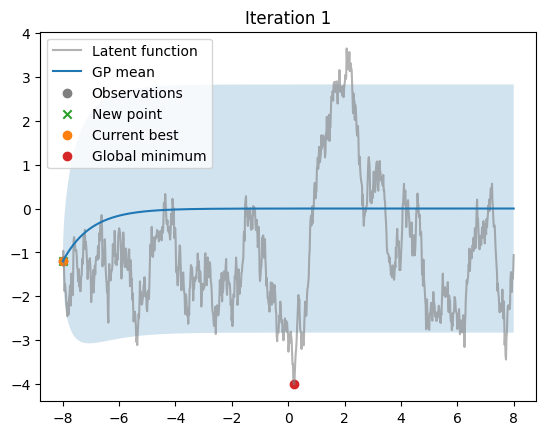

expected improvement: 0.2016324


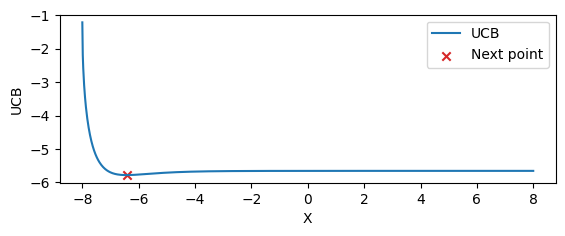

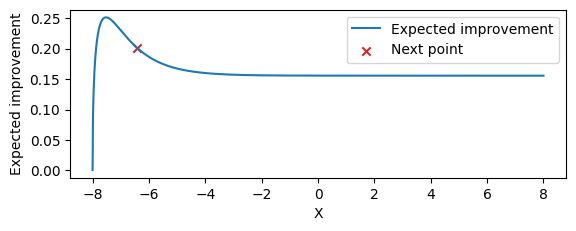

Next point: [-6.4304304]

Iteration 2:
Current best value: [-1.9117907]
Current best point: [-6.4304304]
New point: [-6.4304304]
New value: [-1.9117907]
Objective: [2.1984744]


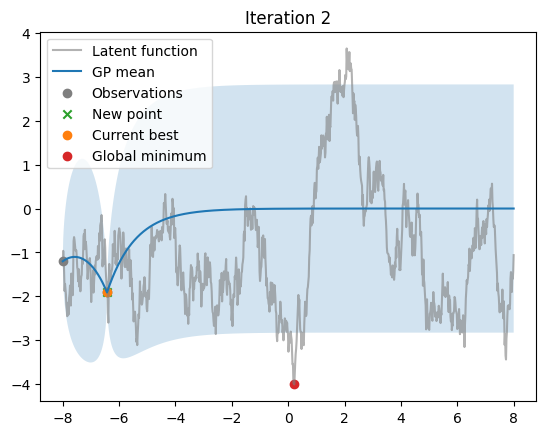

expected improvement: 0.11824058


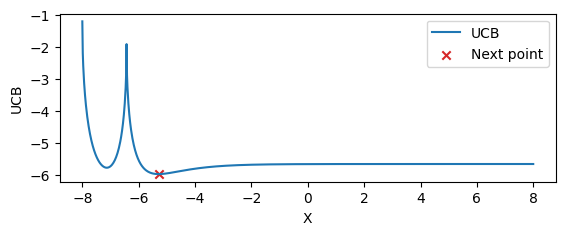

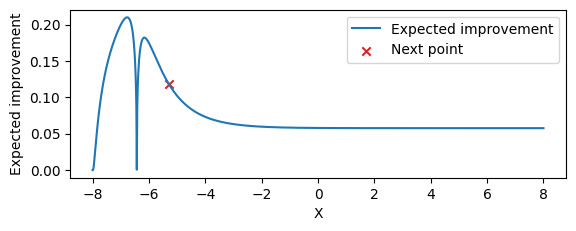

Next point: [-5.293293]

Iteration 3:
Current best value: [-2.4907117]
Current best point: [-5.293293]
New point: [-5.293293]
New value: [-2.4907117]
Objective: [1.6695536]


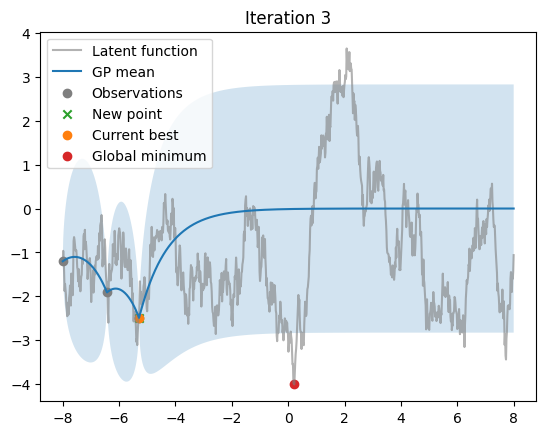

expected improvement: 0.08026248


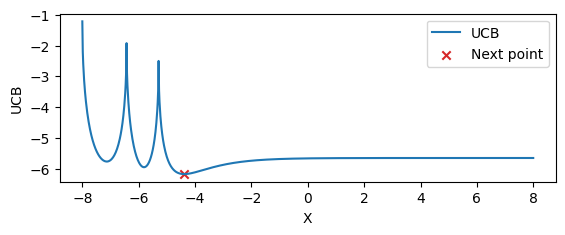

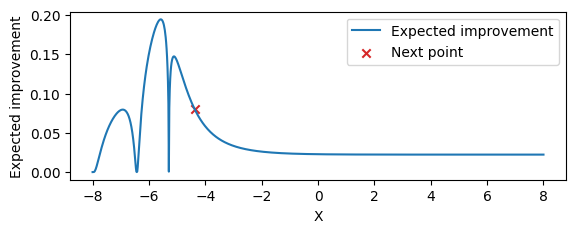

Next point: [-4.3803806]

Iteration 4:
Current best value: [-2.4907117]
Current best point: [-5.293293]
New point: [-4.3803806]
New value: [0.08971591]
Objective: [1.7195537]


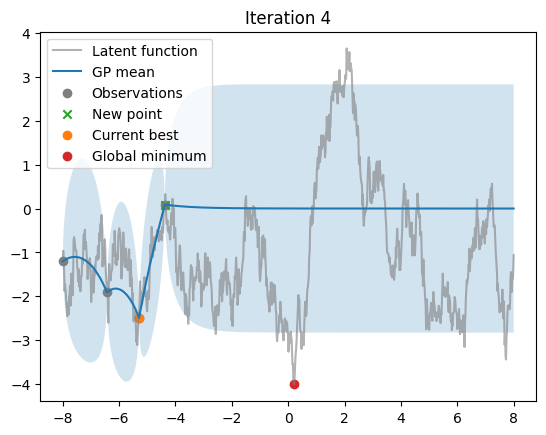

expected improvement: 0.17954719


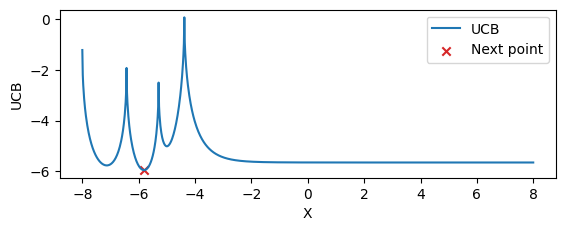

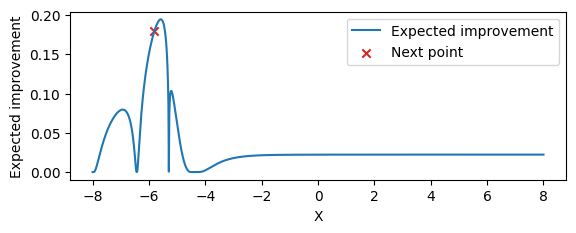

Next point: [-5.805806]

Iteration 5:
Current best value: [-2.4907117]
Current best point: [-5.293293]
New point: [-5.805806]
New value: [-1.3168372]
Objective: [1.7695537]


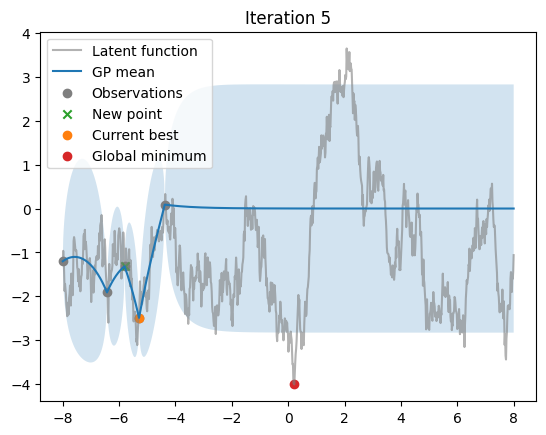

expected improvement: 0.07499567


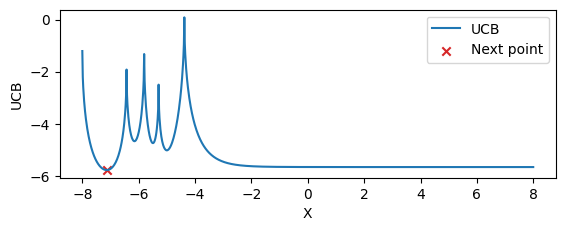

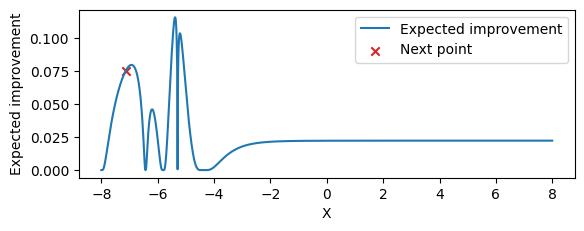

Next point: [-7.1351347]

Iteration 6:
Current best value: [-2.4907117]
Current best point: [-5.293293]
New point: [-7.1351347]
New value: [-1.2692546]
Objective: [1.8195536]


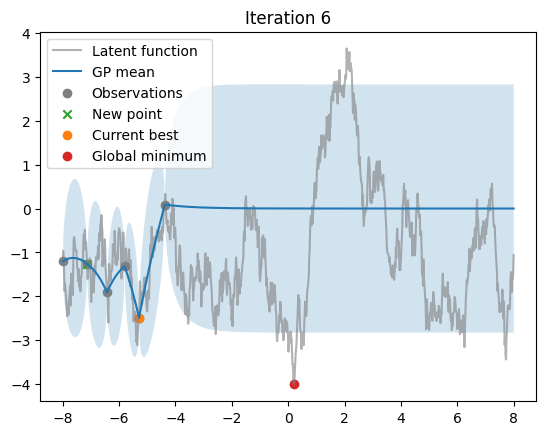

expected improvement: 0.062142745


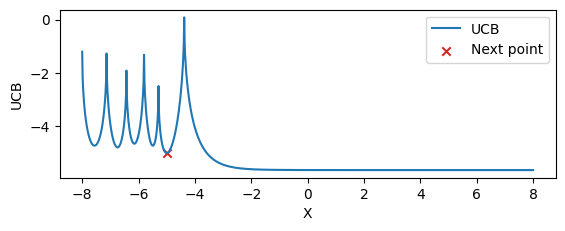

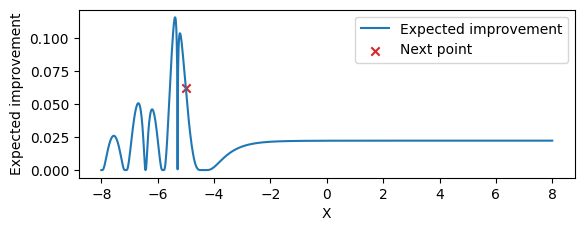

Next point: [-5.005005]

Iteration 7:
Current best value: [-2.4907117]
Current best point: [-5.293293]
New point: [-5.005005]
New value: [-2.34145]
Objective: [1.8695537]


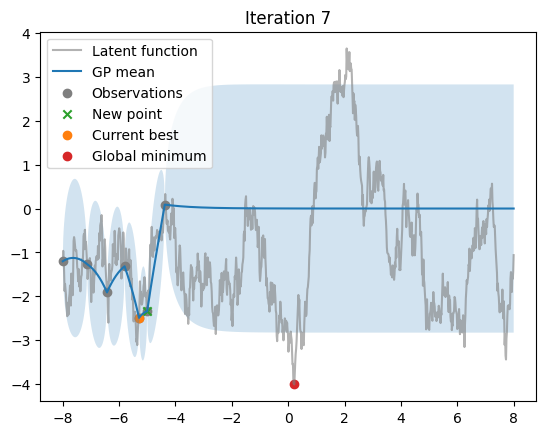

expected improvement: 0.05040247


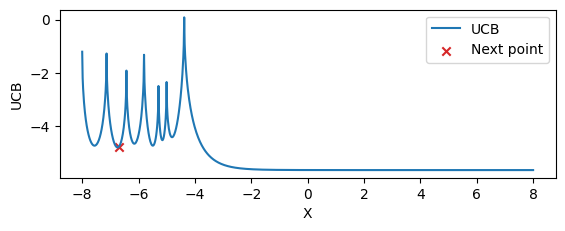

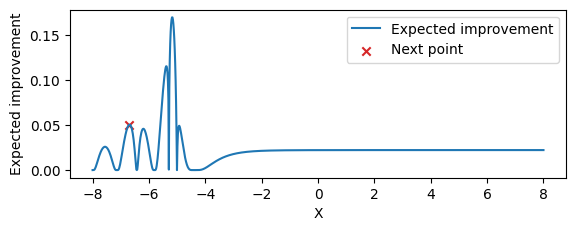

Next point: [-6.7027025]

Iteration 8:
Current best value: [-2.4907117]
Current best point: [-5.293293]
New point: [-6.7027025]
New value: [-0.558581]
Objective: [1.9195536]


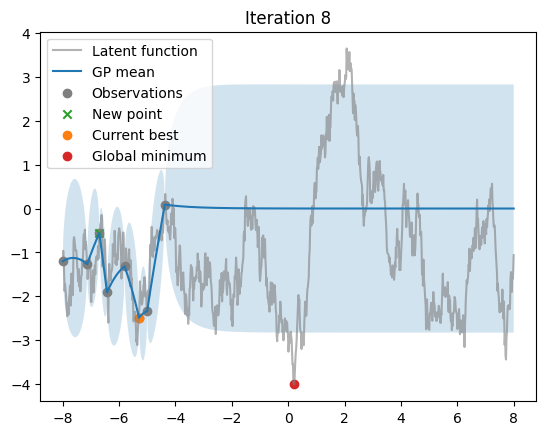

expected improvement: 0.087974295


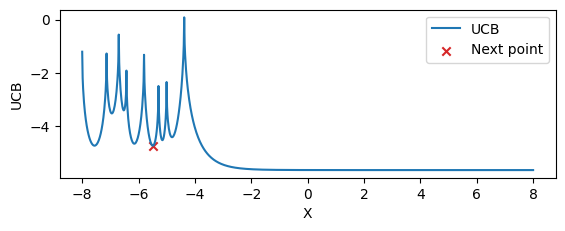

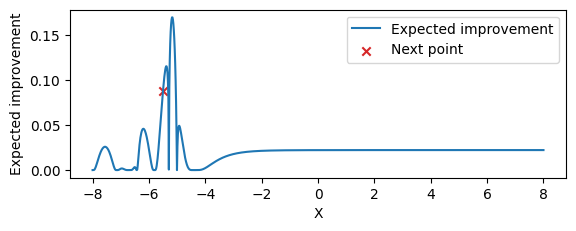

Next point: [-5.501501]

Iteration 9:
Current best value: [-2.4907117]
Current best point: [-5.293293]
New point: [-5.501501]
New value: [-2.2577934]
Objective: [1.9695537]


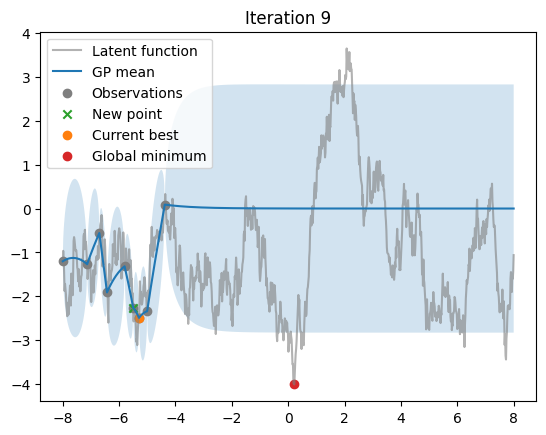

expected improvement: 0.16738887


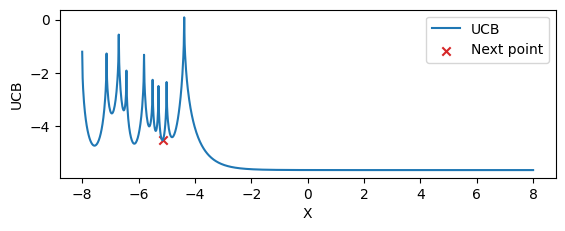

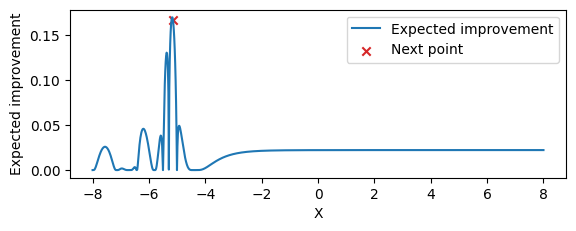

Next point: [-5.149149]

Iteration 10:
Current best value: [-2.4907117]
Current best point: [-5.293293]
New point: [-5.149149]
New value: [-1.9686005]
Objective: [2.0195537]


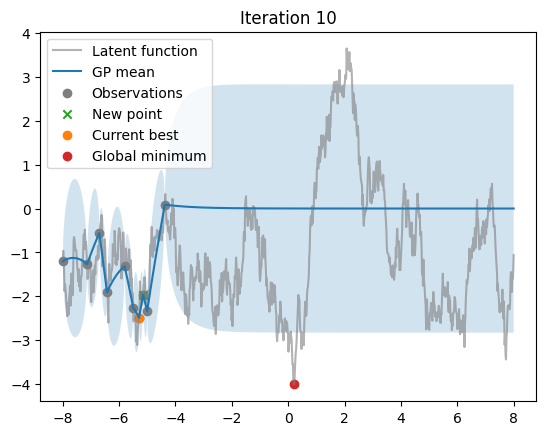

expected improvement: 0.12736262


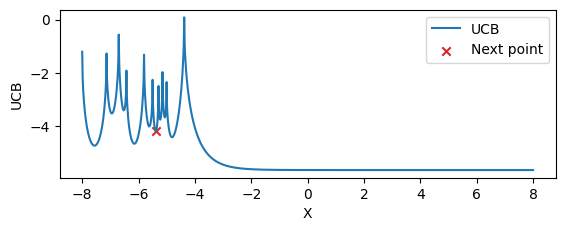

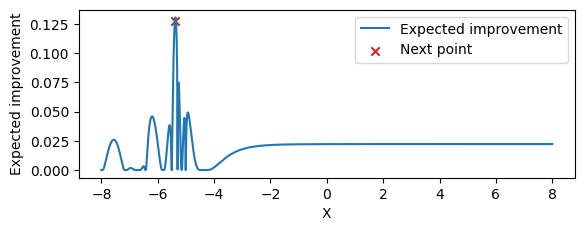

Next point: [-5.389389]

Iteration 11:
Current best value: [-3.0387664]
Current best point: [-5.389389]
New point: [-5.389389]
New value: [-3.0387664]
Objective: [1.5214989]


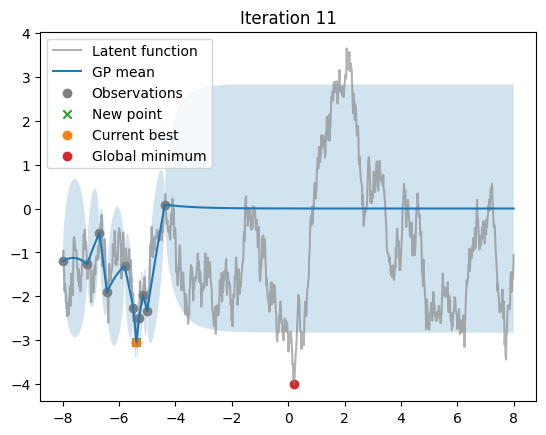

expected improvement: 0.05297516


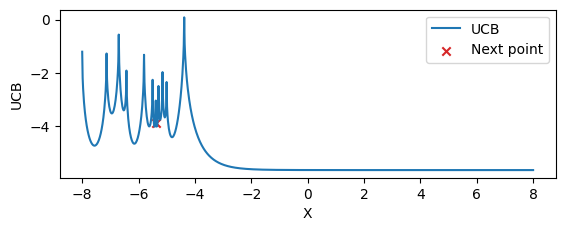

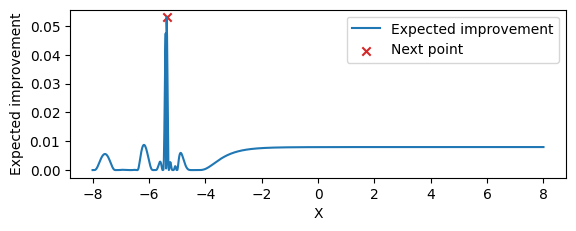

Next point: [-5.373373]

Iteration 12:
Current best value: [-3.0387664]
Current best point: [-5.389389]
New point: [-5.373373]
New value: [-2.9682014]
Objective: [1.571499]


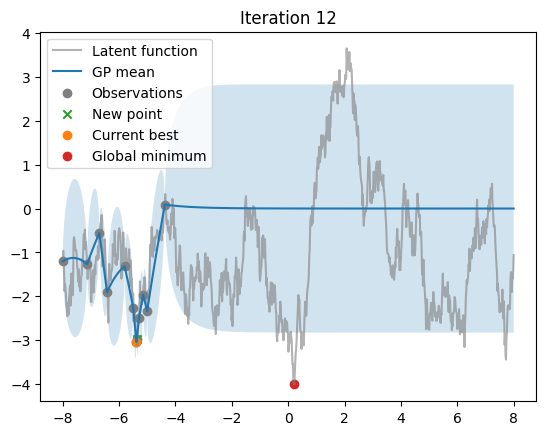

Objective value at stopping time: [1.571499]
expected improvement: 0.007987764


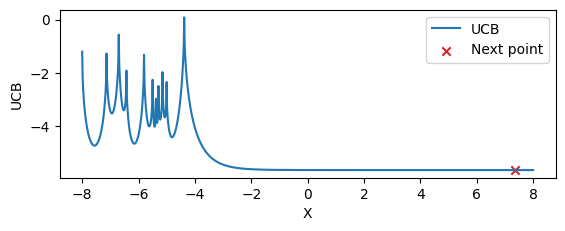

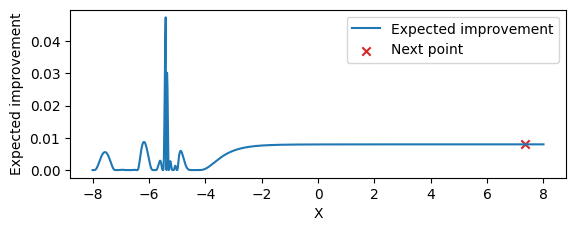

Next point: [7.359359]

Iteration 13:
Current best value: [-3.0387664]
Current best point: [-5.389389]
New point: [7.359359]
New value: [-0.9256835]
Objective: [1.621499]


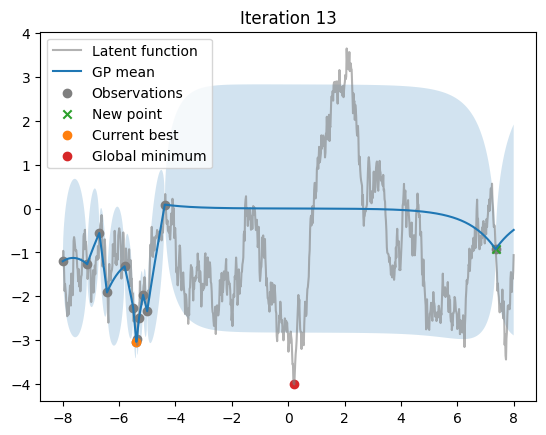

Objective value at stopping time: [1.621499]
expected improvement: 0.009795405


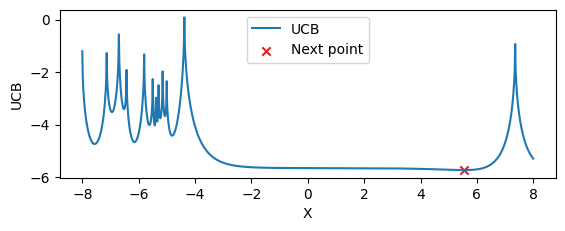

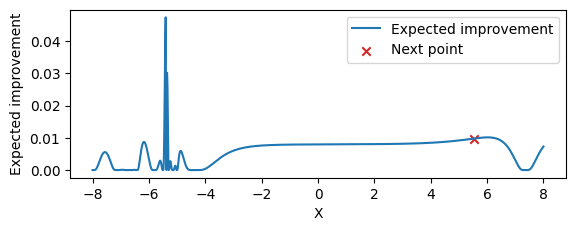

Next point: [5.533533]

Iteration 14:
Current best value: [-3.0387664]
Current best point: [-5.389389]
New point: [5.533533]
New value: [-1.9337535]
Objective: [1.671499]


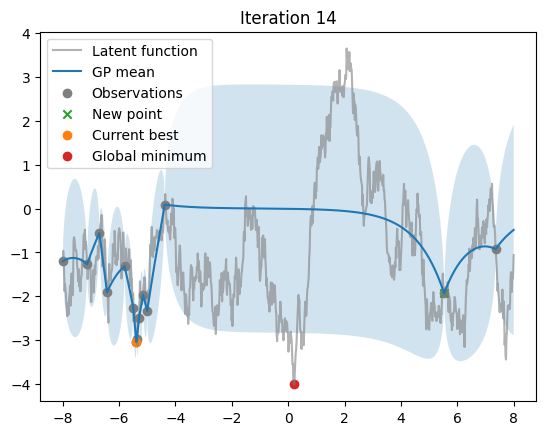

Objective value at stopping time: [1.671499]
expected improvement: 0.019016601


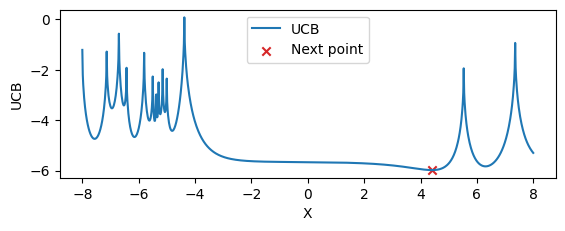

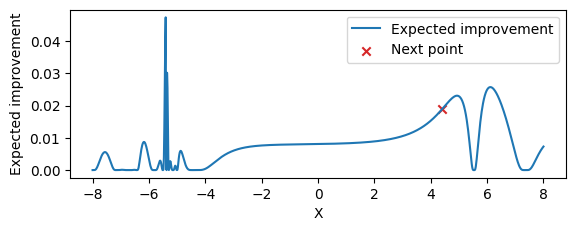

Next point: [4.4124126]

Iteration 15:
Current best value: [-3.0387664]
Current best point: [-5.389389]
New point: [4.4124126]
New value: [-1.0729718]
Objective: [1.721499]


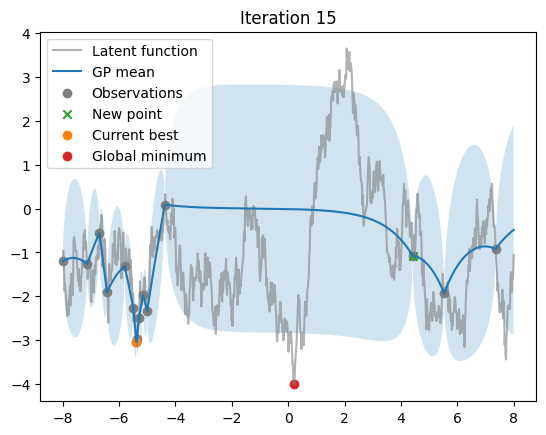

Objective value at stopping time: [1.721499]
expected improvement: 0.024278104


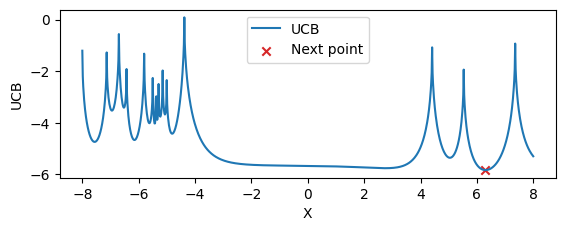

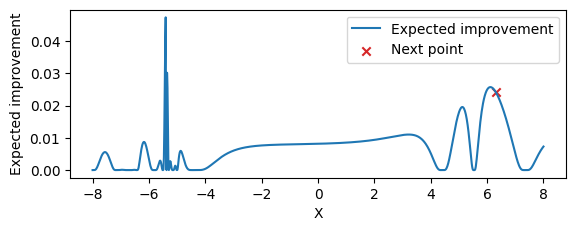

Next point: [6.3023024]

Iteration 16:
Current best value: [-3.0387664]
Current best point: [-5.389389]
New point: [6.3023024]
New value: [-2.0497417]
Objective: [1.7714989]


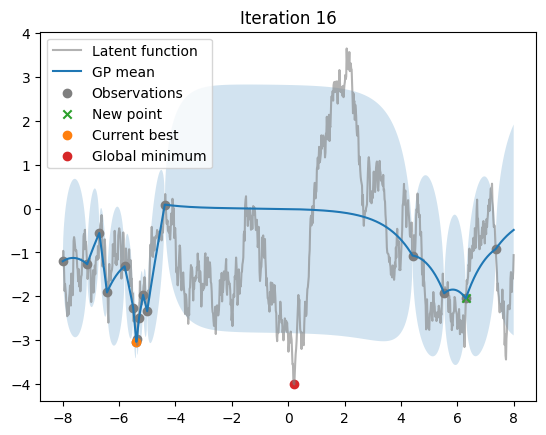

Objective value at stopping time: [1.7714989]
expected improvement: 0.010497633


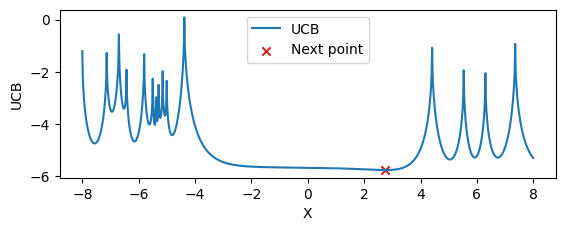

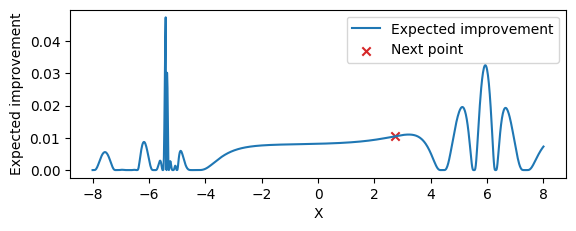

Next point: [2.7307308]

Stopping time: 12
Objective value: 1.571499
Best observed value: -3.0387664


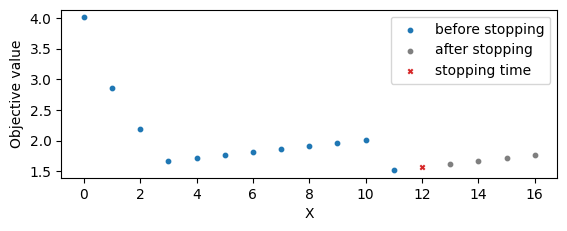

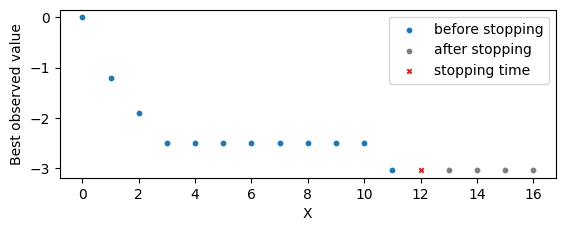

In [60]:
eps = 0.0001
# Specifiy policy and kernel hyperparameters
BayesianOptimization(seed=10, policy='UCB', num_points=1000, iterations = 16, query_cost = 0.05, kernel = jk.Matern12(), kernel_parameters={"lengthscale": jnp.array([1.0]), "variance": jnp.array([2.0])})

Global minimum point: [0.21621609]
Global minimum value: -4.010265350341797



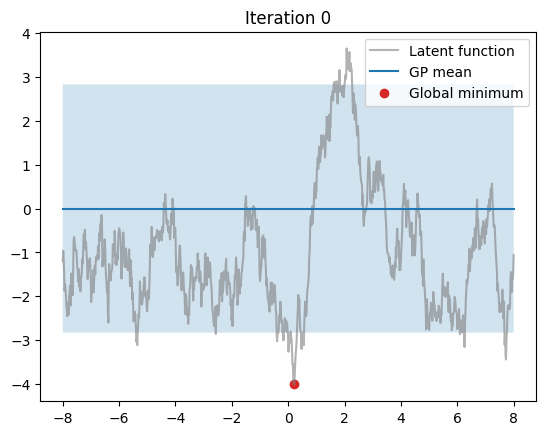

Next point: [-8.]

Iteration 1:
Current best value: [-1.2020764]
Current best point: [-8.]
New point: [-8.]
New value: [-1.2020764]
Objective: [2.8581889]


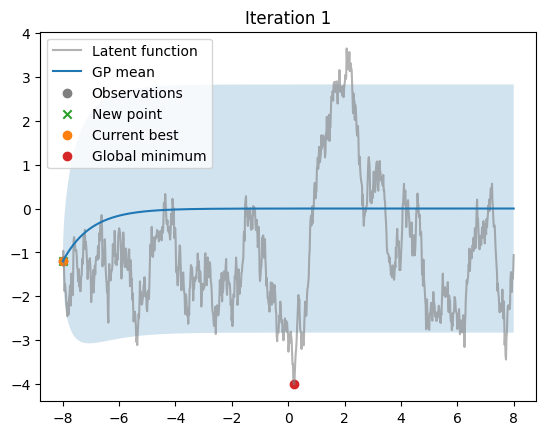

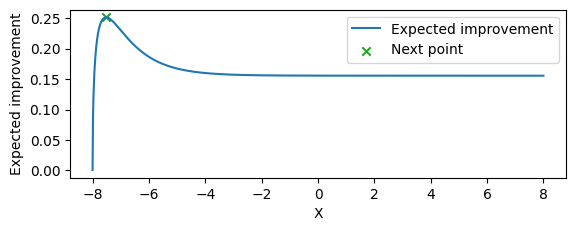

Next point: [-7.51952]

Iteration 2:
Current best value: [-1.2020764]
Current best point: [-8.]
New point: [-7.51952]
New value: [-0.95216393]
Objective: [2.9081888]


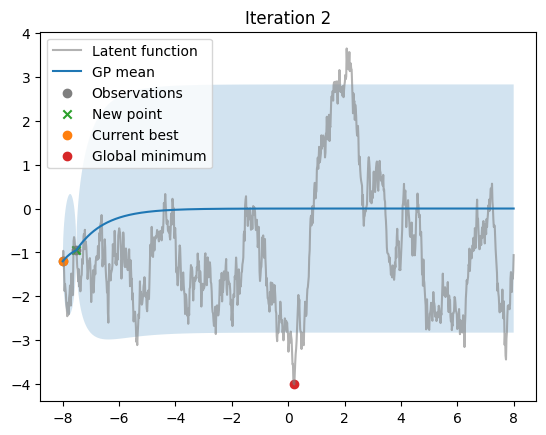

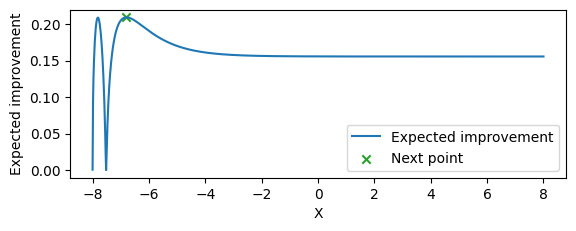

Next point: [-6.7987986]

Iteration 3:
Current best value: [-1.2020764]
Current best point: [-8.]
New point: [-6.7987986]
New value: [-1.0870491]
Objective: [2.958189]


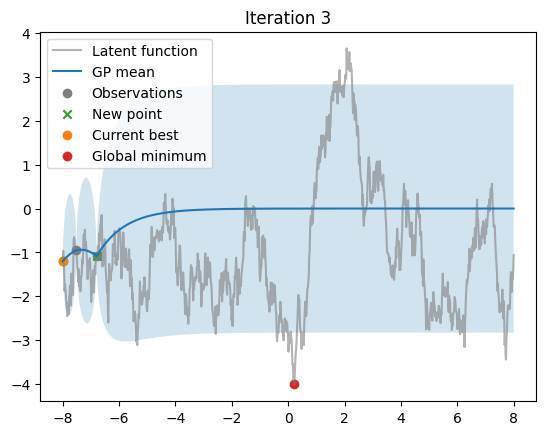

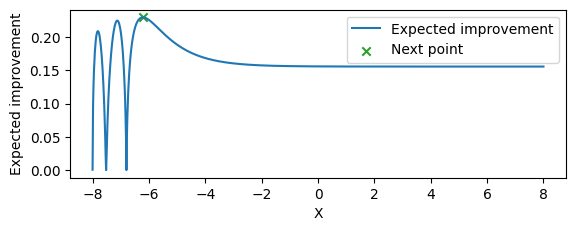

Next point: [-6.2062063]

Iteration 4:
Current best value: [-1.2020764]
Current best point: [-8.]
New point: [-6.2062063]
New value: [-1.024158]
Objective: [3.008189]


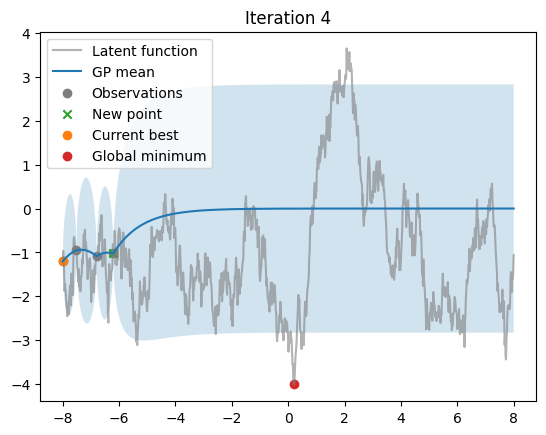

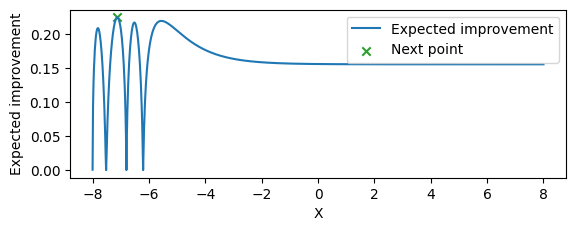

Next point: [-7.1191187]

Iteration 5:
Current best value: [-1.6061239]
Current best point: [-7.1191187]
New point: [-7.1191187]
New value: [-1.6061239]
Objective: [2.6541414]


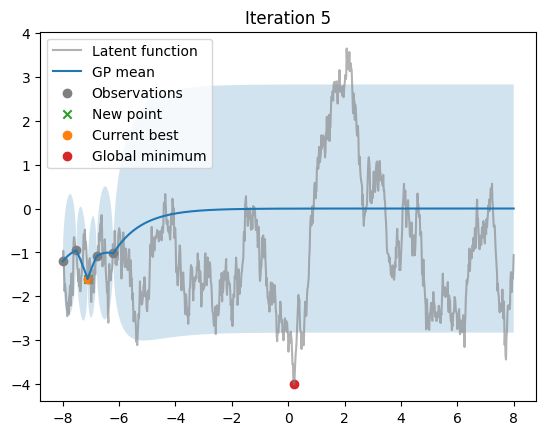

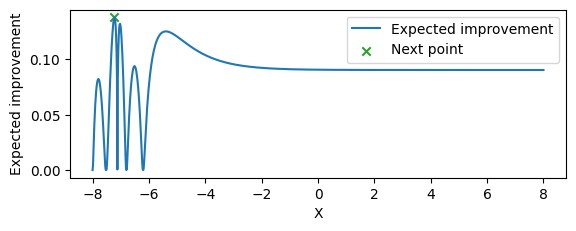

Next point: [-7.2312317]

Iteration 6:
Current best value: [-1.6061239]
Current best point: [-7.1191187]
New point: [-7.2312317]
New value: [-0.92712593]
Objective: [2.7041414]


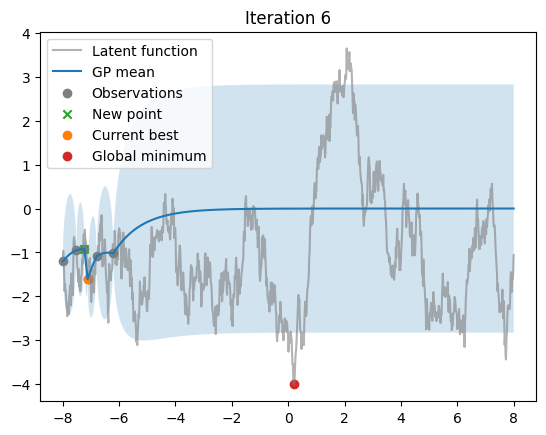

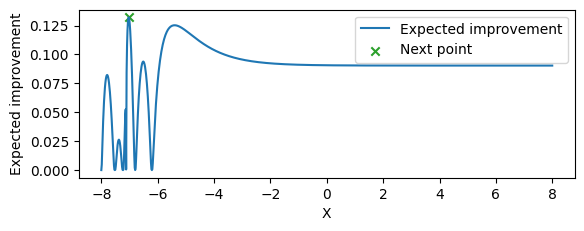

Next point: [-7.0230227]

Iteration 7:
Current best value: [-1.6061239]
Current best point: [-7.1191187]
New point: [-7.0230227]
New value: [-1.2795165]
Objective: [2.7541413]


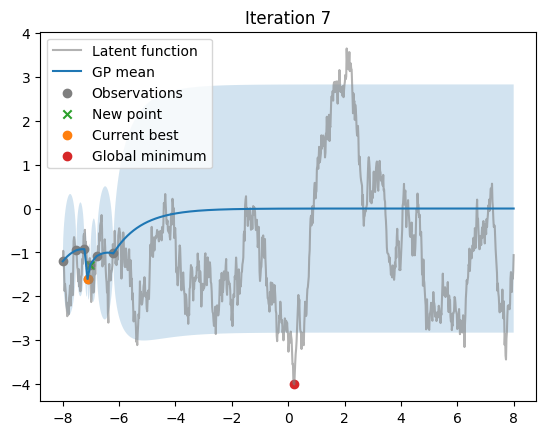

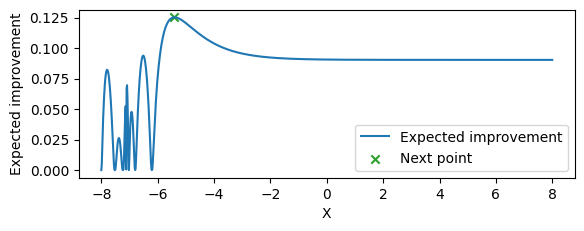

Next point: [-5.405405]

Iteration 8:
Current best value: [-2.6891804]
Current best point: [-5.405405]
New point: [-5.405405]
New value: [-2.6891804]
Objective: [1.721085]


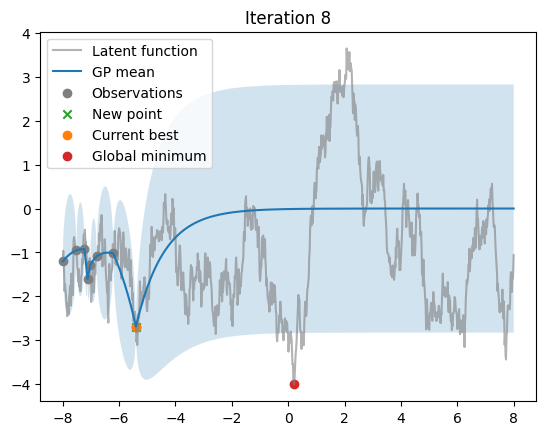

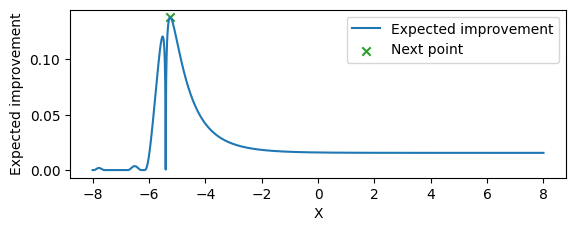

Next point: [-5.245245]

Iteration 9:
Current best value: [-2.6891804]
Current best point: [-5.405405]
New point: [-5.245245]
New value: [-2.1544228]
Objective: [1.771085]


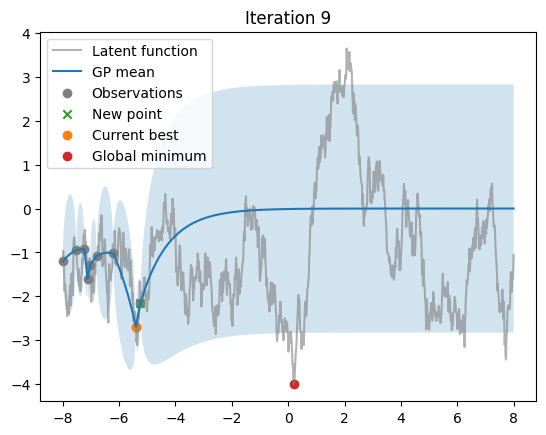

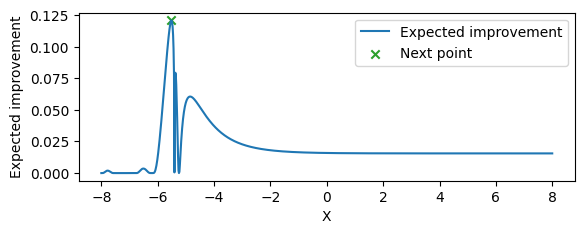

Next point: [-5.517517]

Iteration 10:
Current best value: [-2.6891804]
Current best point: [-5.405405]
New point: [-5.517517]
New value: [-1.9304591]
Objective: [1.821085]


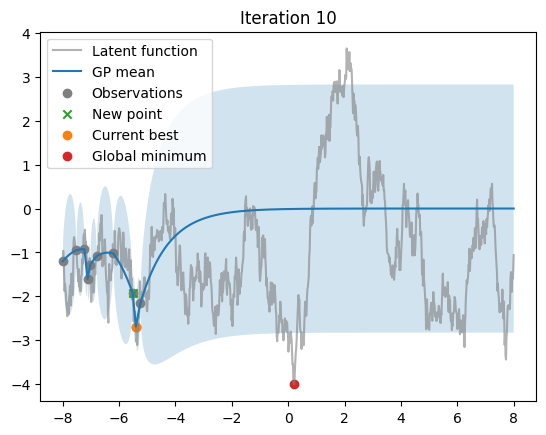

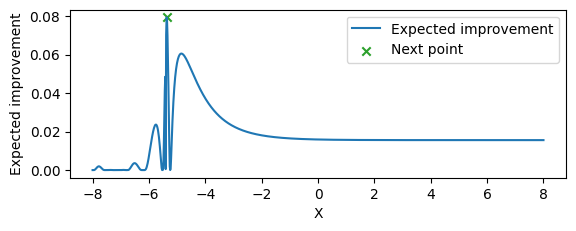

Next point: [-5.373373]

Iteration 11:
Current best value: [-2.9682014]
Current best point: [-5.373373]
New point: [-5.373373]
New value: [-2.9682014]
Objective: [1.5920639]


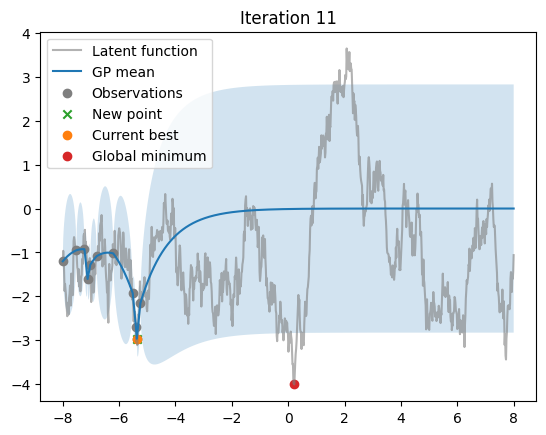

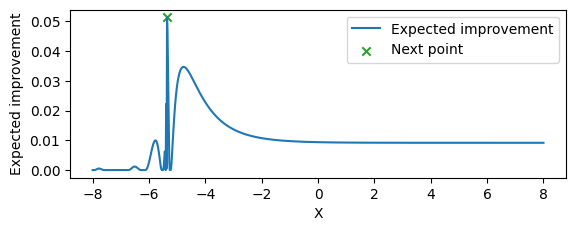

Next point: [-5.357357]

Iteration 12:
Current best value: [-3.1122777]
Current best point: [-5.357357]
New point: [-5.357357]
New value: [-3.1122777]
Objective: [1.4979876]


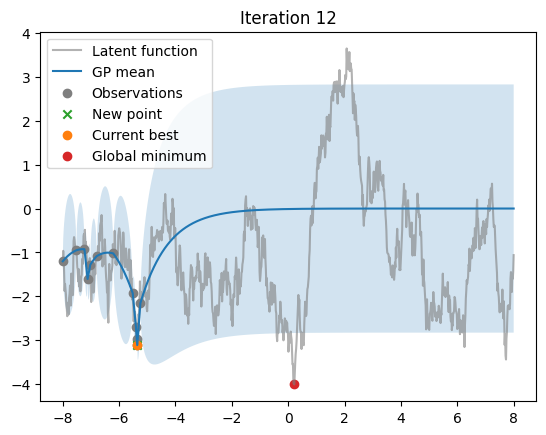

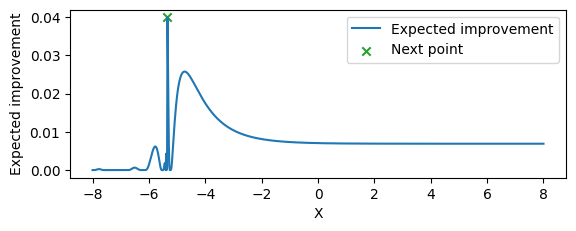

Next point: [-5.341341]

Iteration 13:
Current best value: [-3.1122777]
Current best point: [-5.357357]
New point: [-5.341341]
New value: [-2.8385353]
Objective: [1.5479876]


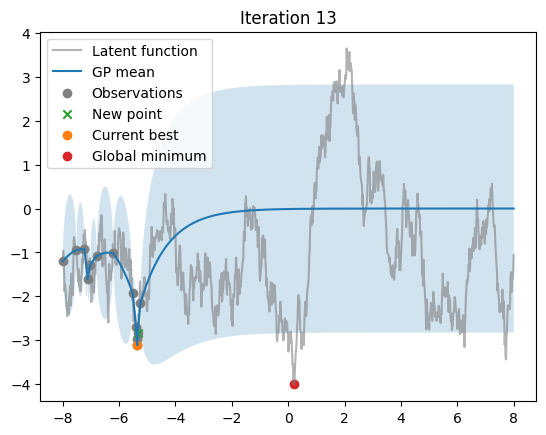

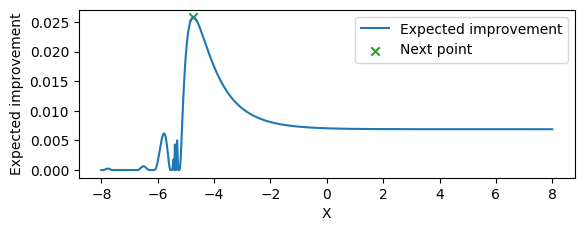

Next point: [-4.732733]

Iteration 14:
Current best value: [-3.1122777]
Current best point: [-5.357357]
New point: [-4.732733]
New value: [-0.7202536]
Objective: [1.5979877]


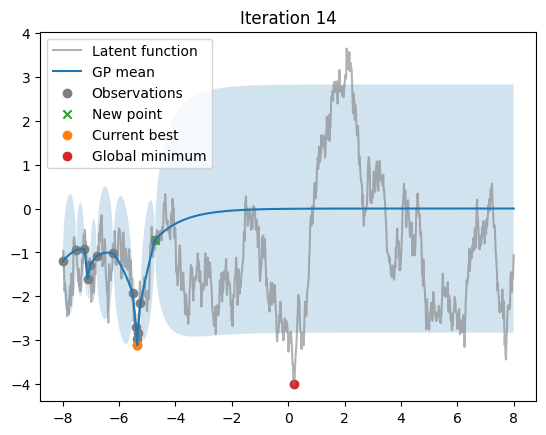

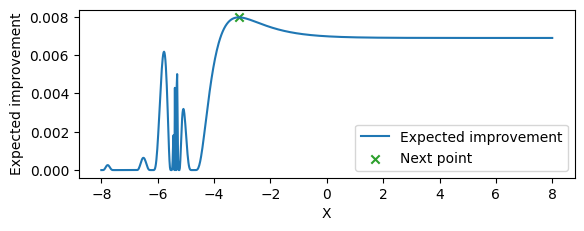

Next point: [-3.1151152]

Iteration 15:
Current best value: [-3.1122777]
Current best point: [-5.357357]
New point: [-3.1151152]
New value: [-1.443181]
Objective: [1.6479876]


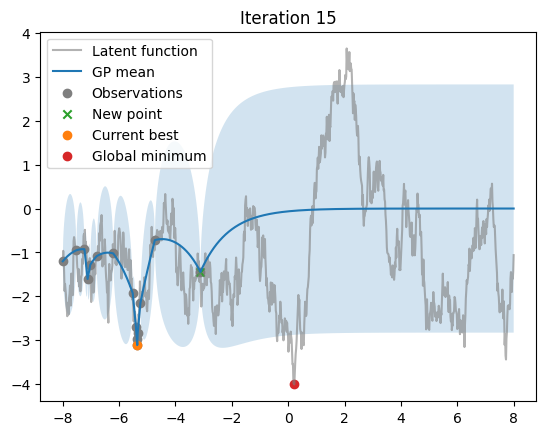

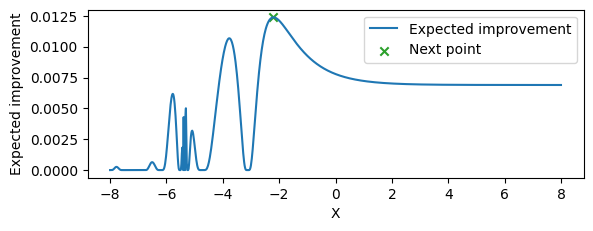

Next point: [-2.202202]

Iteration 16:
Current best value: [-3.1122777]
Current best point: [-5.357357]
New point: [-2.202202]
New value: [-1.1501775]
Objective: [1.6979876]


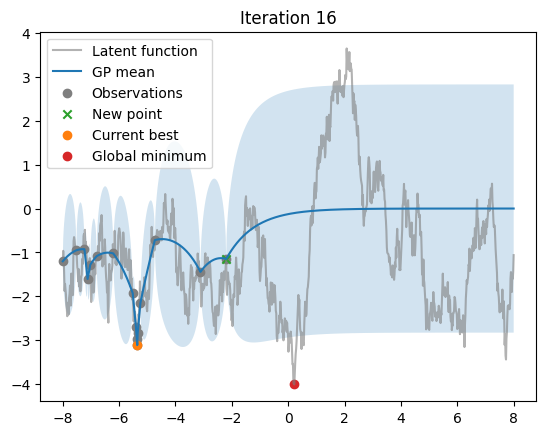

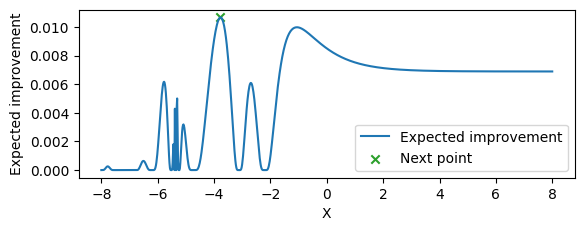

Next point: [-3.7717717]

Stopping time: 12
Objective value: 1.4979876
Best observed value: -3.1122777


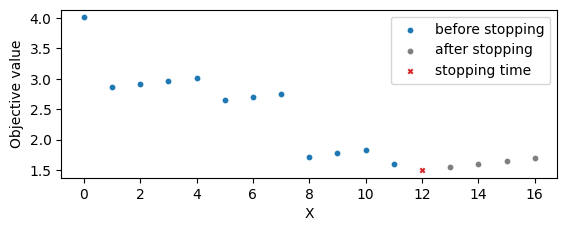

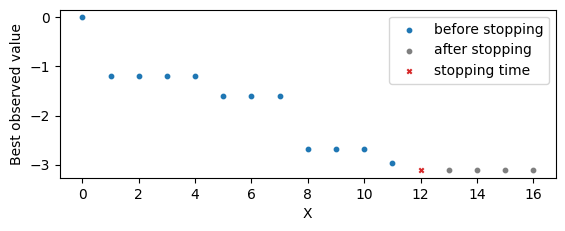

In [48]:
eps = 0.0001
# Specifiy policy and kernel hyperparameters
BayesianOptimization(seed=10, policy='EI', num_points=1000, iterations = 16, query_cost = 0.05, kernel = jk.Matern12(), kernel_parameters={"lengthscale": jnp.array([1.0]), "variance": jnp.array([2.0])})